## FIFA Kaggle Competition: Prediction Futbol Positions

Guillem, Andrew, Luke

Model predicts atk,def,mid 

then within each category predicts the position without the side of the field i.e. wing, back, midfielder

then predicts the side of the field L,R,C for each position

1. **Data Preprocessing and Quality Assurance:** Yes

2. **Feature Creation and Engineering:** Yes

3. **Exploratory Data Analysis (EDA):** Yes

4. **Cross-Validation Strategy:** Used within RandomSearchCV and TPOT

5. **Model Selection and Justification:** XGBoost and TPOT(RandomForest)

6. **Ensemble Modeling (Bonus Objective):** Yes

7. **Performance Evaluation:** F1 scoring in TPOT and RandomSearch CVs

In [4]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn import preprocessing
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import roc_auc_score, classification_report, confusion_matrix
import xgboost as xgb
from sklearn.preprocessing import OneHotEncoder, MinMaxScaler
from sklearn.model_selection import GridSearchCV
from datetime import datetime
from sklearn.impute import KNNImputer
from sklearn.model_selection import RandomizedSearchCV
from scipy.stats import randint
from sklearn.preprocessing import OneHotEncoder
from sklearn.model_selection import train_test_split
from sklearn.ensemble import IsolationForest
from imblearn.over_sampling import SMOTE
from sklearn.preprocessing import StandardScaler
from tpot import TPOTClassifier
from sklearn.metrics import make_scorer, f1_score
import warnings

# Ignore future warnings
warnings.simplefilter(action='ignore', category=FutureWarning)


In [5]:
# Define the TPOT configuration with hyperparameter search space
tpot_config = {
    'tpot': {
        'generations': 20,
        'population_size': 10,
        'random_state': 42,
        'config_dict': {
            'sklearn.ensemble.RandomForestClassifier': {
                'n_estimators': [100, 200, 300, 400, 500],
                'max_depth': [1, 5, 10, 15, 20],
                'min_samples_split': [2, 5, 10],
                'min_samples_leaf': [1, 2, 4]
            }
        }
    }
}

f1_scorer = make_scorer(f1_score, average='weighted')

# Create and fit the TPOTClassifier
tpot = TPOTClassifier(**tpot_config['tpot'], verbosity=2, scoring=f1_scorer, cv=5)

# IMPORTING AND PREPARING DATA

## General

In [6]:
# Import data
df_train = pd.read_csv('train.csv')
df_test = pd.read_csv('test.csv')

# Get IDs of test set for final output.
ids = df_test['id']
df_train.index = df_train.id
df_test.index = df_test.id

In [7]:
print(df_train.shape)
print(df_test.shape)

(6895, 70)
(767, 69)


In [8]:
train_na = df_train.isna().sum()
test_na = df_test.isna().sum()
nas_testrain = pd.concat([train_na, test_na], axis=1, keys=['Train', 'Test'])

display(nas_testrain[nas_testrain.sum(axis=1) > 0])

,Train,Test
value_eur,2,3.0
club_loaned_from,6544,722.0
club_joined,351,45.0
nation_jersey_number,6482,716.0
release_clause_eur,353,48.0
player_tags,6124,682.0
player_traits,2589,285.0
pace,631,70.0
shooting,631,70.0
passing,631,70.0


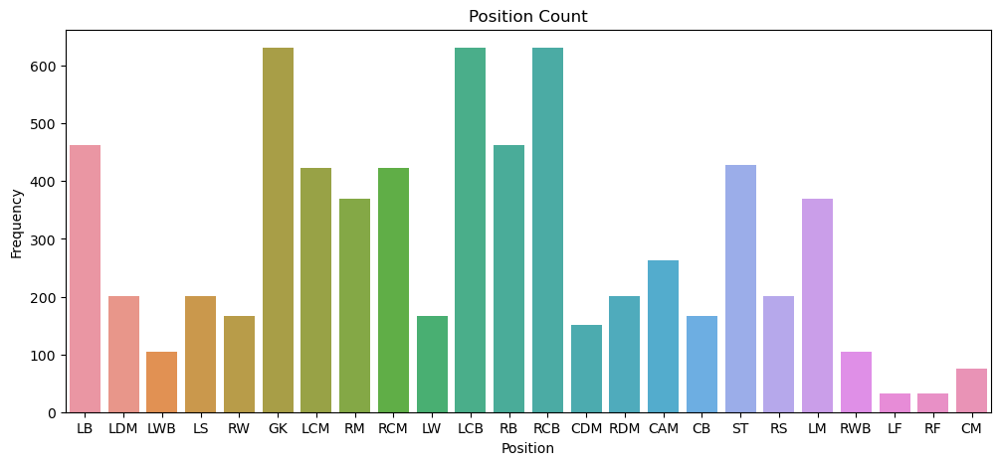

In [9]:
plt.figure(figsize = (12, 5))
sns.countplot(x = 'position', data = df_train,)
plt.title('Position Count')
plt.xlabel('Position')
plt.ylabel('Frequency')
plt.show()

In [10]:
train_na = df_train.isna().sum()
test_na = df_test.isna().sum()
nas_testrain = pd.concat([train_na, test_na], axis=1, keys=['Train', 'Test'])

display(nas_testrain[nas_testrain.sum(axis=1) > 0])

,Train,Test
value_eur,2,3.0
club_loaned_from,6544,722.0
club_joined,351,45.0
nation_jersey_number,6482,716.0
release_clause_eur,353,48.0
player_tags,6124,682.0
player_traits,2589,285.0
pace,631,70.0
shooting,631,70.0
passing,631,70.0


In [11]:
# Make list of categorical and numerical columns so we can keep track of them for later
cat_cols1 = df_train.select_dtypes(include='object').columns.to_list()
num_cols1 = df_train.select_dtypes(include=np.number).columns.to_list()

# See how many different categories there are in each feature to drop the ones that have the most features
category_counts = {
    col: len(df_train[col].unique()) for col in cat_cols1
}

for key, val in category_counts.items():
    print(f"{key}: {val}")

short_name: 6692
birthday_date: 3991
club_name: 701
league_name: 55
club_loaned_from: 197
club_joined: 1264
nationality_name: 144
preferred_foot: 2
work_rate: 9
body_type: 10
real_face: 2
player_tags: 62
player_traits: 773
position: 24


In [12]:
# Drop id column
df_train.drop('id', axis=1, inplace=True)
df_test.drop('id', axis=1, inplace=True)

# Determine which columns to drop
# Drop short_name as it is the most obvious to not be related to position, along with other obvious choices
# Drop the columns with the most missing values with the exception of goalkeeping_speed
# Drop the columns with the most categories
# Drop body_type as is comes from a formula using height and weight so there would exist mullticollinearity
# Also drop columns which are only relevant for the FIFA game itself, like real_face


cols_to_drop = [
                'short_name',
                'club_loaned_from',
                'nation_jersey_number',
                'player_tags',
                'player_traits',
                'club_contract_valid_until',
                'club_name',
                'nationality_name',
                'league_name',
                'real_face',
                'body_type' 
                ]


df_train.drop(cols_to_drop, axis=1, inplace=True)
df_test.drop(cols_to_drop, axis=1, inplace=True)


In [13]:
# Make list of categorical and numerical columns so we can keep track of them for later
cat_cols2 = df_train.select_dtypes(include='object').columns.to_list()
num_cols2 = df_train.select_dtypes(include=np.number).columns.to_list()

catnum_cols = pd.concat([pd.Series(cat_cols2), pd.Series(num_cols2)], axis = 1, keys = ['Categorical', 'Numerical'])

display(catnum_cols.head(10))

,Categorical,Numerical
0,birthday_date,overall
1,club_joined,potential
2,preferred_foot,value_eur
3,work_rate,wage_eur
4,position,height_cm
5,NaN,weight_kg
6,NaN,league_level
7,NaN,club_jersey_number
8,NaN,weak_foot
9,NaN,skill_moves


## Goalkeepers Treatment

In [14]:
# We have the suspicion that 'goalkeeping_speed' is only positive for goalkeepers. Let's check that.

# Check if goalkeeping_speed is only positive for goalkeepers
goalkeepers = df_train[df_train['position'] == 'GK']

if 0 not in goalkeepers['goalkeeping_speed'].unique():
    print('goalkeepers only have positive goalkeeping_speed')

positive_gk_spd = df_train[df_train['goalkeeping_speed'] > 0]

if positive_gk_spd['position'].unique() == ['GK']:
    print('goalkeepers are the only players with positive goalkeeping_speed')

# We can see that goalkeeping_speed is only positive for goalkeepers and all goalkeepers have positive goalkeeping_speed.
# We can therefore turn goalkeeping_speed into a binary variable: 1 if player is a goalkeeper, 0 if not.
df_train['is_gk'] = np.where(df_train['goalkeeping_speed'] > 0, 1, 0)
df_test['is_gk'] = np.where(df_test['goalkeeping_speed'] > 0, 1, 0)

# Drop goalkeeping_speed
df_train.drop('goalkeeping_speed', axis=1, inplace=True)
df_test.drop('goalkeeping_speed', axis=1, inplace=True)

display(df_train['is_gk'].sum(), df_test['is_gk'].sum())



goalkeepers only have positive goalkeeping_speed
goalkeepers are the only players with positive goalkeeping_speed


631

70

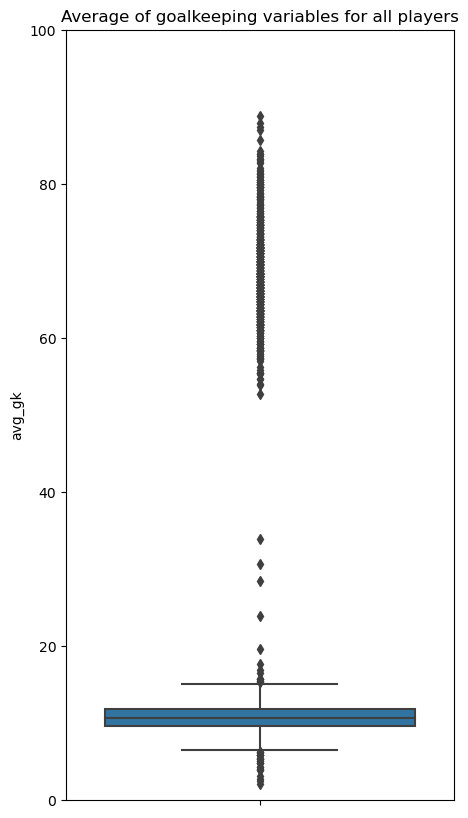

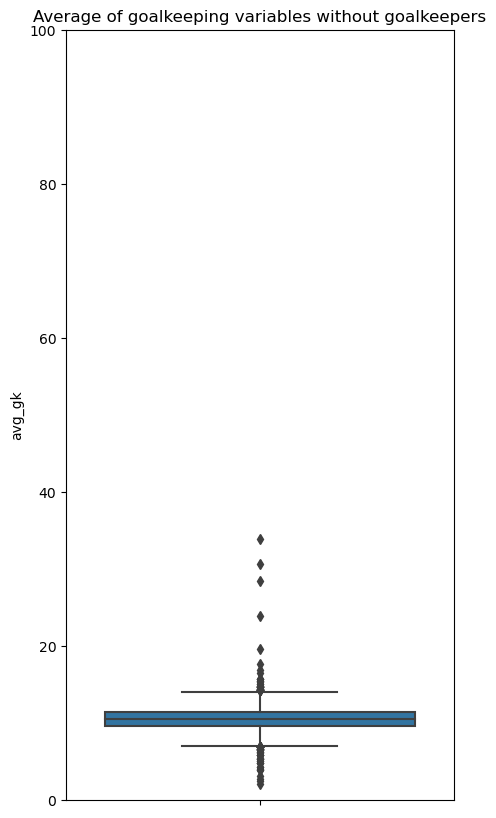

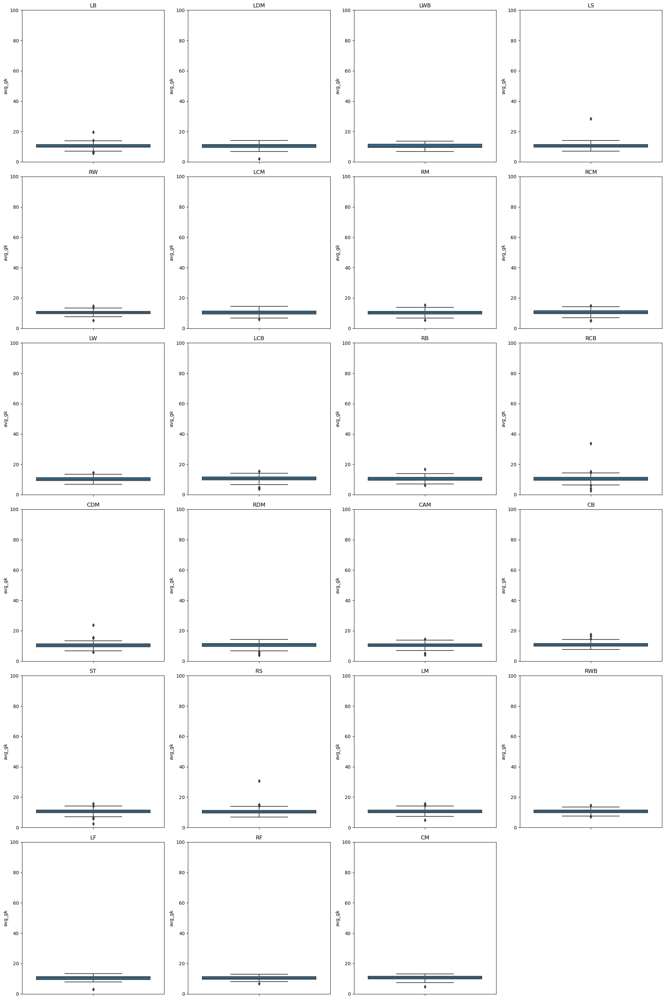

" WE ARE GOING TO COMMENT OUT THIS PART as it takes up space in the output and is kinda unnecessary, but the corollary\nis that the mean and median for the avg_gk for each position is VERY SIMILAR so we can safely confirm WHAT WE ALREADY SAW IN THE \nBOXPLOTS. As a result, we can safely drop the goalkeeping variables for all players as we already have 'is_gk' to identify GK. \nfor position in positions_to_boxplot:\n    display(df_no_gk[df_no_gk['position'] == position]['avg_gk'].describe())\n"

In [15]:
# We also suspect that the variables of the form 'goalkeeping_xxx' are only relevant for goalkeepers
# and would not bring much value for the rest of the players. Let's check that.
# We will print the boxplots for an average of those variables before and after removing goalkeepers, to see if the outliers disappear.
# We can then plot the boxplots for each position.

gk_vars = [col for col in df_train.columns if 'goalkeeping' in col]
gk_vars_pos = gk_vars.copy()
gk_vars_pos.append('position')
non_gk_vars_pos = [col for col in df_train.columns if col not in gk_vars_pos]

df_no_gk = df_train[df_train['position'] != 'GK'].copy()
df_no_gk.drop(non_gk_vars_pos, axis = 1, inplace = True)

df_avg_gk = df_train[gk_vars_pos].copy()

df_avg_gk['avg_gk'] = df_avg_gk[gk_vars].mean(axis = 1)
df_no_gk['avg_gk'] = df_no_gk[gk_vars].mean(axis = 1)

positions_to_boxplot = df_no_gk['position'].unique()

# Plot for all players
plt.figure(figsize = (5, 10))
sns.boxplot(y = df_avg_gk['avg_gk'])
plt.title('Average of goalkeeping variables for all players')
plt.ylim(0, 100)
plt.show()

# Plot without goalkeepers
plt.figure(figsize = (5, 10))
sns.boxplot(y = df_no_gk['avg_gk'])
plt.title('Average of goalkeeping variables without goalkeepers')
plt.ylim(0, 100)
plt.show()

'''
We can already observe how most of the outliers disappear when we remove goalkeepers.
'''

# Plot for each position
plots_per_row = 4
num_rows = (len(positions_to_boxplot) + plots_per_row - 1) // plots_per_row
plt.figure(figsize = (plots_per_row * 5, num_rows * 5))

for index, position in enumerate(positions_to_boxplot):
    plt.subplot(num_rows, plots_per_row, index + 1)
    sns.boxplot(y = df_no_gk[df_no_gk['position'] == position]['avg_gk'])
    plt.title(position)
    plt.ylim(0, 100)

plt.tight_layout()
plt.show()

''' WE ARE GOING TO COMMENT OUT THIS PART as it takes up space in the output and is kinda unnecessary, but the corollary
is that the mean and median for the avg_gk for each position is VERY SIMILAR so we can safely confirm WHAT WE ALREADY SAW IN THE 
BOXPLOTS. As a result, we can safely drop the goalkeeping variables for all players as we already have 'is_gk' to identify GK. 
for position in positions_to_boxplot:
    display(df_no_gk[df_no_gk['position'] == position]['avg_gk'].describe())
'''

In [16]:
import plotly.graph_objects as go
import matplotlib.pyplot as plt
import seaborn as sns

def plot_heat_map(df):
    df_corr = df.corr()

    # Plot correlations
    # Remove upper triangle
    fig, ax = plt.subplots(figsize=(14,8))
    ax = sns.heatmap(df_corr, annot = True)

def plot_distributions(data, columns):
    """
    Plot distributions of specified columns in a dataframe using Viridis color palette.

    Parameters:
    - data: Pandas DataFrame
    - columns: List of column names to plot
    """
    # Set the color palette to Viridis
    sns.set_palette("viridis")

    # Set up subplots
    num_plots = len(columns)
    num_cols = 2  # Number of columns in the subplot grid
    num_rows = (num_plots + 1) // 2  # Number of rows in the subplot grid
    fig, axes = plt.subplots(num_rows, num_cols, figsize=(12, 4 * num_rows))

    # Flatten the 2D array of subplots for easier indexing
    axes = axes.flatten()

    # Plot each column's distribution
    for i, col in enumerate(columns):
        ax = axes[i]
        sns.histplot(data[col], bins=20, kde=True, color='skyblue', edgecolor='black', ax=ax)
        ax.set_title(f'Distribution of {col}')
        ax.set_xlabel(col)
        ax.set_ylabel('Frequency')

    # Adjust layout for better spacing
    plt.tight_layout()
    plt.show()

import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

def plot_distributions_stacked(dataframes, columns, labels, colors=None):
    """
    Plot stacked distributions of specified columns in multiple dataframes.

    Parameters:
    - dataframes: List of Pandas DataFrames
    - columns: List of column names to plot
    - colors: List of colors for each dataframe's distributions
    """
    # Set default colors if not provided
    if colors is None:
        colors = sns.color_palette("husl", n_colors=len(dataframes))

    # Set up subplots
    num_plots = len(columns)
    num_cols = 2  # Number of columns in the subplot grid
    num_rows = (num_plots + 1) // 2  # Number of rows in the subplot grid
    fig, axes = plt.subplots(num_rows, num_cols, figsize=(12, 4 * num_rows))

    # Flatten the 2D array of subplots for easier indexing
    axes = axes.flatten()

    # Plot distributions for each column in the multiple dataframes
    for i, col in enumerate(columns):
        ax = axes[i]
        for j, df in enumerate(dataframes):
            sns.histplot(df[col], bins=20, kde=True, color=colors[j], edgecolor='black', label=labels[j], ax=ax)
        ax.set_title(f'Distribution of {col}')
        ax.set_xlabel(col)
        ax.set_ylabel('Frequency')
        ax.legend()

    # Adjust layout for better spacing
    plt.tight_layout()
    plt.show()

# Example usage:
# Assuming you have three DataFrames called 'df1', 'df2', and 'df3' with columns 'column1', 'column2', ...
# plot_distributions_stacked([df1, df2, df3], ['column1', 'column2', 'column3'])



In [17]:
# As we said before, we can conclude that the goalkeeping variables are not relevant for the rest of the positions.
# As a result, we can safely drop the goalkeeping variables for all players as we already have 'is_gk' to identify GK.

df_train.drop(gk_vars, axis = 1, inplace = True)
df_test.drop(gk_vars, axis = 1, inplace = True)

#display(df_train.head(), df_test.head())

In [18]:
df_train.columns

Index(['overall', 'potential', 'value_eur', 'wage_eur', 'birthday_date',
       'height_cm', 'weight_kg', 'league_level', 'club_jersey_number',
       'club_joined', 'preferred_foot', 'weak_foot', 'skill_moves',
       'international_reputation', 'work_rate', 'release_clause_eur', 'pace',
       'shooting', 'passing', 'dribbling', 'defending', 'physic',
       'attacking_crossing', 'attacking_finishing',
       'attacking_heading_accuracy', 'attacking_short_passing',
       'attacking_volleys', 'skill_dribbling', 'skill_curve',
       'skill_fk_accuracy', 'skill_long_passing', 'skill_ball_control',
       'movement_acceleration', 'movement_sprint_speed', 'movement_agility',
       'movement_reactions', 'movement_balance', 'power_shot_power',
       'power_jumping', 'power_stamina', 'power_strength', 'power_long_shots',
       'mentality_aggression', 'mentality_interceptions',
       'mentality_positioning', 'mentality_vision', 'mentality_penalties',
       'mentality_composure', 'defen

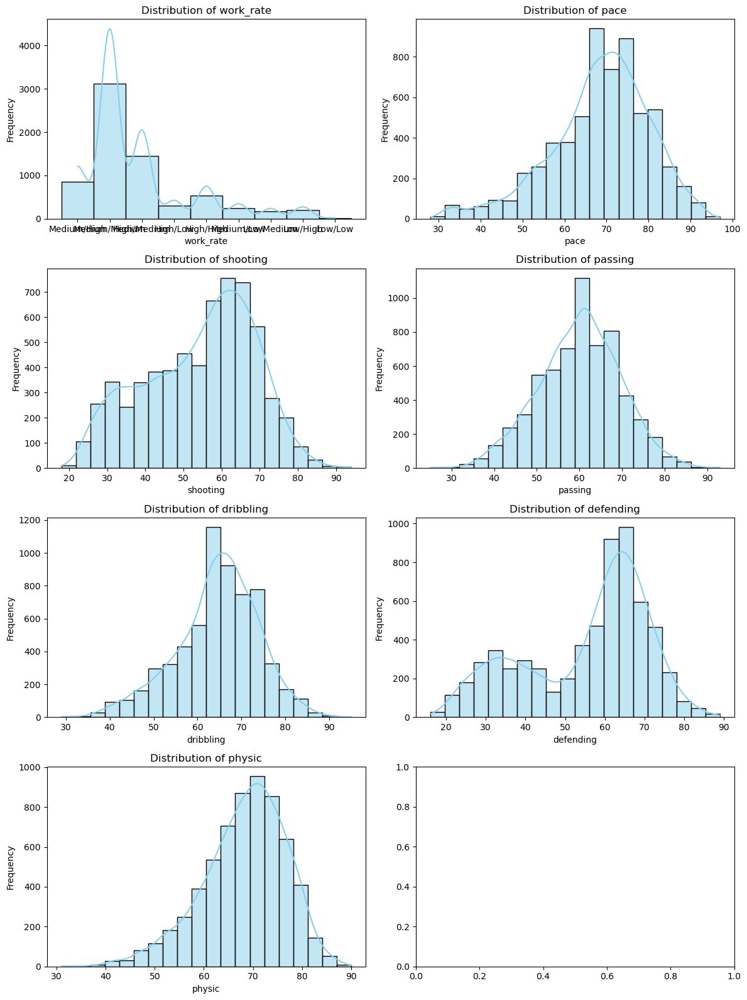

In [19]:
plot_distributions(df_train, ['work_rate',  'pace',
       'shooting', 'passing', 'dribbling', 'defending', 'physic'])


shooting and defending seem interesting because they are irregularly distributed

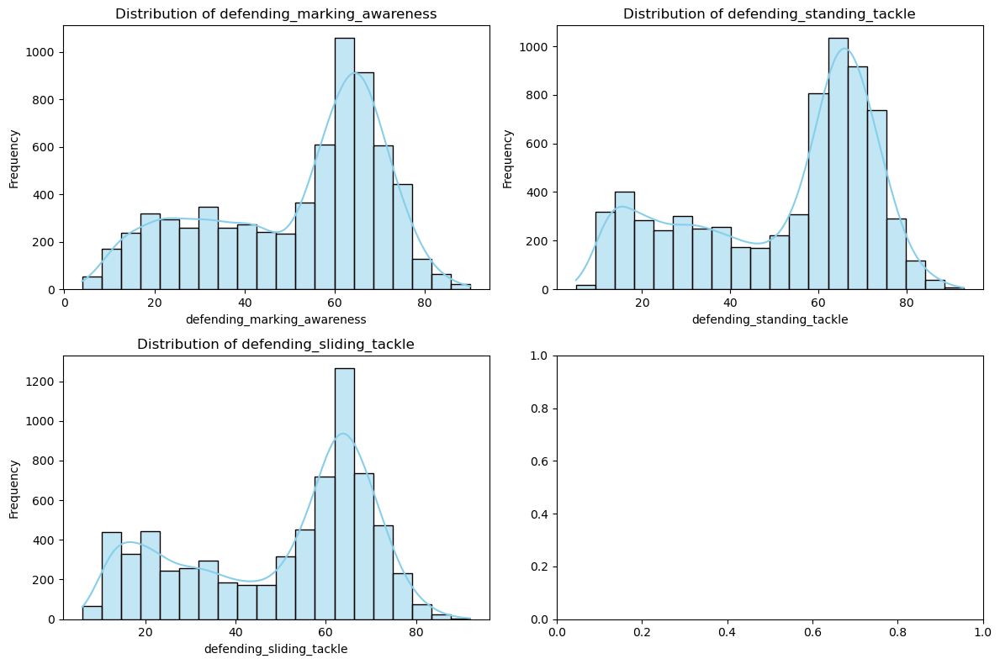

In [20]:
plot_distributions(df_train, ['defending_marking_awareness',
       'defending_standing_tackle', 'defending_sliding_tackle'])

these all seem to mimic the overall defending column distribution, slight pocket of left density with a right skew

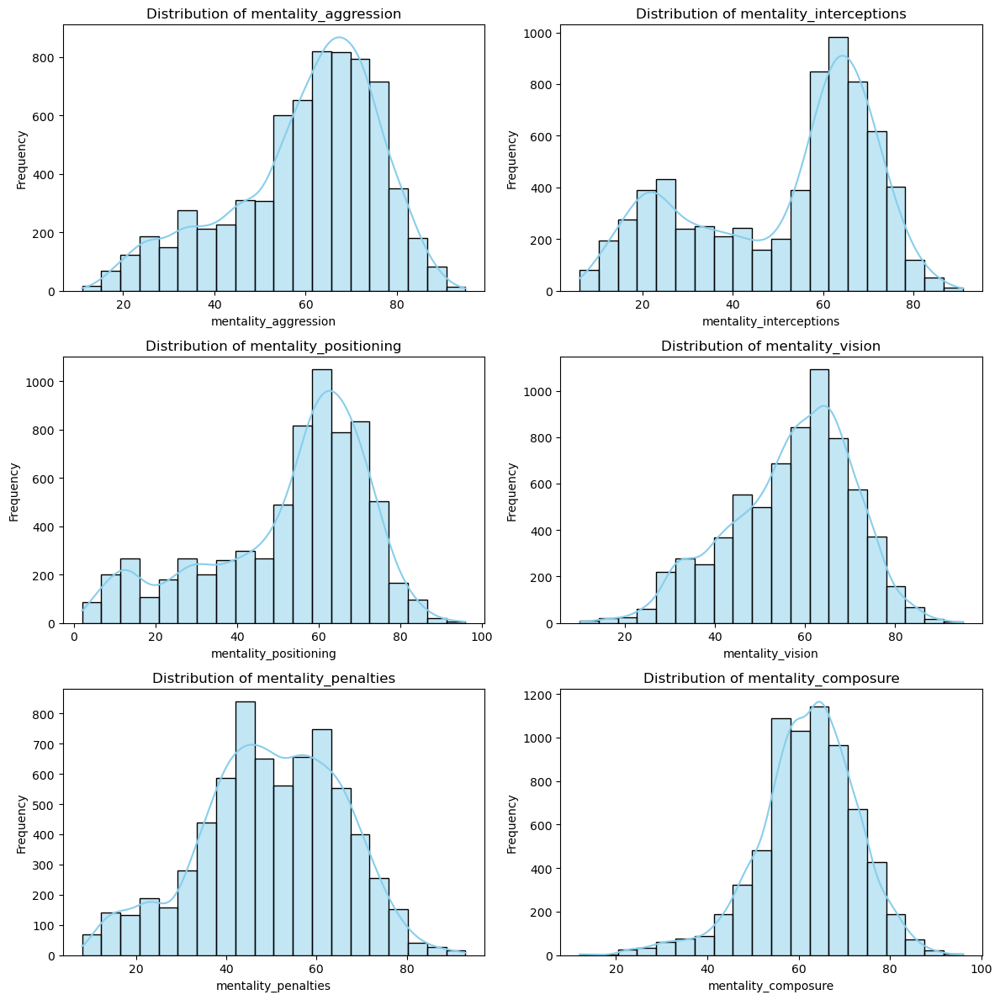

In [21]:
plot_distributions(df_train, ['mentality_aggression', 'mentality_interceptions',
       'mentality_positioning', 'mentality_vision', 'mentality_penalties',
       'mentality_composure'])

penalties and interceptions seem the most interesting here also deviating from the standard distribution. positioning also seems skewed. almost like 2 distributions: 1 with a long prominent left tail and the other with a right skew

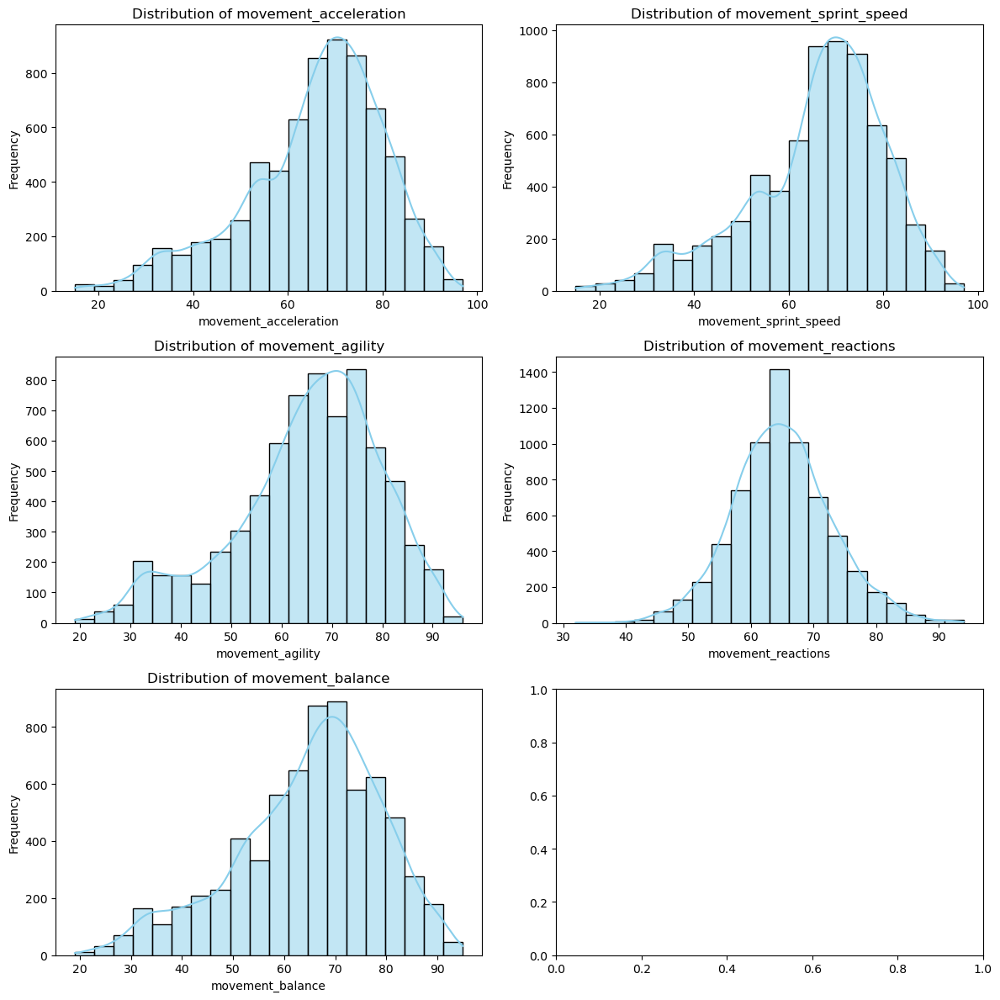

In [22]:
plot_distributions(df_train, ['movement_acceleration', 'movement_sprint_speed', 'movement_agility',
       'movement_reactions', 'movement_balance'])

reactions is perfectly distributed which seems weird. agility also seems atypical which could be a good indicator of some position differences. 

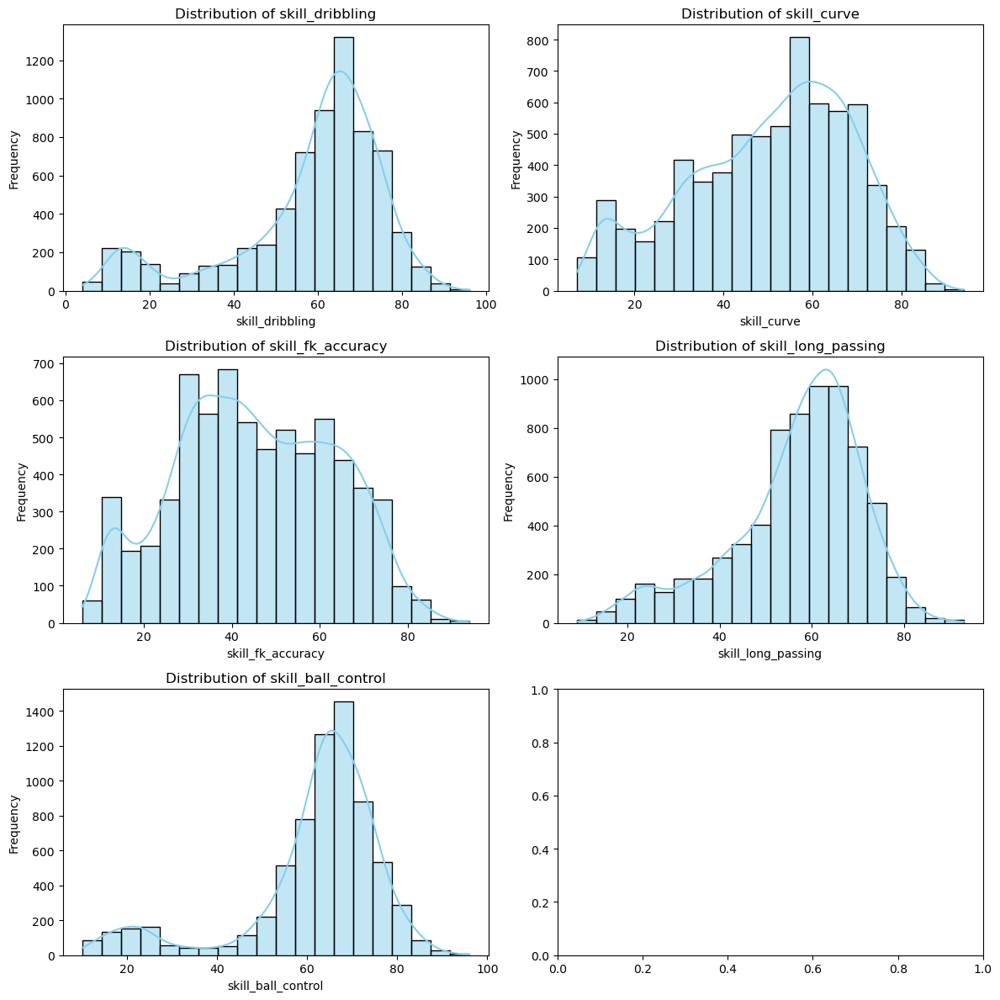

In [23]:
plot_distributions(df_train, ['skill_dribbling', 'skill_curve',
       'skill_fk_accuracy', 'skill_long_passing', 'skill_ball_control'])

dribbling and ball control both have similar left hand pockets of density. long passing has a deep right skew. fk and curve both seem related in their distribution. 

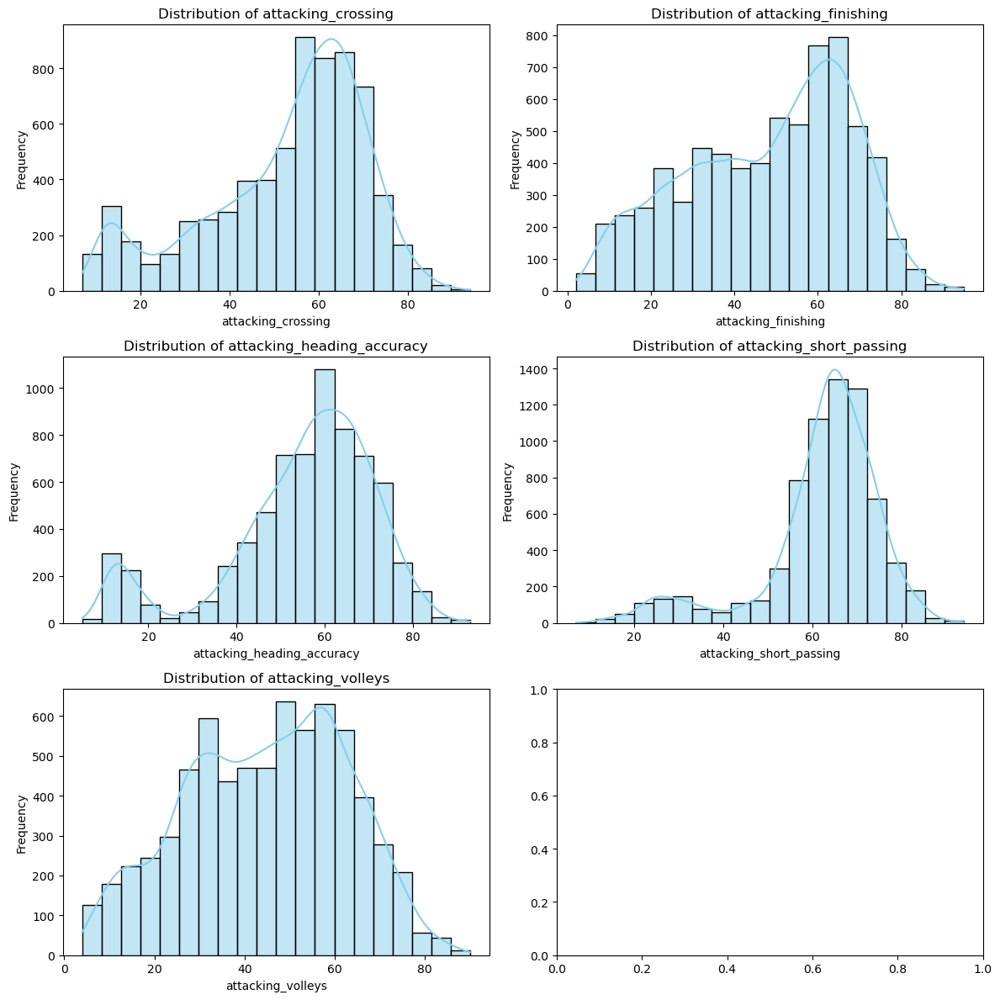

In [24]:
plot_distributions(df_train, ['attacking_crossing', 'attacking_finishing',
       'attacking_heading_accuracy', 'attacking_short_passing',
       'attacking_volleys'])

attack heading has a left pocket of density, similar to short passing, heading accuracy and a little bit in crossing as well. volleys and finishing are both distributed widely. 

# Distribution Analysis Overview

<b>overview</b>: shooting and defending seem interesting because they are irregularly distributed

<b>defending</b>: these all seem to mimic the overall defending column distribution, slight pocket of left density with a right skew

<b>mentality</b>: penalties and interceptions seem the most interesting here also deviating from the standard distribution. positioning also seems skewed. almost like 2 distributions: 1 with a long prominent left tail and the other with a right skew

<b>movement</b>: reactions is perfectly distributed which seems weird. agility also seems atypical which could be a good indicator of some position differences. 

<b>skill</b>: dribbling and ball control both have similar left hand pockets of density. long passing has a deep right skew. fk and curve both seem related in their distribution. 

<b>attacking</b>: attack heading has a left pocket of density, similar to short passing, heading accuracy and a little bit in crossing as well. volleys and finishing are both distributed widely. 


<b>overall</b>: slight pocket of left density with a right skew seems to be the most common irregularly distributed pattern

<b>key columns of interest</b>: shooting, defending, penalties, interceptions, reactions, agility, dribbling, ball control, attack heading, short passing, heading accuracy

<b>next steps</b>: 
would be good to see some of these columns by player type


In [25]:
# map each position to the position type forward defense midfield

position_dict = {'RW':0,
'ST':0,
'LW':0,
'RCM':1,
'GK':3,
'CDM':1,
'LCB':2,
'RDM':1,
'RS':0,
'LCM':1,
'CAM':1,
'RCB':2,
'LDM':1,
'LB':2,
'RB':2,
'LM':1,
'RM':1,
'LS':0,
'CB':2,
'RWB':2,
'RF':0,
'CM':1,
'LWB':2,
'LF':0}

df_train['position_type'] = df_train.position.map(position_dict)

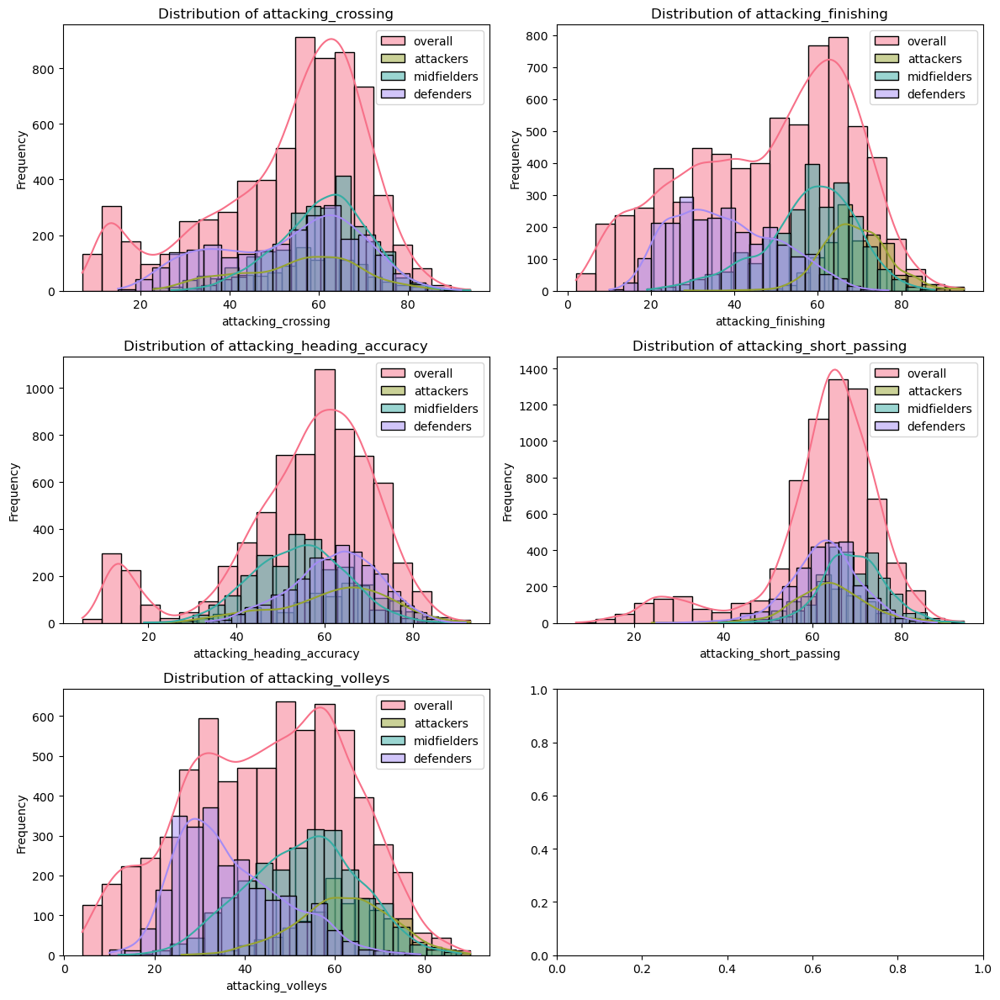

In [26]:

all_dfs = [df_train, df_train.loc[df_train.position_type == 0], df_train.loc[df_train.position_type == 1], df_train.loc[df_train.position_type == 2]]
labels = ['overall','attackers','midfielders', 'defenders']


plot_distributions_stacked(all_dfs, ['attacking_crossing', 'attacking_finishing',
   'attacking_heading_accuracy', 'attacking_short_passing',
   'attacking_volleys'],  labels=labels)



crossing is a great distribution for midfielders

finishing and volleys are great predictor for defenders negatively 

finishing and volleys are a great distribution for attackers

heading is slightly lower for midfielders

short passing is not really useful as all are evenly distributed




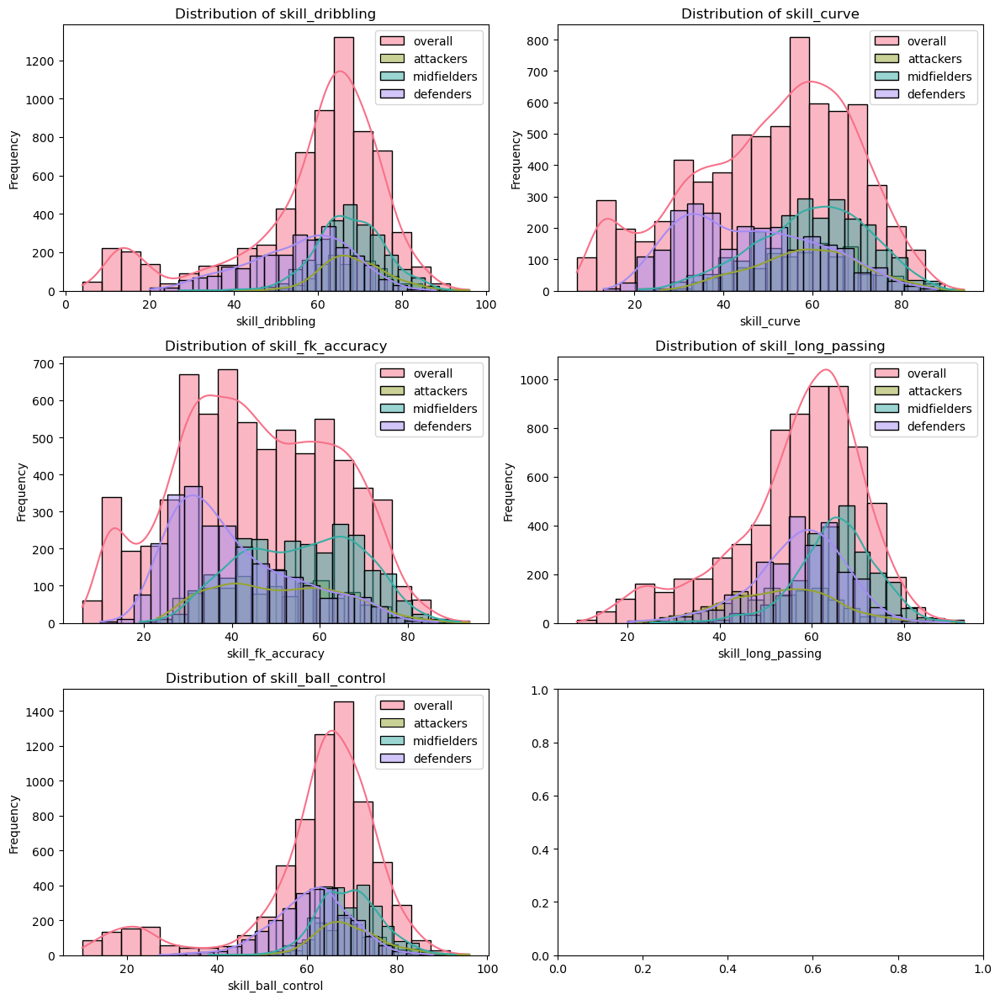

In [27]:

plot_distributions_stacked(all_dfs, ['skill_dribbling', 'skill_curve',
   'skill_fk_accuracy', 'skill_long_passing', 'skill_ball_control'],  labels=labels)

defenders negatively skewed on skill curve and fk accuracy 

both midfielders and attackers share distributions for most of these skills

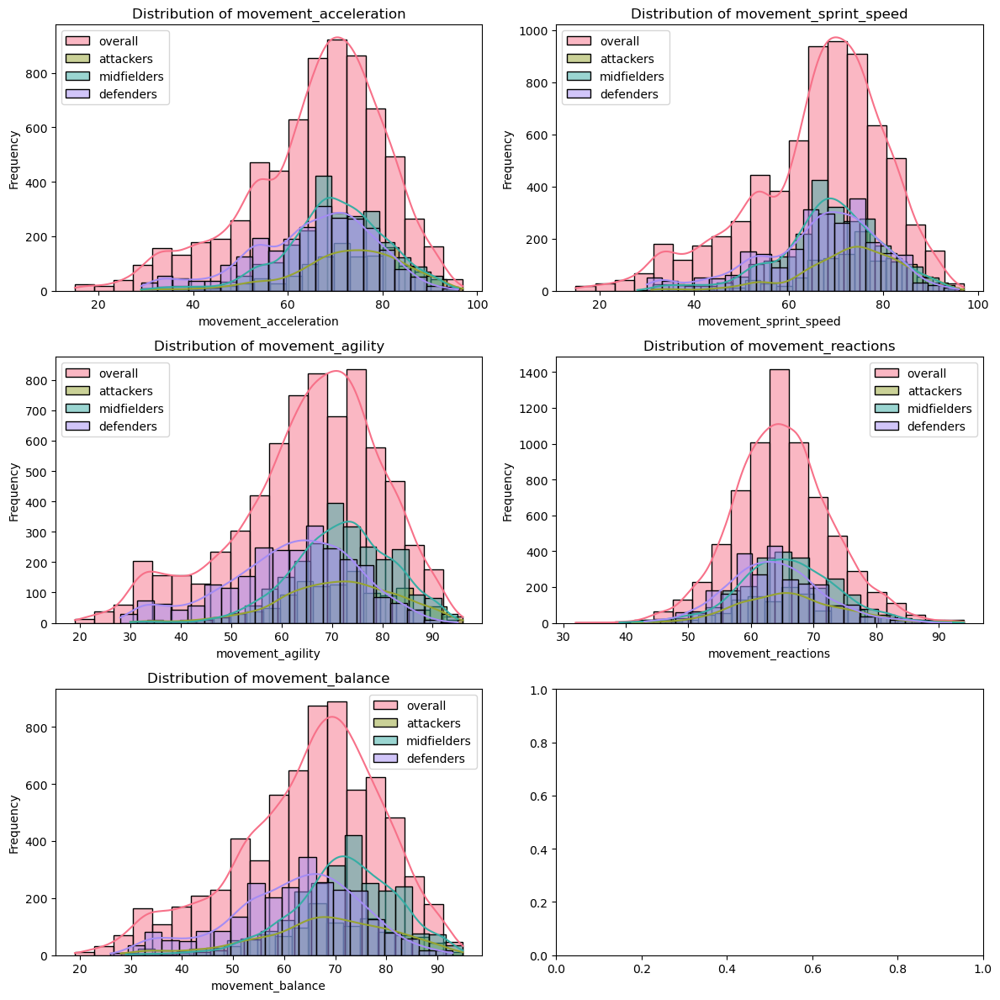

In [28]:

plot_distributions_stacked(all_dfs, ['movement_acceleration', 'movement_sprint_speed', 'movement_agility',
   'movement_reactions', 'movement_balance'],  labels=labels)

movement is pretty balanced among all of these positions

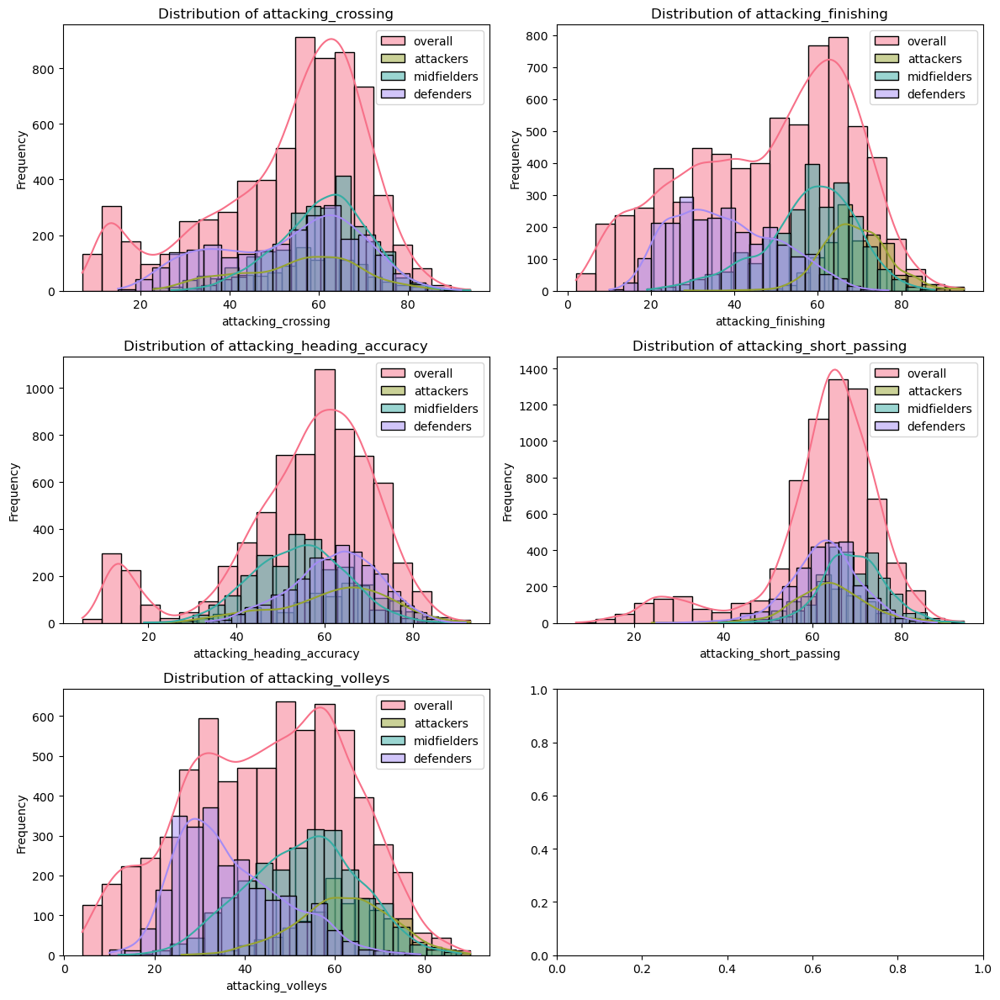

In [29]:

plot_distributions_stacked(all_dfs, ['attacking_crossing', 'attacking_finishing',
   'attacking_heading_accuracy', 'attacking_short_passing',
   'attacking_volleys'],  labels=labels)

finishing and volleys are both uniquely negatively skewed for defenders

crossing is also lower for defenders

crossing is uniquely strongly right skewed for midfielders

finishing is right skewed for attackers

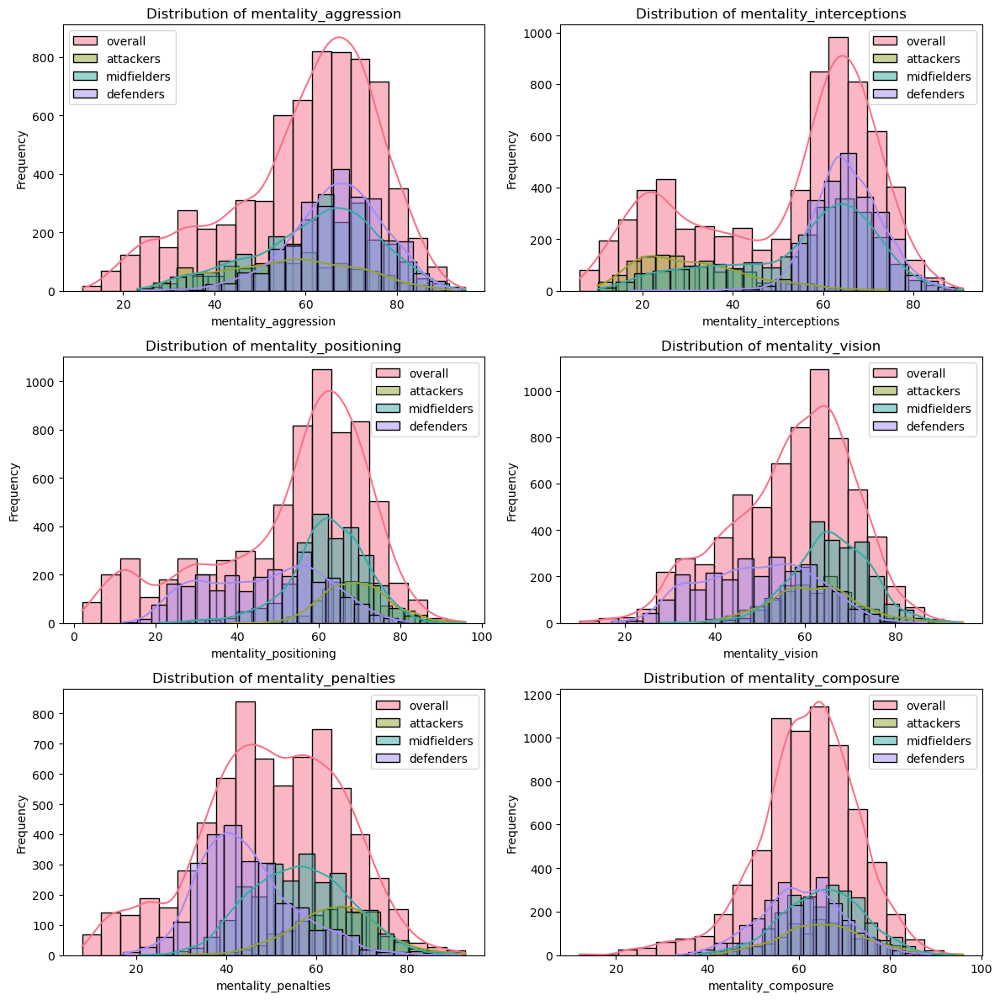

In [30]:

plot_distributions_stacked(all_dfs, ['mentality_aggression', 'mentality_interceptions',
   'mentality_positioning', 'mentality_vision', 'mentality_penalties',
   'mentality_composure'],  labels=labels)

attackers are uniquely negatively skewed for interceptions

defense typically have less penalties

midfielders have the best vision

defenders have the most negatively skewed / worst positioning

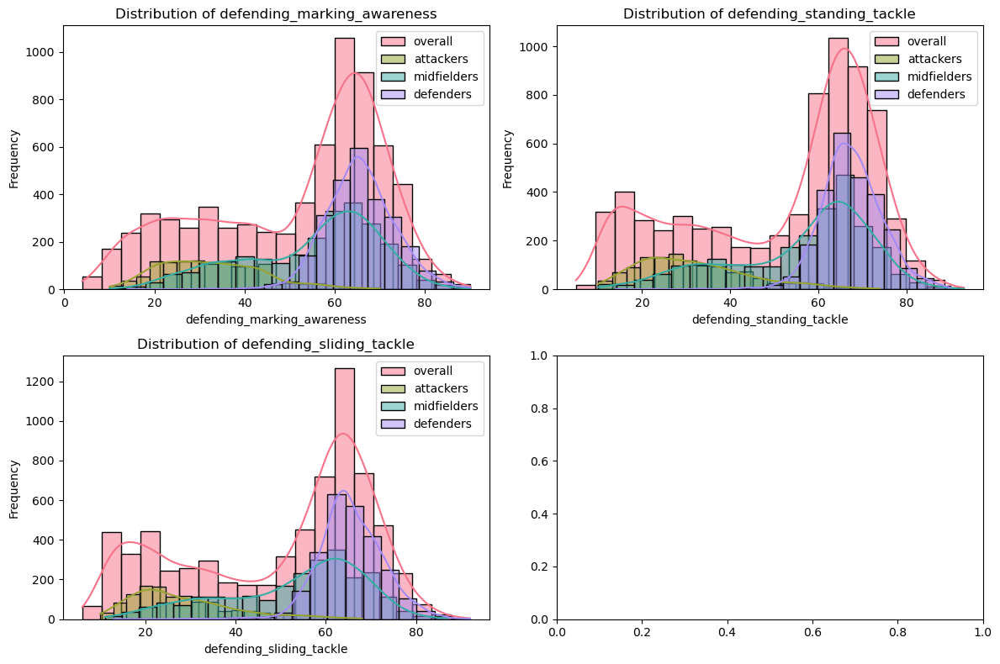

In [31]:

plot_distributions_stacked(all_dfs, ['defending_marking_awareness',
   'defending_standing_tackle', 'defending_sliding_tackle'],  labels=labels)

all three are negatively skewed for attackers

all are positive for defenders and neutral for midfielders

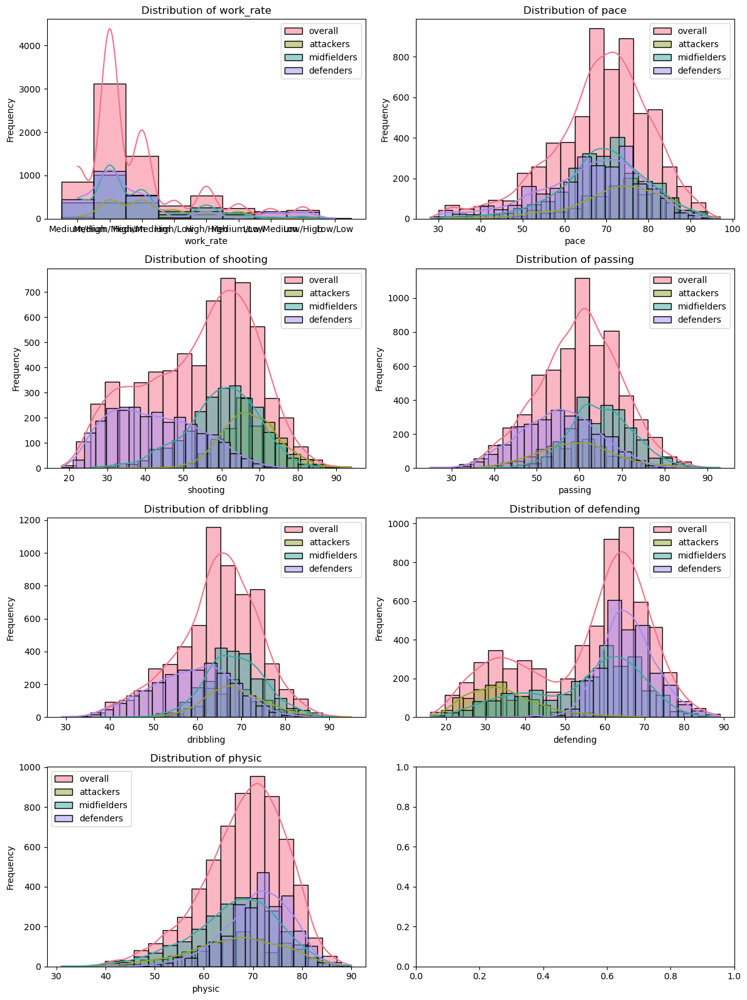

In [32]:

plot_distributions_stacked(all_dfs, ['work_rate',  'pace',
   'shooting', 'passing', 'dribbling', 'defending', 'physic'],  labels=labels)

defenders are strongly negatively skewed for shooting

attackers are strongly negative for defending

midfielders are most uniquely good at passing


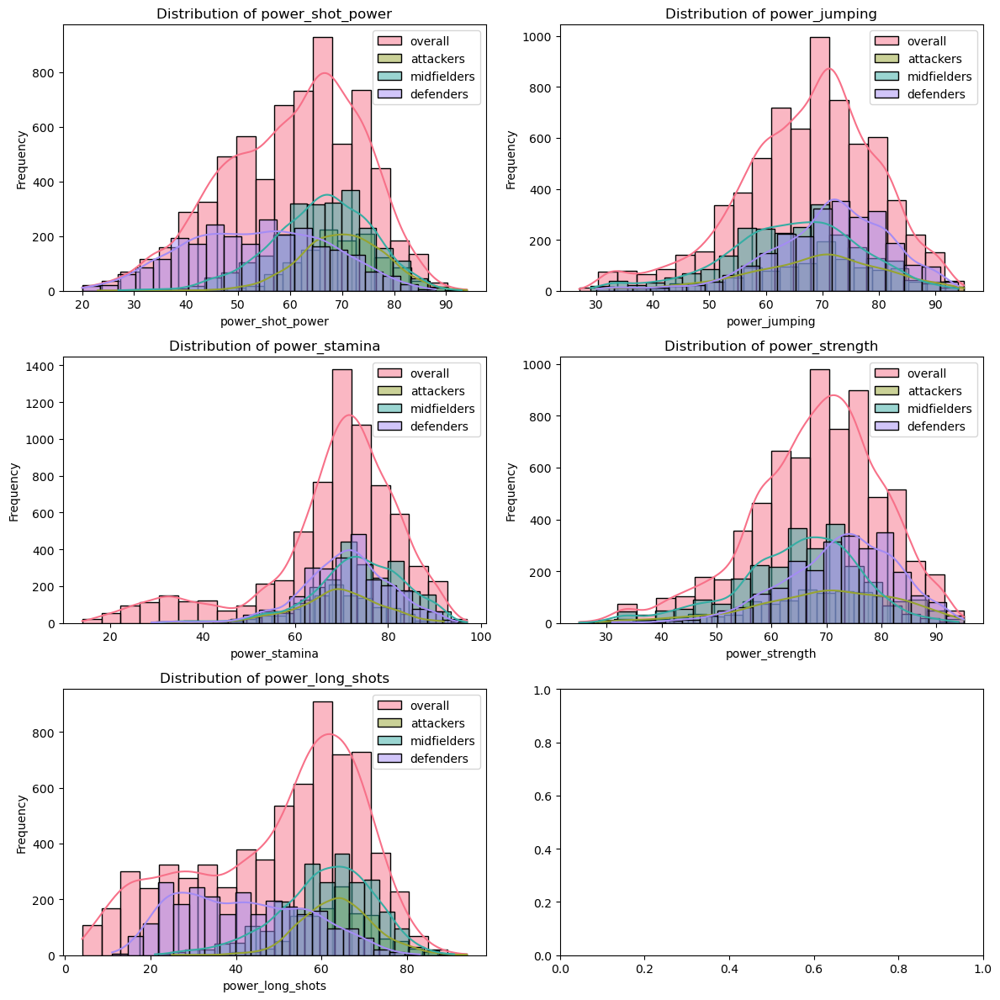

In [33]:

plot_distributions_stacked(all_dfs, ['power_shot_power',
       'power_jumping', 'power_stamina', 'power_strength', 'power_long_shots'],  labels=labels)

defenders have lower shot power and long shots

slightly better strength and jumping for defenders

midfielders have slightly less strength

# <b>takeaways</b>
attackers are good at attacking, defenders at defending, midfielders at passing

midfielders are best at: vision, crossing, fk_accuracy, passing

midfielders are bad at: header_accuracy, typically less phsyic, power_strength

attackers are best at: finishing, volleys

attackers are bad at: any defending, interceptions, 

defenders are best at: defending, not taking penalties, strength, jumping

defenders are bad at: shooting, positioning, skill_curve, fk_accuracy, finishing, volleys, crossing, shot power, long shots

<b>key columns</b>: vision, crossing, fk_accuracy, passing, header_accuracy, physic, finishing, volleys, defending_, interceptions, penalties, shooting, positioning, skill_curve, fk_accuracy, finishing, volleys, crossing, power_shot, long_shot, jumping, power_strength

In [34]:
non_skill_cols = ['overall', 'potential', 'value_eur', 'wage_eur', 'birthday_date',
       'height_cm', 'weight_kg', 'league_level', 'club_jersey_number',
       'club_joined', 'preferred_foot', 'weak_foot', 'skill_moves',
       'international_reputation',  'release_clause_eur', 'position',
       'is_gk', 'position_type']


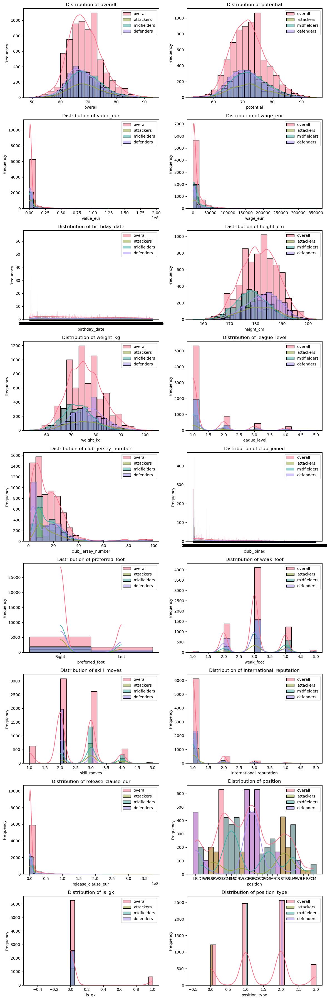

In [35]:
plot_distributions_stacked(all_dfs, non_skill_cols,  labels=labels)

height and weight are both typically less for midfielders and more for defenders

skill moves looks interesting and jersey number also

preferred foot needs to be encoded

In [36]:
# find out if there are any jersey numbers that belong solely to a particular position
df_train.groupby(['position_type','club_jersey_number'])['club_jersey_number'].count().to_csv('jersey_number_analysis.csv')

most jersey numbers are below 12 there are some jerseys that are predominantly attackers, or defenders or midfielders or some combination of both. will not scale this column. 

In [37]:
df_train.columns

Index(['overall', 'potential', 'value_eur', 'wage_eur', 'birthday_date',
       'height_cm', 'weight_kg', 'league_level', 'club_jersey_number',
       'club_joined', 'preferred_foot', 'weak_foot', 'skill_moves',
       'international_reputation', 'work_rate', 'release_clause_eur', 'pace',
       'shooting', 'passing', 'dribbling', 'defending', 'physic',
       'attacking_crossing', 'attacking_finishing',
       'attacking_heading_accuracy', 'attacking_short_passing',
       'attacking_volleys', 'skill_dribbling', 'skill_curve',
       'skill_fk_accuracy', 'skill_long_passing', 'skill_ball_control',
       'movement_acceleration', 'movement_sprint_speed', 'movement_agility',
       'movement_reactions', 'movement_balance', 'power_shot_power',
       'power_jumping', 'power_stamina', 'power_strength', 'power_long_shots',
       'mentality_aggression', 'mentality_interceptions',
       'mentality_positioning', 'mentality_vision', 'mentality_penalties',
       'mentality_composure', 'defen

## New Variables Extraction


In [38]:
# try a new column called unfulfilled_potential
df_train['unfulfilled_potential'] = df_train['potential'] - df_train['overall'] 
df_test['unfulfilled_potential'] = df_test['potential'] - df_test['overall'] 

# try a new column for contract length
df_train['contract_length_years'] = (df_train['value_eur'] / df_train['wage_eur']) / 52
df_test['contract_length_years'] = (df_test['value_eur'] / df_train['wage_eur']) / 52

# We have birthdays for all players. We can extract the age of the player from this.

# Extract age from birthday
df_train['birthday_date'] = pd.to_datetime(df_train['birthday_date'], infer_datetime_format=True)
df_test['birthday_date'] = pd.to_datetime(df_test['birthday_date'], infer_datetime_format=True)

current_date = datetime.now()

df_train['age'] = (current_date - df_train['birthday_date']).dt.days // 365
df_test['age'] = (current_date - df_test['birthday_date']).dt.days // 365

# modify the unfulfilled potential column to divide by wage
df_train['unfulfilled_potential_by_age'] = df_train['unfulfilled_potential'] / df_train['age']
df_test['unfulfilled_potential_by_age'] = df_test['unfulfilled_potential'] / df_test['age']

# create a column for body mass index bmi
df_train['bmi'] = df_train['weight_kg'] / ((df_train['height_cm']/1000)**2)
df_test['bmi'] = df_test['weight_kg'] / ((df_test['height_cm']/1000)**2)

# try a bmi by age
df_train['bmi_age'] = df_train['bmi'] / (df_train['age'])
df_test['bmi_age'] = df_test['bmi'] / (df_test['age'])

# Extract years since joined club
df_train['club_joined'] = pd.to_datetime(df_train['club_joined'], infer_datetime_format=True)
df_test['club_joined'] = pd.to_datetime(df_test['club_joined'], infer_datetime_format=True)

df_train['years_since_joined'] = (current_date - df_train['club_joined']).dt.days // 365
df_test['years_since_joined'] = (current_date - df_test['club_joined']).dt.days // 365

df_train['years_since_joined'] = df_train['years_since_joined'].astype(float)
df_test['years_since_joined'] = df_test['years_since_joined'].astype(float)

# We extract attacking_work_rate and defensive_work_rate from the work_rate column.

df_train['atk_wr'] = df_train['work_rate'].str.split('/').str[0]
df_train['def_wr'] = df_train['work_rate'].str.split('/').str[1]
df_test['atk_wr'] = df_test['work_rate'].str.split('/').str[0]
df_test['def_wr'] = df_test['work_rate'].str.split('/').str[1]

# We create a mapping for the work rates to convert them to numerical labels.

wr_mapping = {
    'Low': 1,
    'Medium': 2,
    'High': 3
}

df_train['atk_wr'] = df_train['atk_wr'].map(wr_mapping)
df_train['def_wr'] = df_train['def_wr'].map(wr_mapping)
df_test['atk_wr'] = df_test['atk_wr'].map(wr_mapping)
df_test['def_wr'] = df_test['def_wr'].map(wr_mapping)

# Drop birthday_date because we already extracted the relevant information from it.
#df_train.drop('birthday_date', axis=1, inplace=True)
#df_test.drop('birthday_date', axis=1, inplace=True)

/var/folders/d4/rcb0hfcs0bzgr7z0mw72lc_w0000gn/T/ipykernel_26057/4275793656.py:12: UserWarning: The argument 'infer_datetime_format' is deprecated and will be removed in a future version. A strict version of it is now the default, see https://pandas.pydata.org/pdeps/0004-consistent-to-datetime-parsing.html. You can safely remove this argument.
  df_train['birthday_date'] = pd.to_datetime(df_train['birthday_date'], infer_datetime_format=True)
/var/folders/d4/rcb0hfcs0bzgr7z0mw72lc_w0000gn/T/ipykernel_26057/4275793656.py:13: UserWarning: The argument 'infer_datetime_format' is deprecated and will be removed in a future version. A strict version of it is now the default, see https://pandas.pydata.org/pdeps/0004-consistent-to-datetime-parsing.html. You can safely remove this argument.
  df_test['birthday_date'] = pd.to_datetime(df_test['birthday_date'], infer_datetime_format=True)
/var/folders/d4/rcb0hfcs0bzgr7z0mw72lc_w0000gn/T/ipykernel_26057/4275793656.py:33: UserWarning: The argument '

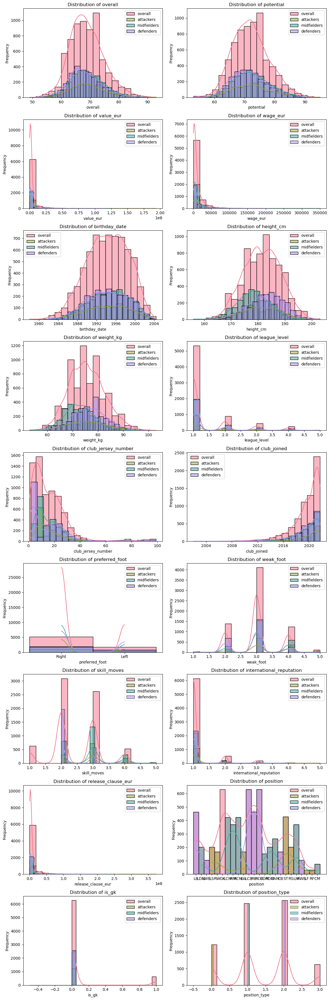

In [39]:
# now visualizing the new columns
all_dfs = [df_train, df_train.loc[df_train.position_type == 0], df_train.loc[df_train.position_type == 1], df_train.loc[df_train.position_type == 2]]
new_feature_cols = ['atk_wr','def_wr','unfulfilled_potential', 'unfulfilled_potential_by_age', 'contract_length_years', 'age', 'bmi', 'bmi_age', 'years_since_joined']
plot_distributions_stacked(all_dfs, non_skill_cols,  labels=labels)

defenders are slightly older with a slightly lower bmi with respect to their age

the other columns do not seem useful or have too many outliers to be useful

<b>takeaway cols:</b> bmi_age, age

# Data Preprocessing

Based on the analysis conducted earlier the next steps are:

    encode categorical columns

    remove outliers for the wage columns then reanalyze their usefulness

    select only the useful columns

    clean up extraneous columns

    scale the columns (with respect to the league level)

In [40]:
# We prepare the functions for preprocessing

def encode_categorical_columns(data):
    """
    nominal or categorical i.e. blue red green
    """
    # Apply one-hot encoding
    encoder = OneHotEncoder(drop='first')

    encoded_data = encoder.fit_transform(data).toarray()
    # Convert the encoded data back to a dataframe
    encoded_data = pd.DataFrame(encoded_data, columns=encoder.get_feature_names_out(data.columns))

    return encoded_data

def find_outliers_iqr(df):
    # Calculate IQR for each column
    Q1 = df.quantile(0.25)
    Q3 = df.quantile(0.75)
    IQR = Q3 - Q1

    # Find columns with outliers based on IQR
    outliers_columns_iqr = df.columns[((df < (Q1 - 1.5 * IQR)) | (df > (Q3 + 1.5 * IQR))).any(axis=0)]

    # Display columns with outliers based on IQR
    print("Columns with outliers (IQR):", outliers_columns_iqr)

    return outliers_columns_iqr

def remove_outliers_iso_forest(data, contamination="auto"):
    
    #Method removes outliers using an iso forest, ignoring NaN values, for each column individually.
    
    #:param DataFrame data: a DataFrame with multiple columns
    #:param float contamination: level at which outliers are trimmed (0-0.5)
    #:return: DataFrame with outliers set to NaN, preserving the original NaN values
    
    # Create a copy of the DataFrame to avoid modifying the original one
    result = data.copy()

    # Process each column separately
    for col in data.columns:
        # Separate NaN and non-NaN values for the column
        non_nan_data = data[col].dropna()
        nan_data = data[col][data[col].isna()]

        # Check if non_nan_data is not empty
        if not non_nan_data.empty:
            # Apply Isolation Forest only on non-NaN data
            iso = IsolationForest(contamination=contamination)
            yhat = iso.fit_predict(non_nan_data.values.reshape(-1, 1))

            # Select all rows that are not outliers
            mask = yhat != -1

            # Mark outliers as NaN
            non_nan_data[mask] = np.nan

            # Combine processed non-NaN data with original NaN values for the column
            combined_data = pd.concat([non_nan_data, nan_data]).sort_index()
            result[col] = combined_data

    return result

def remove_outliers_iqr(data, iqr_multiplier = 1.5):
    """
    Remove outliers outside of the interquartile range (IQR) in specified columns of a DataFrame.

    Parameters:
    - df: pandas DataFrame
    - columns: list of column names to consider for outlier removal
    - multiplier: multiplier for the IQR to determine the outlier threshold

    Returns:
    - DataFrame without outliers in the specified columns
    """

    for column in data.columns:
        # Calculate the IQR for the column
        Q1 = data[column].quantile(0.25)
        Q3 = data[column].quantile(0.75)
        IQR = Q3 - Q1

        # Define the upper and lower bounds for outliers
        lower_bound = Q1 - iqr_multiplier * IQR
        upper_bound = Q3 + iqr_multiplier * IQR

        # Remove outliers outside of the bounds
        data.loc[(data[column] <= lower_bound), column] = np.nan
        data.loc[(data[column] >= upper_bound), column] = np.nan

    return data


In [41]:
# Make list of categorical and numerical columns so we can keep track of them for later
cat_cols = df_train.select_dtypes(include='object').columns.to_list()
cat_cols.remove('position')
num_cols = df_train.select_dtypes(include=np.number).columns.to_list()
catnum_cols = pd.concat([pd.Series(cat_cols), pd.Series(num_cols)], axis = 1, keys = ['Categorical', 'Numerical'])
display(catnum_cols.head())

,Categorical,Numerical
0,preferred_foot,overall
1,work_rate,potential
2,NaN,value_eur
3,NaN,wage_eur
4,NaN,height_cm


In [42]:
# encode the categorical column for preferred foot

df_train['preferred_foot_right'] = df_train['preferred_foot'] == 'Right'
df_test['preferred_foot_right'] = df_test['preferred_foot'] == 'Right'

df_train['preferred_foot_right'] = df_train['preferred_foot_right'].astype(int)
df_test['preferred_foot_right'] = df_test['preferred_foot_right'].astype(int)

df_train = df_train.drop(columns=['preferred_foot'])
df_test = df_test.drop(columns=['preferred_foot'])

df_train['preferred_foot_right'].unique()

array([1, 0])

In [43]:
# check our list again for all numerical
cat_cols = df_train.select_dtypes(include='object').columns.to_list()
cat_cols.remove('position')
num_cols = df_train.select_dtypes(include=np.number).columns.to_list()
catnum_cols = pd.concat([pd.Series(cat_cols), pd.Series(num_cols)], axis = 1, keys = ['Categorical', 'Numerical'])
display(catnum_cols.head())

,Categorical,Numerical
0,work_rate,overall
1,NaN,potential
2,NaN,value_eur
3,NaN,wage_eur
4,NaN,height_cm


now all of the data is numerical we will start treating outliers. 

In [44]:
outlier_cols = find_outliers_iqr(df_train[num_cols])

Columns with outliers (IQR): Index(['overall', 'potential', 'value_eur', 'wage_eur', 'height_cm',
       'weight_kg', 'league_level', 'club_jersey_number', 'weak_foot',
       'skill_moves', 'international_reputation', 'release_clause_eur', 'pace',
       'passing', 'dribbling', 'physic', 'attacking_crossing',
       'attacking_heading_accuracy', 'attacking_short_passing',
       'skill_dribbling', 'skill_long_passing', 'skill_ball_control',
       'movement_acceleration', 'movement_sprint_speed', 'movement_agility',
       'movement_reactions', 'movement_balance', 'power_shot_power',
       'power_jumping', 'power_stamina', 'power_strength',
       'mentality_aggression', 'mentality_positioning', 'mentality_vision',
       'mentality_composure', 'is_gk', 'unfulfilled_potential',
       'contract_length_years', 'age', 'unfulfilled_potential_by_age', 'bmi',
       'bmi_age', 'years_since_joined', 'def_wr', 'preferred_foot_right'],
      dtype='object')


lots of outliers but I only want to look at wage related cols right now

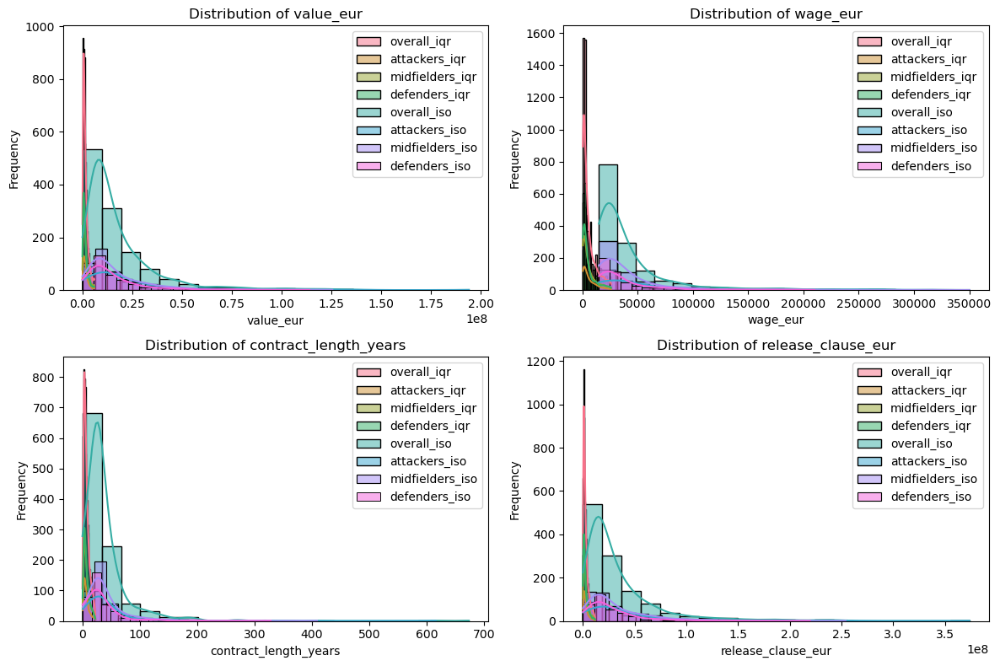

In [45]:
# trying 2 methods

wage_cols = ['value_eur', 'wage_eur','contract_length_years','release_clause_eur']

iqr_method = df_train.copy()
iso_method = df_train.copy()

iqr_method[wage_cols] = remove_outliers_iqr(df_train[wage_cols])
iso_method[wage_cols] = remove_outliers_iso_forest(df_train[wage_cols])

# now visualizing
all_dfs = [iqr_method, iqr_method.loc[iqr_method.position_type == 0], iqr_method.loc[iqr_method.position_type == 1], iqr_method.loc[iqr_method.position_type == 2], iso_method, iso_method.loc[iso_method.position_type == 0], iso_method.loc[iso_method.position_type == 1], iso_method.loc[iso_method.position_type == 2]]
labels = ['overall_iqr','attackers_iqr','midfielders_iqr', 'defenders_iqr','overall_iso','attackers_iso','midfielders_iso', 'defenders_iso']

# now visualizing the new columns
plot_distributions_stacked(all_dfs, wage_cols,  labels=labels)


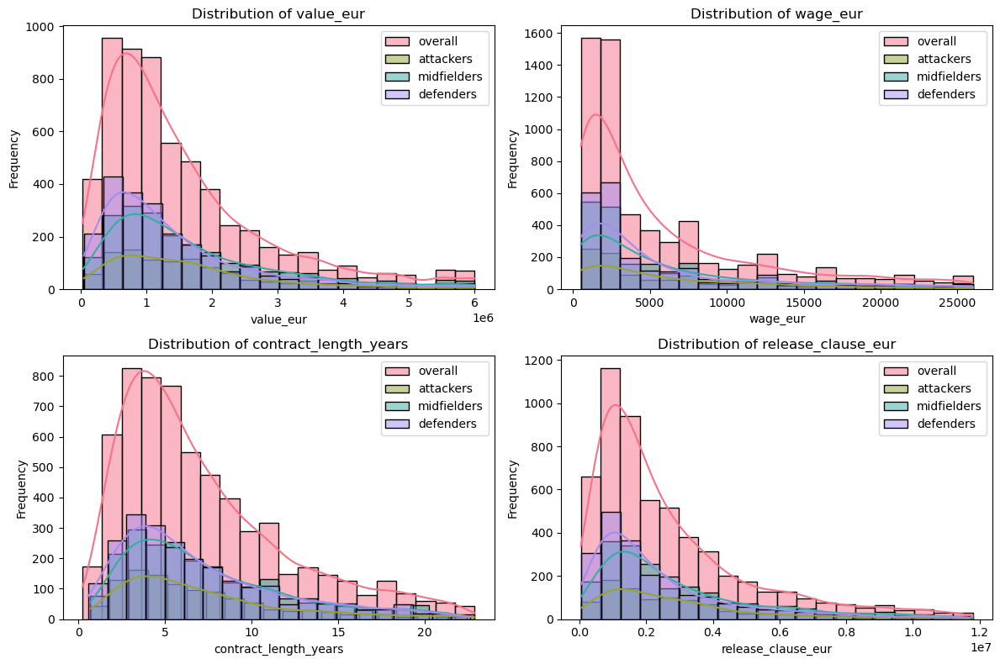

In [46]:
# trying 2 methods

wage_cols = ['value_eur', 'wage_eur','contract_length_years','release_clause_eur']

df_train[wage_cols] = remove_outliers_iqr(df_train[wage_cols])

# now visualizing
all_dfs = [df_train, df_train.loc[df_train.position_type == 0], df_train.loc[df_train.position_type == 1], df_train.loc[df_train.position_type == 2]]
labels = ['overall','attackers','midfielders', 'defenders']

# now visualizing the new columns
plot_distributions_stacked(all_dfs, wage_cols,  labels=labels)


still not super useful, trying a league level analysis

In [47]:
df_train.league_level.value_counts()

league_level
1    5332
2     885
3     433
4     236
5       9
Name: count, dtype: int64

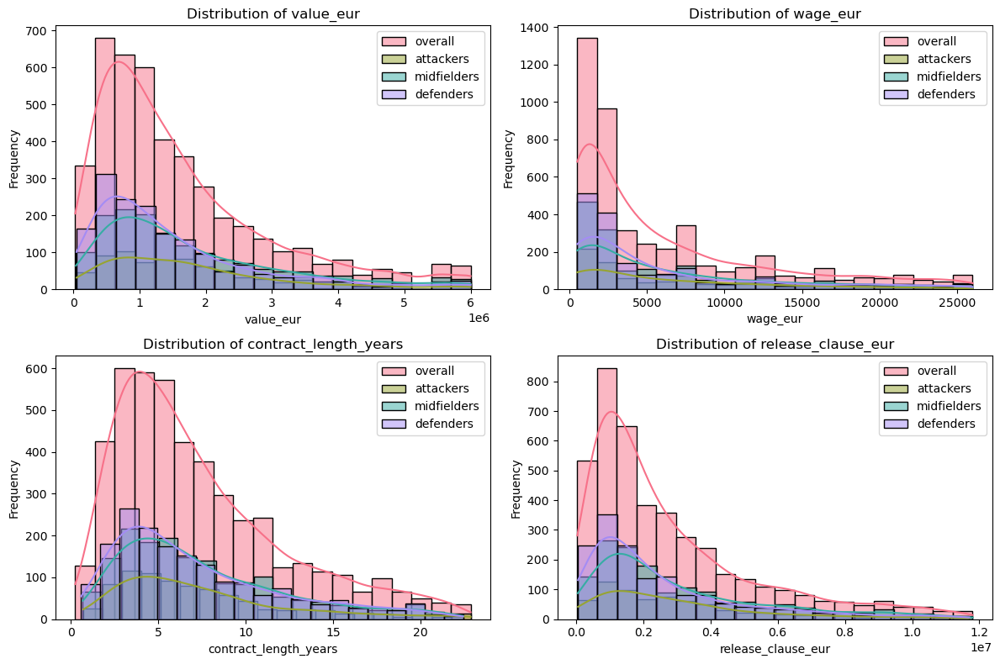

In [48]:
viz_df = df_train.loc[df_train.league_level == 1]

all_dfs = [viz_df, viz_df.loc[viz_df.position_type == 0], viz_df.loc[viz_df.position_type == 1], viz_df.loc[viz_df.position_type == 2]]
labels = ['overall','attackers','midfielders', 'defenders']

# now visualizing the new columns
plot_distributions_stacked(all_dfs, wage_cols,  labels=labels)


it looks like wage and release clause are particularly interesting for attackers, generally having higher wages and release clauses

midfielders have the most negative skew of wages

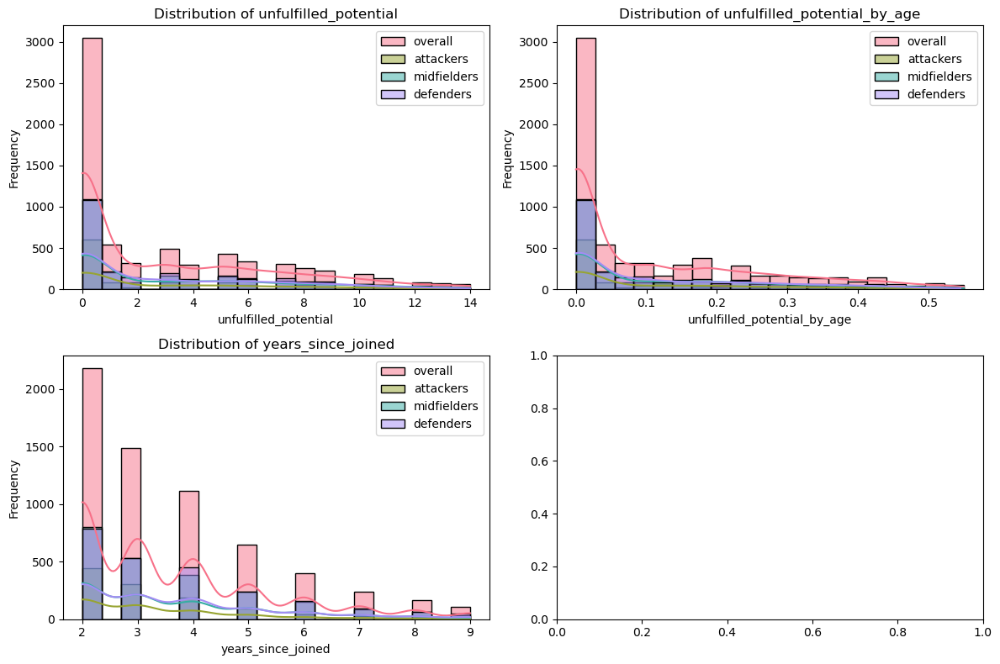

In [49]:
# trying some additional analysis with other engineered cols

eng_cols = ['unfulfilled_potential', 'unfulfilled_potential_by_age', 'years_since_joined']

df_train[eng_cols] = remove_outliers_iqr(df_train[eng_cols])

# now visualizing
all_dfs = [df_train, df_train.loc[df_train.position_type == 0], df_train.loc[df_train.position_type == 1], df_train.loc[df_train.position_type == 2]]
labels = ['overall','attackers','midfielders', 'defenders']

# now visualizing the new columns
plot_distributions_stacked(all_dfs, eng_cols,  labels=labels)


midfielders generally have the least unfulfilled potential which may mean it is the most competitive position


now lets collect all of the columns we have found to be useful

In [50]:
# save a copy of the dfs
_df_train = df_train.copy()
_df_test = df_test.copy()
_df_train_final = df_train.copy()
_df_test_final = df_test.copy()

_df_test_final_final = df_test.copy()

df_train.columns

Index(['overall', 'potential', 'value_eur', 'wage_eur', 'birthday_date',
       'height_cm', 'weight_kg', 'league_level', 'club_jersey_number',
       'club_joined', 'weak_foot', 'skill_moves', 'international_reputation',
       'work_rate', 'release_clause_eur', 'pace', 'shooting', 'passing',
       'dribbling', 'defending', 'physic', 'attacking_crossing',
       'attacking_finishing', 'attacking_heading_accuracy',
       'attacking_short_passing', 'attacking_volleys', 'skill_dribbling',
       'skill_curve', 'skill_fk_accuracy', 'skill_long_passing',
       'skill_ball_control', 'movement_acceleration', 'movement_sprint_speed',
       'movement_agility', 'movement_reactions', 'movement_balance',
       'power_shot_power', 'power_jumping', 'power_stamina', 'power_strength',
       'power_long_shots', 'mentality_aggression', 'mentality_interceptions',
       'mentality_positioning', 'mentality_vision', 'mentality_penalties',
       'mentality_composure', 'defending_marking_awareness',


In [51]:
all_cols = ['atk_wr', 'attacking_volleys', 'skill_curve', 'mentality_positioning', 'wage_eur', 'club_jersey_number', 'preferred_foot_right', 'skill_long_passing', 'weak_foot', 'mentality_aggression', 'dribbling', 'defending_standing_tackle', 'passing', 'bmi_age', 'skill_dribbling', 'release_clause_eur', 'unfulfilled_potential', 'defending_sliding_tackle', 'power_stamina', 'movement_balance', 'skill_fk_accuracy', 'def_wr', 'height_cm', 'attacking_heading_accuracy', 'power_long_shots', 'movement_acceleration', 'power_strength', 'weight_kg', 'mentality_interceptions', 'movement_agility', 'physic', 'mentality_vision', 'power_jumping', 'is_gk', 'attacking_short_passing', 'league_level', 'skill_moves', 'international_reputation', 'attacking_finishing', 'skill_ball_control', 'pace', 'age', 'mentality_penalties', 'attacking_crossing', 'shooting', 'defending', 'defending_marking_awareness', 'power_shot_power', 'movement_sprint_speed']

collected_cols = ['unfulfilled_potential','wage_eur','release_clause_eur','bmi_age', 'age', 'atk_wr', 'def_wr', 'club_jersey_number', 
'skill_moves', 'height_cm', 'weight_kg', 'mentality_vision', 'attacking_crossing', 'skill_fk_accuracy', 
'passing', 'attacking_short_passing', 'skill_long_passing',
'attacking_heading_accuracy', 'physic', 'attacking_finishing', 'attacking_volleys', 'defending_marking_awareness',
'defending_standing_tackle', 'defending_sliding_tackle', 'mentality_interceptions', 'mentality_penalties', 
'shooting', 'mentality_positioning','skill_curve', 'power_shot_power', 'power_long_shots', 'power_jumping', 
'power_strength','league_level', 'international_reputation','preferred_foot_right','is_gk']

print('diff in cols from original: ' + str(len(all_cols)-len(df_train.columns)))


diff in cols from original: -14


In [52]:
df_test = df_test[all_cols]
collected_cols_train = all_cols
collected_cols_train.append('position')
collected_cols_train.append('position_type')
df_train = df_train[collected_cols_train]
print(df_train.head())


        atk_wr  attacking_volleys  skill_curve  mentality_positioning  \
id                                                                      
216302       2                 41           64                     53   
237867       2                 31           36                     48   
253472       3                 37           56                     58   
223994       3                 70           48                     76   
251635       2                 46           53                     60   

        wage_eur  club_jersey_number  preferred_foot_right  \
id                                                           
216302   10000.0                  29                     1   
237867    2000.0                   4                     1   
253472    2000.0                  19                     0   
223994    5000.0                   9                     1   
251635    3000.0                  30                     0   

        skill_long_passing  weak_foot  mentality_aggr

now treating more outlier columns via observation

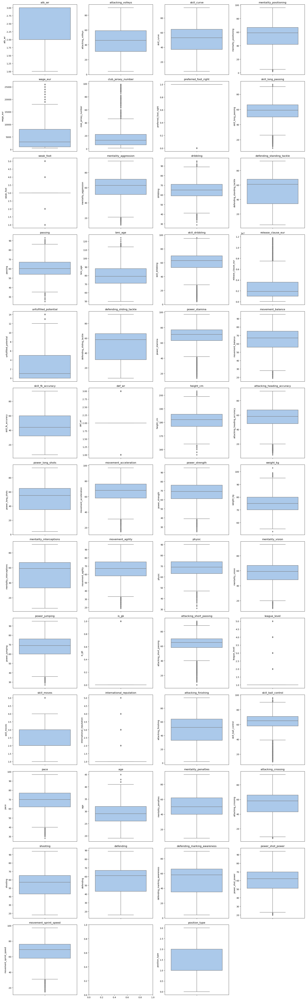

In [53]:
# We create a batch with a box plot for each column to see if there are any outliers.
# We can also see how the outliers are distributed, some of them are actually helpful but their interquartile range is just equal to 0.
# We will apply the outlier treatment to the rest of the features, excluding those which are dummies or labels.

# Define a color palette (you can customize this)
colors = sns.color_palette("pastel")

plots_per_row = 4
num_rows = (len(df_train.columns) + plots_per_row - 1) // plots_per_row
plt.figure(figsize=(plots_per_row * 5, num_rows * 5))

for i, column in enumerate(df_train.columns):
    plt.subplot(num_rows, plots_per_row, i + 1)
    
    # Check if the column is numeric before creating the boxplot
    if pd.api.types.is_numeric_dtype(df_train[column]):
        sns.boxplot(y=df_train[column], palette=colors)
        plt.title(column)

plt.tight_layout()
plt.show()

At this time I do not want to remove any additional outliers. We will now impute values for NaN treatment

# Impute Values

first we will check columns for NaN

In [54]:
train_na = df_train.isna().sum()
test_na = df_test.isna().sum()
nas_testrain = pd.concat([train_na, test_na], axis=1, keys=['Train', 'Test'])

display(nas_testrain[nas_testrain.sum(axis=1) > 0])

,Train,Test
wage_eur,767,0.0
dribbling,631,70.0
passing,631,70.0
release_clause_eur,1231,48.0
unfulfilled_potential,104,0.0
physic,631,70.0
pace,631,70.0
shooting,631,70.0
defending,631,70.0


In [55]:
NaN_cols = nas_testrain[nas_testrain.sum(axis=1) > 0].index

# Perform KNN imputation
imputer = KNNImputer(n_neighbors = 5)

imputed_temp_train = imputer.fit_transform(df_train[NaN_cols])
imputed_temp_test = imputer.fit_transform(df_test[NaN_cols])

# Convert the imputed data back to DataFrame
filled_df_train = pd.DataFrame(imputed_temp_train, columns=NaN_cols)
filled_df_test = pd.DataFrame(imputed_temp_test, columns=NaN_cols)

filled_df_train.index = df_train.index
filled_df_test.index = df_test.index

df_train[NaN_cols] = filled_df_train  
df_test[NaN_cols] = filled_df_test

/var/folders/d4/rcb0hfcs0bzgr7z0mw72lc_w0000gn/T/ipykernel_26057/3945907703.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_train[NaN_cols] = filled_df_train


In [56]:
train_na = df_train.isna().sum()
test_na = df_test.isna().sum()
nas_testrain = pd.concat([train_na, test_na], axis=1, keys=['Train', 'Test'])

display(nas_testrain[nas_testrain.sum(axis=1) > 0])

,Train,Test


0 NaN values in both datasets now

# Feature Scaling

potential to scale with regards to international_rep and/or league_level

 look at correlation map for an atk, def, pass, and wage metric

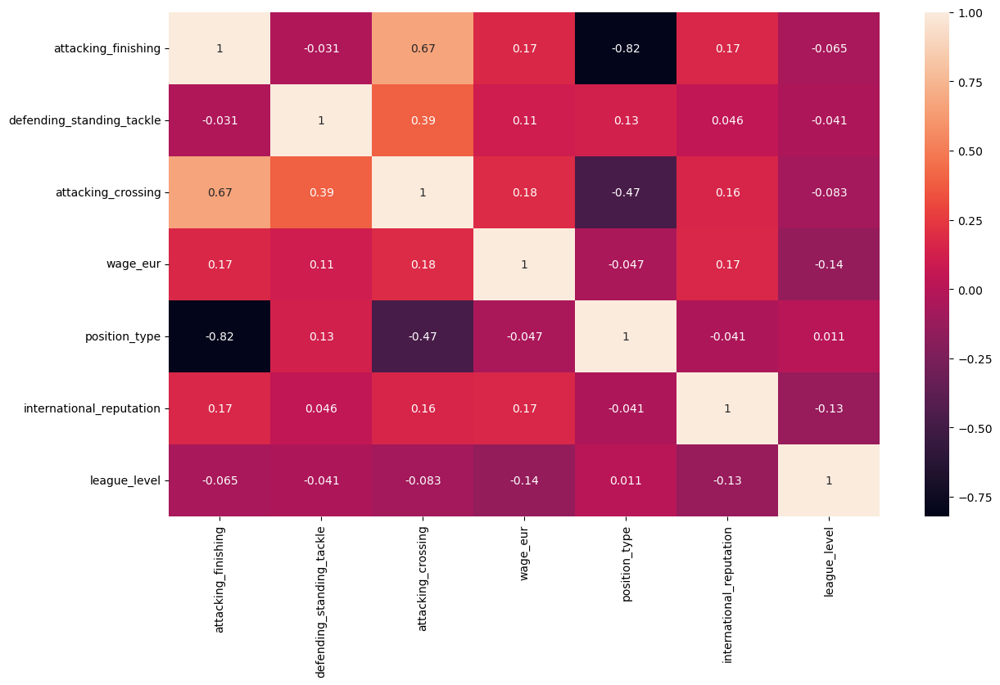

In [57]:
selected_columns = ['attacking_finishing', 'defending_standing_tackle','attacking_crossing','wage_eur','position_type','international_reputation','league_level']

plot_heat_map(df_train[selected_columns])

league level is highly correlated with wage so we could scale wage with respect to international reputation + league_level

lower league level is better - need to reverse the league level so a higher number is better

** just ended up scaling regularly for now


In [58]:
# define functions for section
def reverse_column_values(df, column_name):
    # Check if the column exists in the DataFrame
    if column_name not in df.columns:
        print(f"Column '{column_name}' not found in the DataFrame.")
        return df

    # Get the minimum and maximum values of the column
    min_value = df[column_name].min()
    max_value = df[column_name].max()

    # Reverse the values of the column
    df[column_name] = max_value - df[column_name] + min_value

    return df



def scale_column(df, column_names):
    for column_name in column_names:
        # Check if the column exists in the DataFrame
        if column_name not in df.columns:
            print(f"Column '{column_name}' not found in the DataFrame.")
            return df

        # Extract the column values and reshape to a 2D array
        column_values = df[column_name].values.reshape(-1, 1)

        # Use StandardScaler to scale the column values
        scaler = StandardScaler()
        scaled_values = scaler.fit_transform(column_values)

        # Update the DataFrame with scaled values
        df.loc[:,column_name] = scaled_values.flatten()

    return df


In [59]:
cols_to_scale = ['unfulfilled_potential', 'wage_eur', 'release_clause_eur', 'bmi_age',
       'age',  'skill_moves', 'height_cm', 'weight_kg', 'mentality_vision', 'attacking_crossing',
       'skill_fk_accuracy', 'passing', 'attacking_short_passing',
       'skill_long_passing', 'attacking_heading_accuracy', 'physic',
       'attacking_finishing', 'attacking_volleys',
       'defending_marking_awareness', 'defending_standing_tackle',
       'defending_sliding_tackle', 'mentality_interceptions',
       'mentality_penalties', 'shooting', 'mentality_positioning',
       'skill_curve', 'power_shot_power', 'power_long_shots', 'power_jumping',
       'power_strength']

df_train = scale_column(df_train, cols_to_scale)
df_test = scale_column(df_test, cols_to_scale)
display(df_train.head())

,atk_wr,attacking_volleys,skill_curve,mentality_positioning,wage_eur,club_jersey_number,preferred_foot_right,skill_long_passing,weak_foot,mentality_aggression,...,age,mentality_penalties,attacking_crossing,shooting,defending,defending_marking_awareness,power_shot_power,movement_sprint_speed,position,position_type
id,,,,,,,,,,,,,,,,,,,,,
216302,2,-0.210520,0.740170,-0.006699,0.668213,29,1,0.085445,5,56,...,0.879938,0.518231,0.623435,-0.220976,67.0,0.698032,0.495301,70,LB,2
237867,2,-0.769556,-0.785564,-0.265602,-0.668136,4,1,0.509239,3,66,...,-0.506950,-0.247934,-0.162197,-1.204788,63.0,0.698032,-0.878340,65,LDM,1
253472,3,-0.434135,0.304246,0.252205,-0.668136,19,0,-0.126452,3,69,...,-1.662691,-1.205640,0.342852,-1.415604,59.0,0.443617,-0.802027,77,LWB,2
223994,3,1.410685,-0.131678,1.184257,-0.167005,9,1,-0.832775,3,52,...,0.417642,1.603630,-1.172295,1.325014,24.0,-1.795240,0.800555,66,LS,0
251635,2,0.068998,0.140774,0.355766,-0.501093,30,0,-0.126452,2,53,...,0.879938,0.135148,0.623435,-0.150704,61.0,0.647149,0.876868,76,LB,2


# First Model Development

We will try an initial model to predict the player position whether a forward defense or midfielder

we are choosing a XGBoost model because of its ability to deal with complexity in iterative tree weighting based on the marginal differences between classes we identify throughout the EDA process. The boosting that xgb uses iteratively trains multiple models and makes better decisions based on the errors of the previous model which is better when there is more complexity vs having 1 model that retrains on the same data. 

we alternatively choose a tpot model autoML technique to optimize a RandomForestClassifier. We choose the radnom forest classifier to get an idea of how the bagging technique works on our data. The bagging technique resamples different parts of the same data to get validation on decision metrics. 1 model multiple validations of decisions. 

In [60]:
# first we separate out the goalkeepers

train_gk = df_train.loc[df_train.is_gk == 1]
df_train = df_train.loc[df_train.is_gk == 0]
test_gk = df_test.loc[df_test.is_gk == 1]
df_test = df_test.loc[df_test.is_gk == 0]


now we create our training and test datasets

In [61]:
# X training data
X = df_train.loc[:, ~df_train.columns.isin(['position', 'position_type'])]
y = df_train.loc[:, 'position_type']

# split data set
X_train_general, X_test_general, y_train_general, y_test_general = train_test_split(X, y, test_size=0.2, random_state=168)

now we run a random search model

In [62]:
# Define the XGBoost model
xgb_model = xgb.XGBClassifier()

# Define the parameter grid for random search
param_dist = {
    'n_estimators': [10,20,40,50,60,70,80,90,100, 200, 300, 400,500,600,700,800,900],
    'learning_rate': [0.01, 0.05, 0.1, 0.2],
    'max_depth': [3, 5, 6, 10],
    'min_child_weight': [1, 3, 5, 7],
    'subsample': [0.5, 0.75, 1.0],
    'colsample_bytree': [0.3, 0.5, 0.7, 1.0]
}

# Define the RandomizedSearchCV object
random_search_player_type = RandomizedSearchCV(
    xgb_model, param_distributions=param_dist, n_iter=10, scoring=f1_scorer, cv=5, random_state = 168
)

# Fit the RandomizedSearchCV object to the data
random_search_player_type.fit(X_train_general, y_train_general)

# Print the best parameters and corresponding accuracy
print("Best Parameters: ", random_search_player_type.best_params_)
print("Best Accuracy: ", random_search_player_type.best_score_)

# Evaluate the best model on the test set
best_model = random_search_player_type.best_estimator_
test_accuracy = best_model.score(X_test_general, y_test_general)
print("Test Accuracy: ", test_accuracy)

Best Parameters:  {'subsample': 0.75, 'n_estimators': 700, 'min_child_weight': 7, 'max_depth': 3, 'learning_rate': 0.05, 'colsample_bytree': 0.7}
Best Accuracy:  0.8571771541907311
Test Accuracy:  0.8411811652035116


now we check the results create a y_prediction on the test dataset and run accuracy metrics

Confusion matrix:
 [[165  79   3]
 [ 43 424  36]
 [  2  36 465]]


/var/folders/d4/rcb0hfcs0bzgr7z0mw72lc_w0000gn/T/ipykernel_26057/3968810248.py:11: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels([''] + labels)
/var/folders/d4/rcb0hfcs0bzgr7z0mw72lc_w0000gn/T/ipykernel_26057/3968810248.py:12: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels([''] + labels)


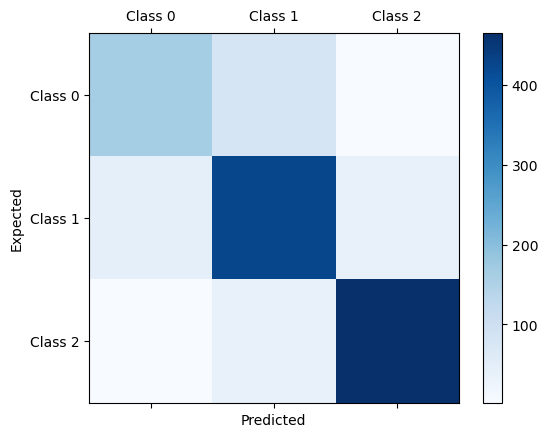

In [63]:
y_pred = random_search_player_type.predict(X_test_general)

conf_mat = confusion_matrix(y_true=y_test_general, y_pred=y_pred)
print('Confusion matrix:\n', conf_mat)

labels = ['Class 0', 'Class 1', 'Class 2', 'Class 3']
fig = plt.figure()
ax = fig.add_subplot(111)
cax = ax.matshow(conf_mat, cmap=plt.cm.Blues)
fig.colorbar(cax)
ax.set_xticklabels([''] + labels)
ax.set_yticklabels([''] + labels)
plt.xlabel('Predicted')
plt.ylabel('Expected')
plt.show()

pretty good results but we can try with resampling

In [64]:

# X training data
X = df_train.loc[:, ~df_train.columns.isin(['position', 'position_type'])]
y = df_train.loc[:, 'position_type']


# Initialize SMOTE (Synthetic Minority Over-sampling Technique)
smote = SMOTE(sampling_strategy='auto', random_state = 168)

# Fit and transform the data using SMOTE to perform over-sampling
X_resampled, y_resampled = smote.fit_resample(X, y)

# split data set
X_train_general, X_test_general, y_train_general, y_test_general = train_test_split(X_resampled, y_resampled, test_size=0.2, random_state=168)


In [65]:
# Define the XGBoost model
xgb_model = xgb.XGBClassifier()

# Define the parameter grid for random search
param_dist = {
    'n_estimators': [10,20,40,50,60,70,80,90,100, 200, 300, 400,500,600,700,800,900],
    'learning_rate': [0.01, 0.05, 0.1, 0.2],
    'max_depth': [3, 5, 6, 10],
    'min_child_weight': [1, 3, 5, 7],
    'subsample': [0.5, 0.75, 1.0],
    'colsample_bytree': [0.3, 0.5, 0.7, 1.0]
}

# Define the RandomizedSearchCV object
random_search_player_type = RandomizedSearchCV(
    xgb_model, param_distributions=param_dist, n_iter=10, scoring=f1_scorer, cv=5, random_state = 168
)

# Fit the RandomizedSearchCV object to the data
random_search_player_type.fit(X_train_general, y_train_general)

tpot.fit(X_train_general, y_train_general)

# Define the RandomizedSearchCV object
random_search_player_type_tpot = tpot.fitted_pipeline_

# Print the best parameters and corresponding accuracy
print("Best Parameters: ", random_search_player_type.best_params_)
print("Best Accuracy: ", random_search_player_type.best_score_)

# Evaluate the best model on the test set
best_model = random_search_player_type.best_estimator_
test_accuracy = best_model.score(X_test_general, y_test_general)
print("Test Accuracy: ", test_accuracy)

Optimization Progress:   0%|          | 0/210 [00:00<?, ?pipeline/s]


Generation 1 - Current best internal CV score: 0.8646790627108739

Generation 2 - Current best internal CV score: 0.8656859826945438

Generation 3 - Current best internal CV score: 0.8656859826945438

Generation 4 - Current best internal CV score: 0.8675361496977232

Generation 5 - Current best internal CV score: 0.8695198354297929

Generation 6 - Current best internal CV score: 0.8695198354297929

Generation 7 - Current best internal CV score: 0.8695198354297929

Generation 8 - Current best internal CV score: 0.8714299837747582

Generation 9 - Current best internal CV score: 0.8714299837747582

Generation 10 - Current best internal CV score: 0.8714299837747582

Generation 11 - Current best internal CV score: 0.8714299837747582

Generation 12 - Current best internal CV score: 0.8714299837747582

Generation 13 - Current best internal CV score: 0.8718070895474648

Generation 14 - Current best internal CV score: 0.8718070895474648

Generation 15 - Current best internal CV score: 0.871807

Confusion matrix:
 [[458  48   1]
 [ 57 413  43]
 [  3  42 473]]


/var/folders/d4/rcb0hfcs0bzgr7z0mw72lc_w0000gn/T/ipykernel_26057/3968810248.py:11: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels([''] + labels)
/var/folders/d4/rcb0hfcs0bzgr7z0mw72lc_w0000gn/T/ipykernel_26057/3968810248.py:12: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels([''] + labels)


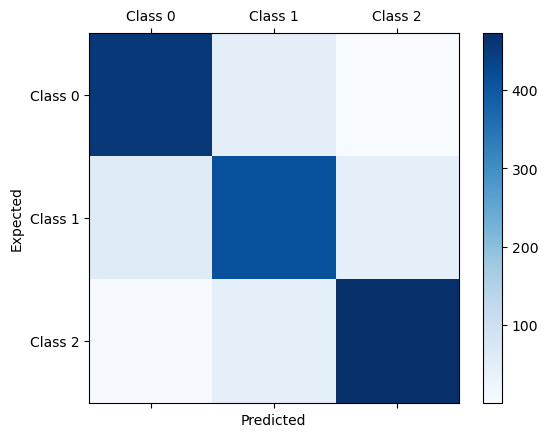

In [66]:
y_pred = random_search_player_type.predict(X_test_general)

conf_mat = confusion_matrix(y_true=y_test_general, y_pred=y_pred)
print('Confusion matrix:\n', conf_mat)

labels = ['Class 0', 'Class 1', 'Class 2', 'Class 3']
fig = plt.figure()
ax = fig.add_subplot(111)
cax = ax.matshow(conf_mat, cmap=plt.cm.Blues)
fig.colorbar(cax)
ax.set_xticklabels([''] + labels)
ax.set_yticklabels([''] + labels)
plt.xlabel('Predicted')
plt.ylabel('Expected')
plt.show()

There is a good model predicting the position atk, mid, def. Now we need to see understand the data for each position.the idea is to now look at each position regardless of the side of the field they play on. wings as wings, backs as backs, midfielders as midfielders. 

# Second Model Analysis

we start looking at the individual player positions within the atk category

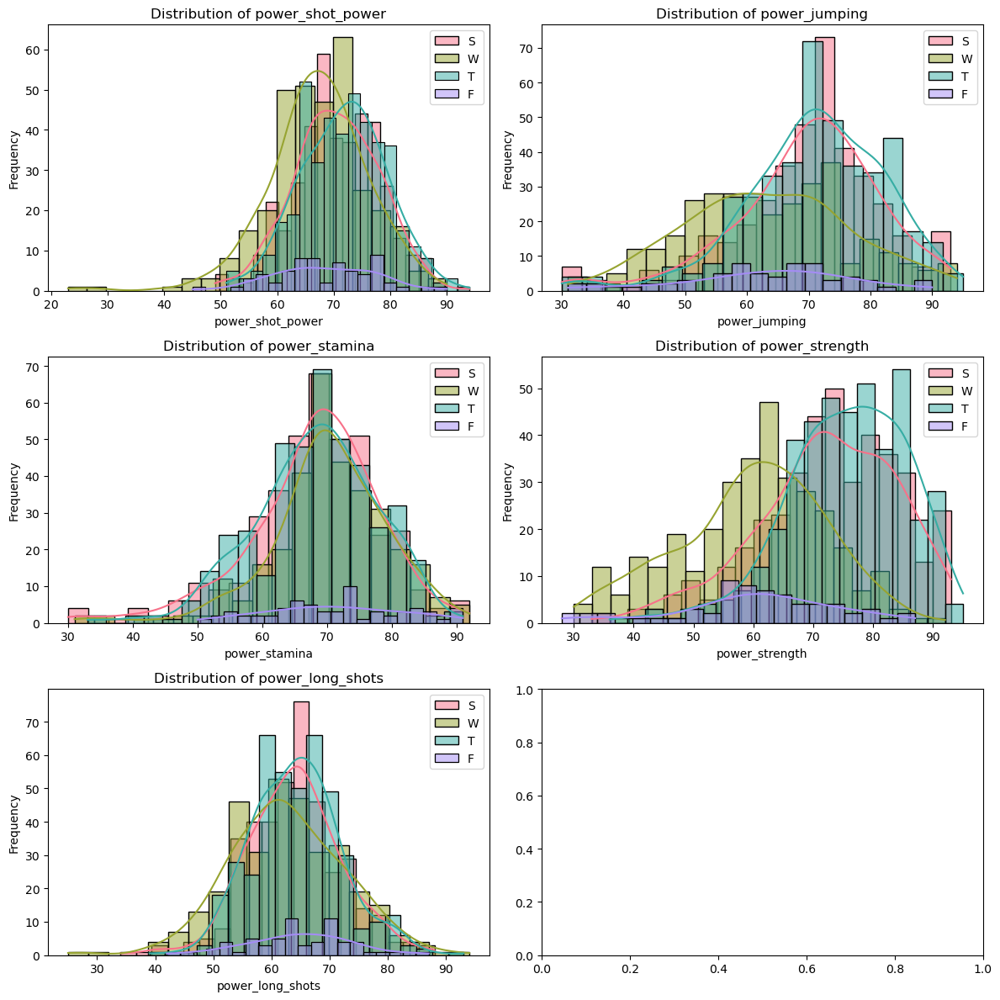

In [67]:
# first we look at the attackers

attackers = _df_train.loc[_df_train.position_type == 0].copy()

all_dfs = []
labels = []

# remove the side of the field
attackers['position_simple'] = attackers.position.str[-1]

for position in attackers.position_simple.unique():
    all_dfs.append(attackers.loc[attackers.position_simple == position])
    labels.append(position)


plot_distributions_stacked(all_dfs, ['power_shot_power',
       'power_jumping', 'power_stamina', 'power_strength', 'power_long_shots'],  labels=labels)


wings have lower jump and strength also shot power is slightly lower

forwards also seem to have lower jump and strength

'power_shot_power', 'power_jumping', 'power_strength'

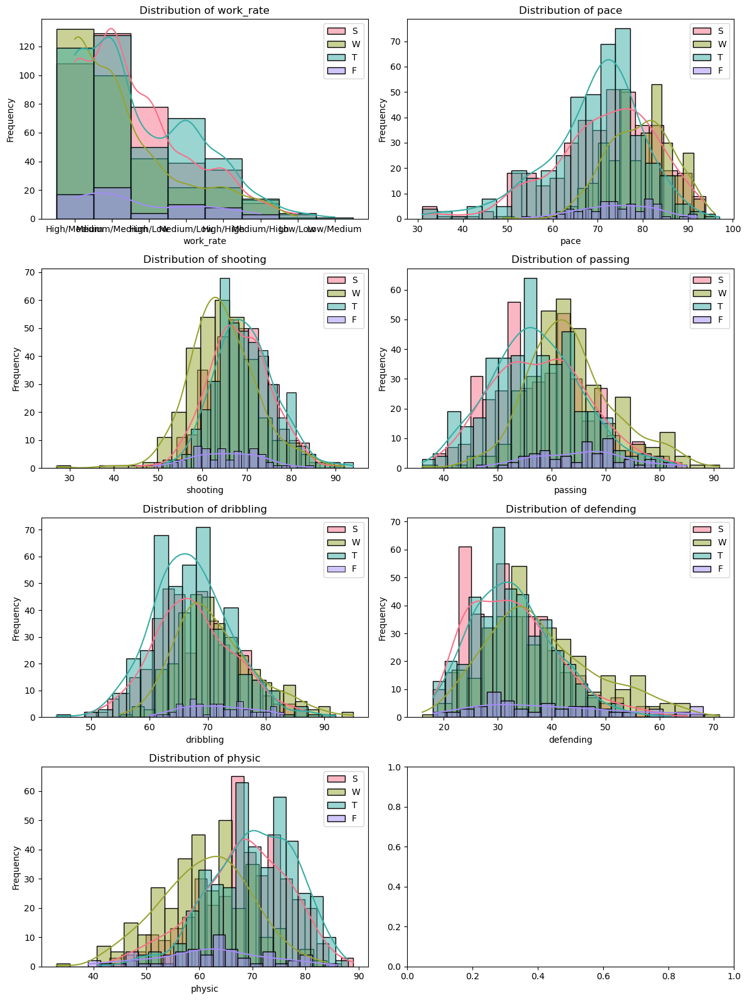

In [68]:
plot_distributions_stacked(all_dfs, ['work_rate',  'pace',
   'shooting', 'passing', 'dribbling', 'defending', 'physic'],  labels=labels)

shooting, passing, physic, pace

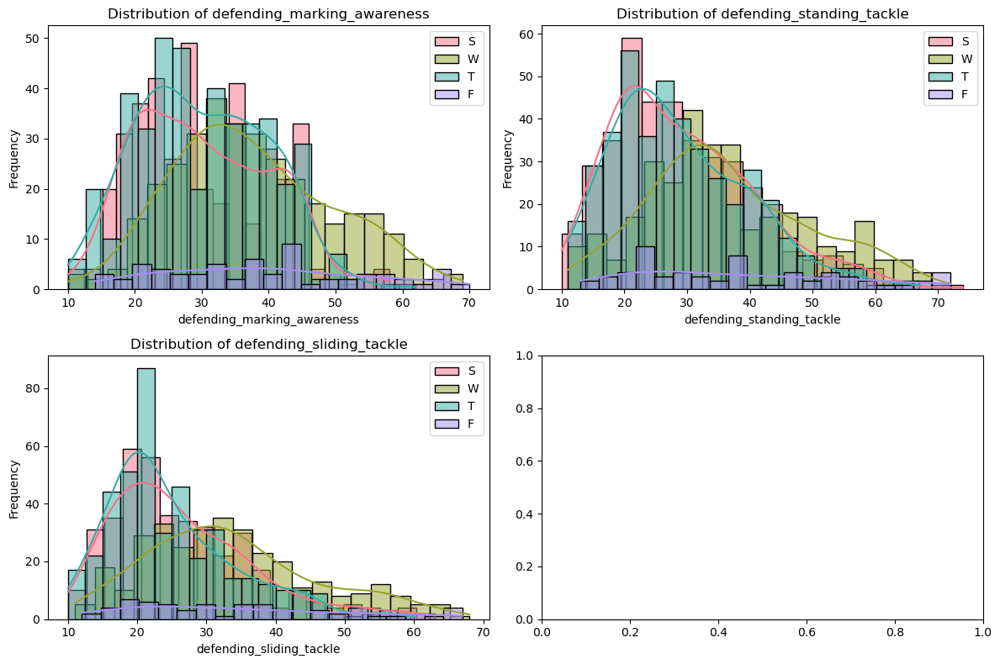

In [69]:

plot_distributions_stacked(all_dfs, ['defending_marking_awareness',
   'defending_standing_tackle', 'defending_sliding_tackle'],  labels=labels)

'defending_marking_awareness','defending_standing_tackle', 'defending_sliding_tackle'

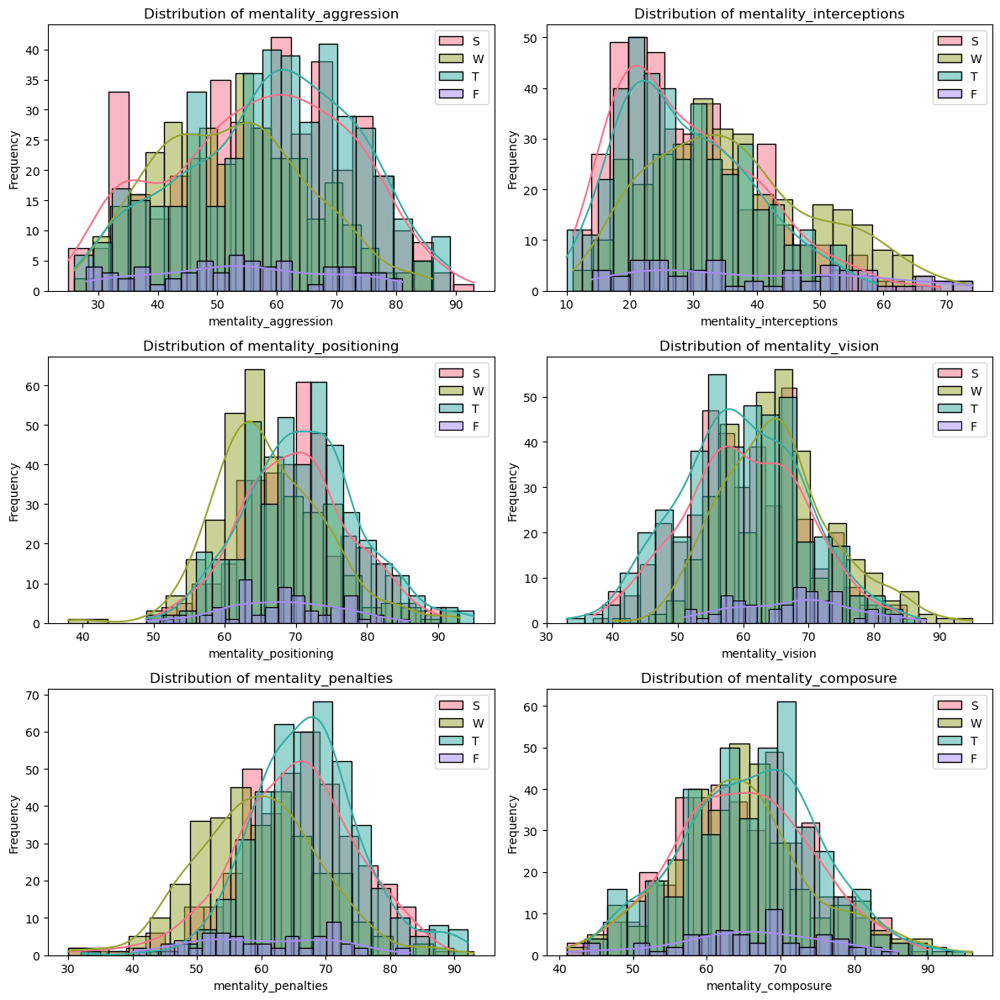

In [70]:
plot_distributions_stacked(all_dfs, ['mentality_aggression', 'mentality_interceptions',
   'mentality_positioning', 'mentality_vision', 'mentality_penalties',
   'mentality_composure'],  labels=labels)

'mentality_aggression', 'mentality_interceptions','mentality_positioning','mentality_penalties',

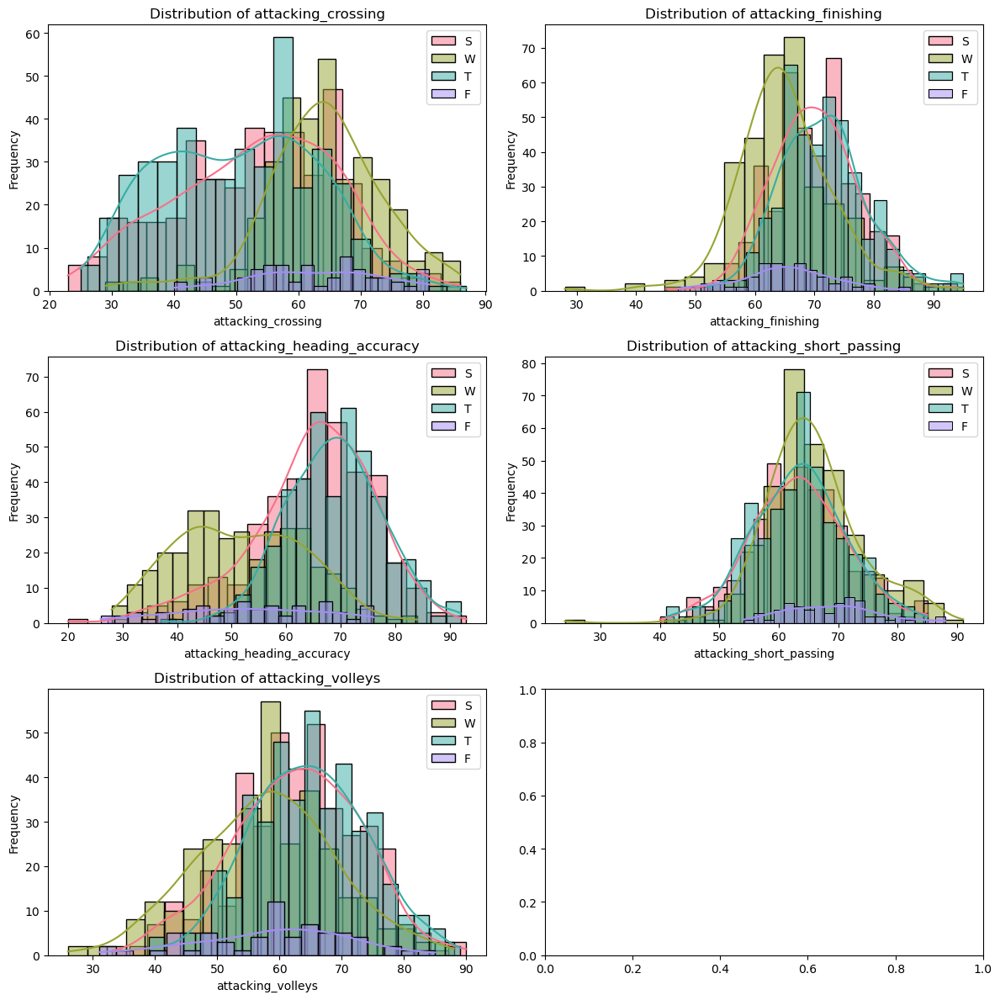

In [71]:
plot_distributions_stacked(all_dfs, ['attacking_crossing', 'attacking_finishing',
   'attacking_heading_accuracy', 'attacking_short_passing',
   'attacking_volleys'],  labels=labels)

'attacking_crossing', 'attacking_heading_accuracy'

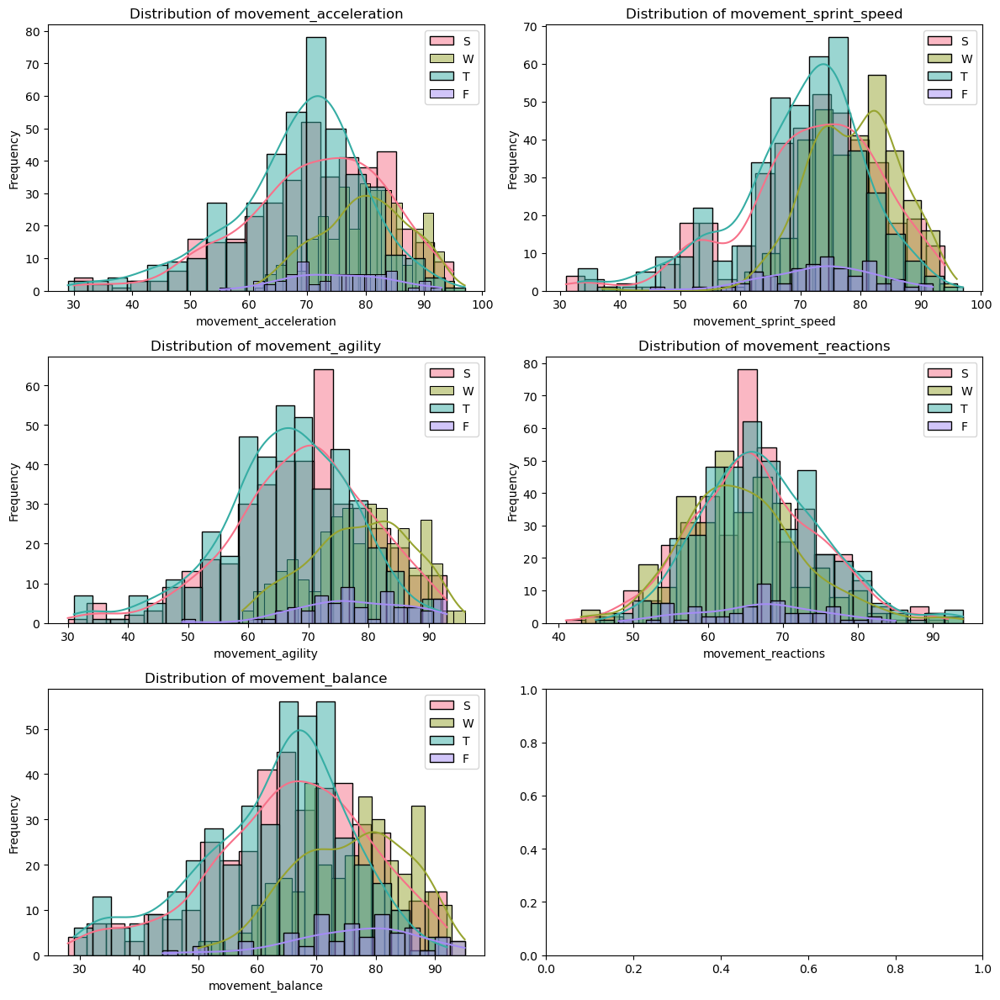

In [72]:
plot_distributions_stacked(all_dfs, ['movement_acceleration', 'movement_sprint_speed', 'movement_agility',
   'movement_reactions', 'movement_balance'],  labels=labels)

'movement_acceleration', 'movement_agility', 'movement_balance'

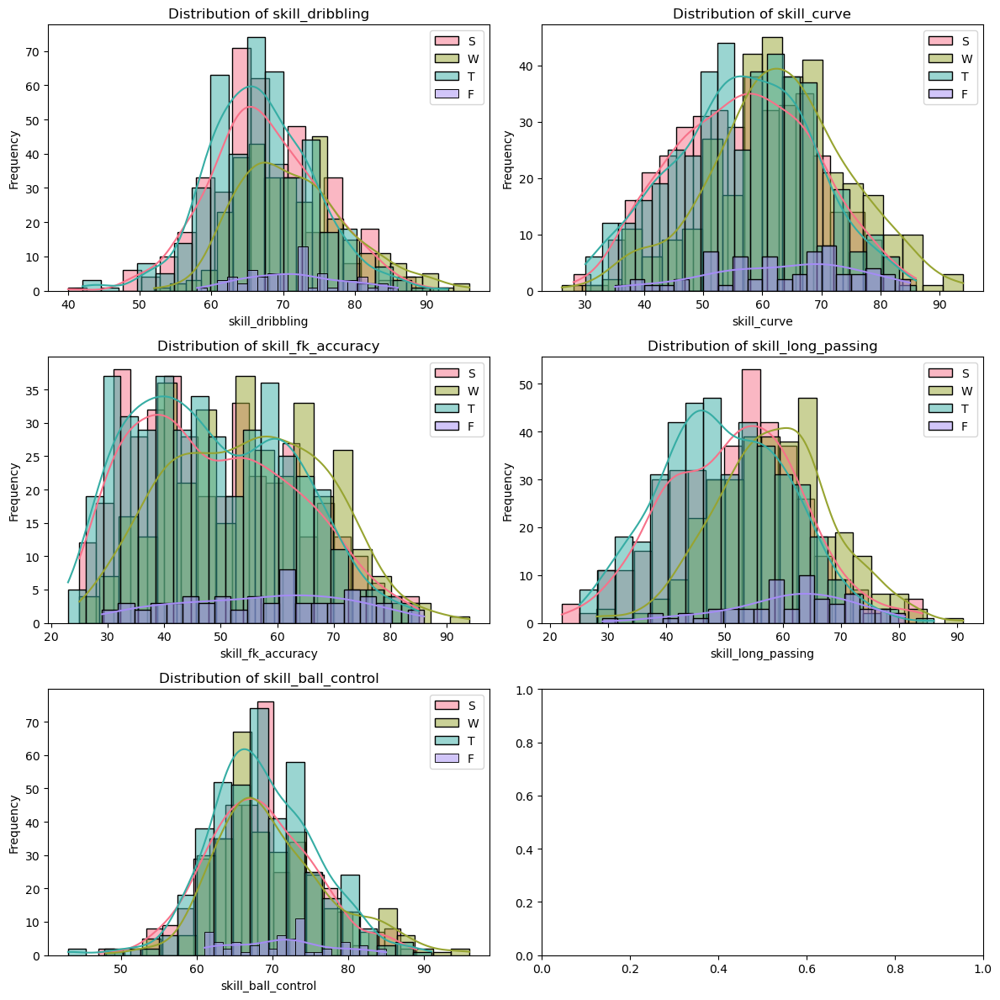

In [73]:
plot_distributions_stacked(all_dfs, ['skill_dribbling', 'skill_curve',
   'skill_fk_accuracy', 'skill_long_passing', 'skill_ball_control'],  labels=labels)

 'skill_curve','skill_fk_accuracy', 'skill_long_passing'

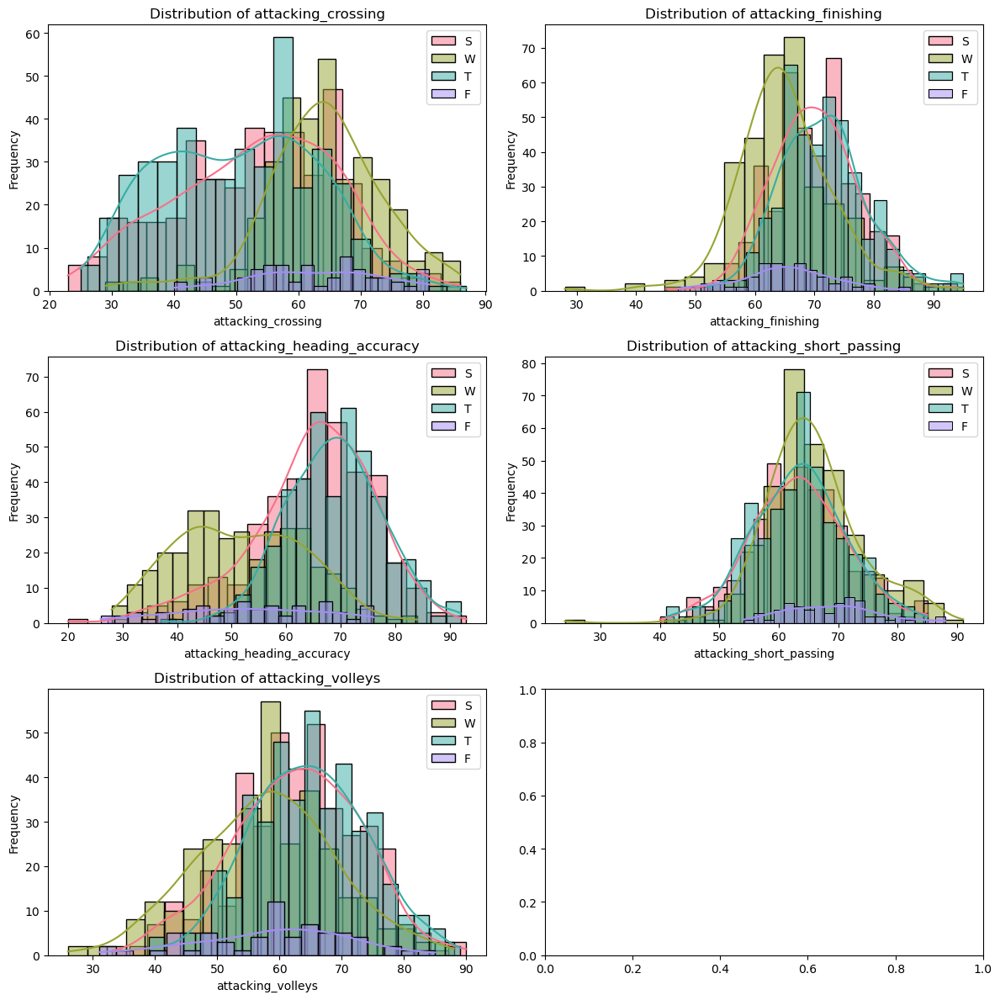

In [74]:

plot_distributions_stacked(all_dfs, ['attacking_crossing', 'attacking_finishing',
   'attacking_heading_accuracy', 'attacking_short_passing',
   'attacking_volleys'],  labels=labels)


'attacking_crossing','attacking_heading_accuracy'

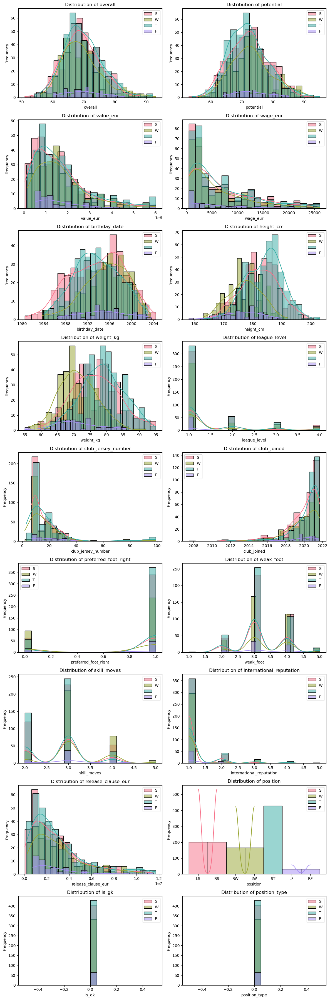

In [75]:
non_skill_cols = ['overall', 'potential', 'value_eur', 'wage_eur', 'birthday_date',
       'height_cm', 'weight_kg', 'league_level', 'club_jersey_number',
       'club_joined', 'preferred_foot_right', 'weak_foot', 'skill_moves',
       'international_reputation',  'release_clause_eur', 'position',
       'is_gk', 'position_type']

plot_distributions_stacked(all_dfs, non_skill_cols,  labels=labels)

'height_cm', 'weight_kg'

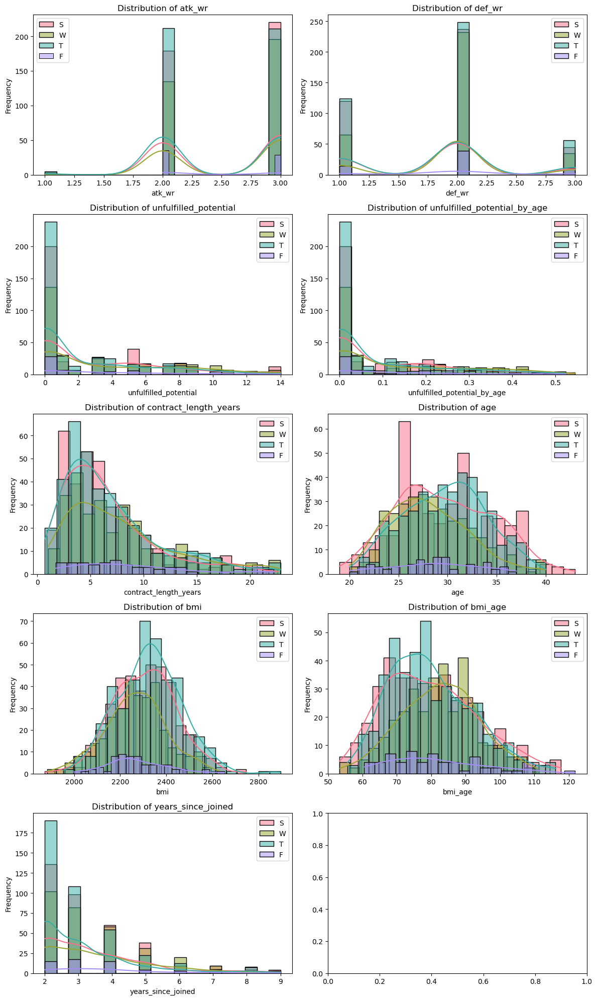

In [76]:
new_feature_cols = ['atk_wr','def_wr','unfulfilled_potential', 'unfulfilled_potential_by_age', 'contract_length_years', 'age', 'bmi', 'bmi_age', 'years_since_joined']

plot_distributions_stacked(all_dfs, new_feature_cols,  labels=labels)

bmi_age

<b>takeaway columns</b>
'power_shot_power', 'power_jumping', 'power_strength',
'shooting', 'passing', 'physic', 'pace',
'defending_marking_awareness','defending_standing_tackle', 'defending_sliding_tackle',
'mentality_aggression', 'mentality_interceptions','mentality_positioning','mentality_penalties',
'attacking_crossing', 'attacking_heading_accuracy',
'movement_acceleration', 'movement_agility', 'movement_balance','skill_curve','skill_fk_accuracy', 
'skill_long_passing','attacking_crossing','attacking_heading_accuracy',
'height_cm', 'weight_kg', 'bmi_age'

then store the attacker columns

In [77]:
attacker_cols = ['power_shot_power', 'power_jumping', 'power_strength',
'shooting', 'passing', 'physic', 'pace',
'defending_marking_awareness','defending_standing_tackle', 'defending_sliding_tackle',
'mentality_aggression', 'mentality_interceptions','mentality_positioning','mentality_penalties',
'attacking_crossing', 'attacking_heading_accuracy',
'movement_acceleration', 'movement_agility', 'movement_balance','skill_curve','skill_fk_accuracy', 
'skill_long_passing','attacking_crossing','attacking_heading_accuracy',
'height_cm', 'weight_kg', 'bmi_age']

Then we analyze the midfielders

In [78]:
# then we look at the midfielders


midfielders = _df_train.loc[_df_train.position_type == 1].copy()

all_dfs = []
labels = []

midfielders['position_simple'] = midfielders.loc[midfielders.position.str.len() == 3].position.str[-2:]
midfielders['position_simple'] = midfielders['position_simple'].fillna('M')

for position in midfielders.position_simple.unique():
    all_dfs.append(midfielders.loc[midfielders.position_simple == position])
    labels.append(position)


labels

['DM', 'CM', 'M', 'AM']

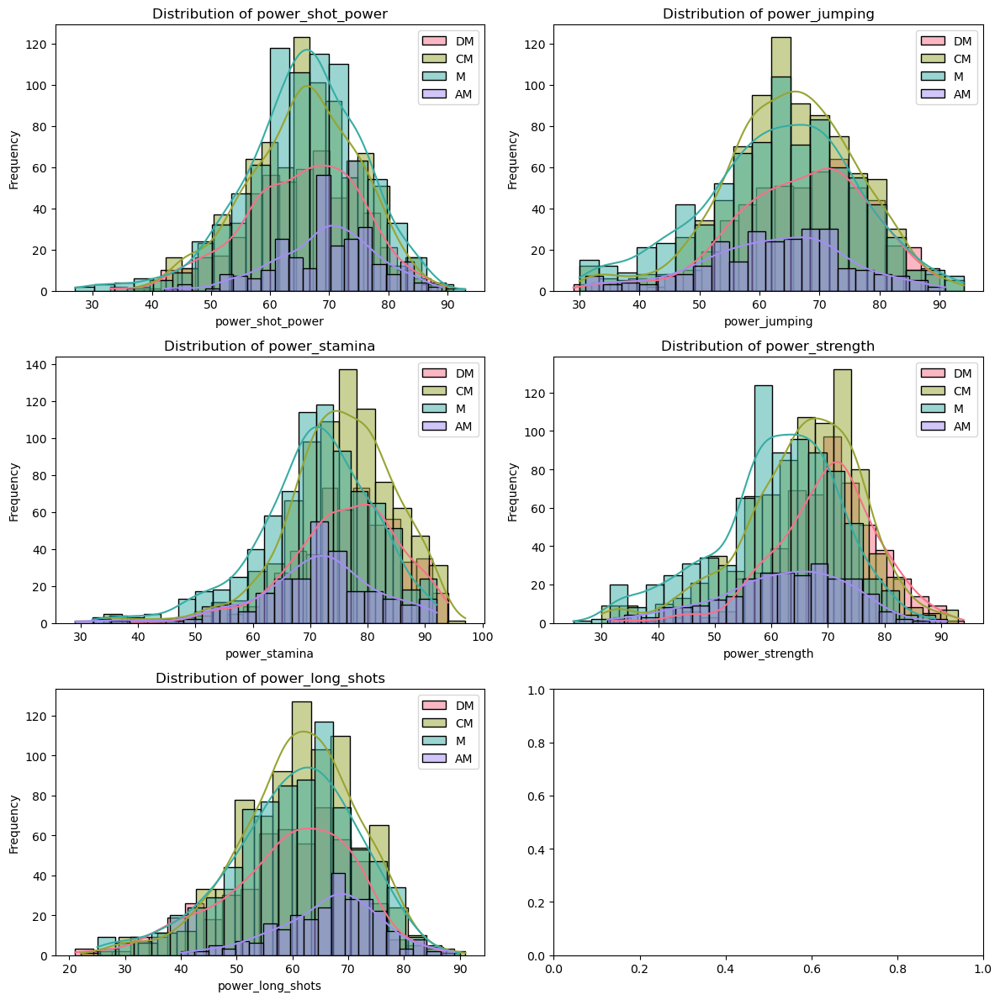

In [79]:

plot_distributions_stacked(all_dfs, ['power_shot_power',
       'power_jumping', 'power_stamina', 'power_strength', 'power_long_shots'],  labels=labels)


center and defensive midfielders have slightly more stamina and strength


<b>takeaway columns</b>
'power_stamina', 'power_strength'

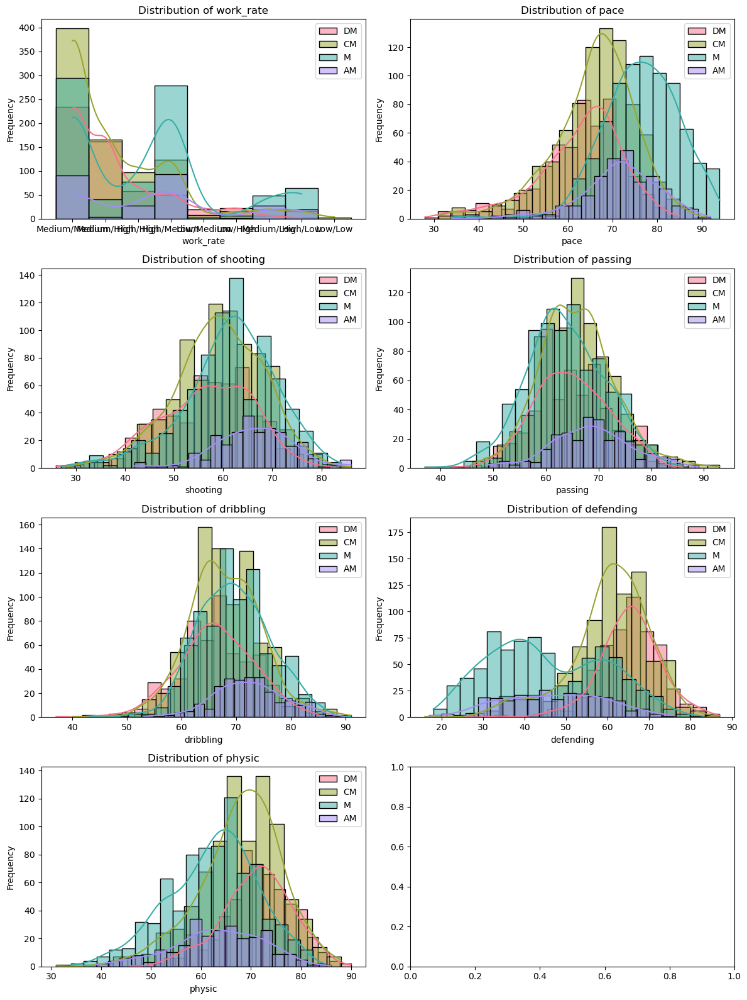

In [80]:
plot_distributions_stacked(all_dfs, ['work_rate',  'pace',
   'shooting', 'passing', 'dribbling', 'defending', 'physic'],  labels=labels)

midfielders are the fastest

attack midfielders have the best shooting and dribbling

center midfielders have a slight skew towards passing

midfielders are bad defenders


<b>takeaway columns</b>
'pace','shooting', 'passing', 'dribbling', 'defending'

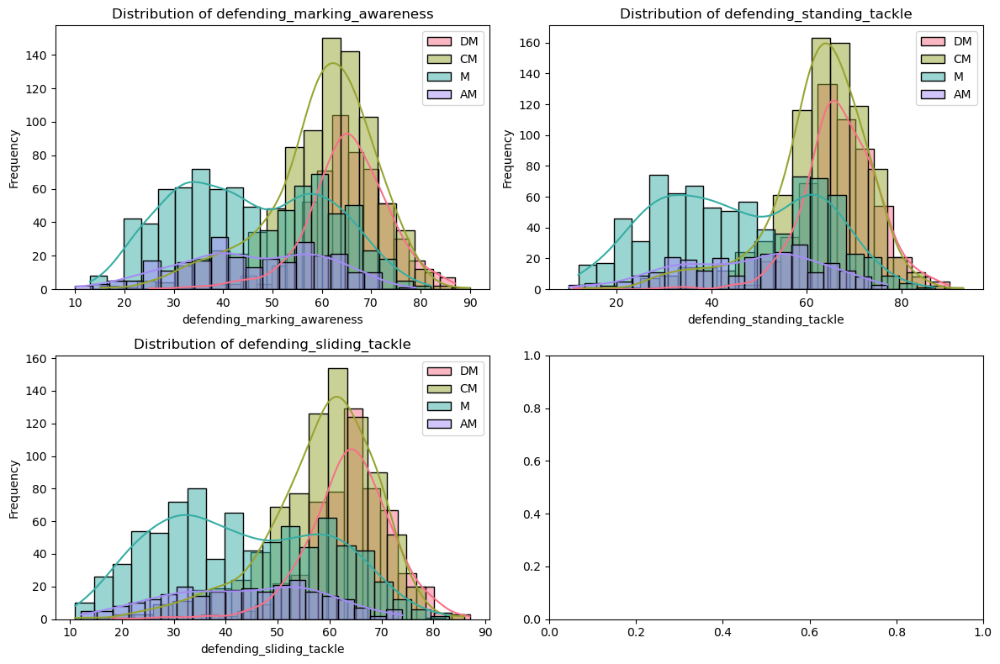

In [81]:

plot_distributions_stacked(all_dfs, ['defending_marking_awareness',
   'defending_standing_tackle', 'defending_sliding_tackle'],  labels=labels)

midfielders and attack midfielders are somewhat unskilled at defending


'defending_marking_awareness','defending_standing_tackle', 'defending_sliding_tackle'

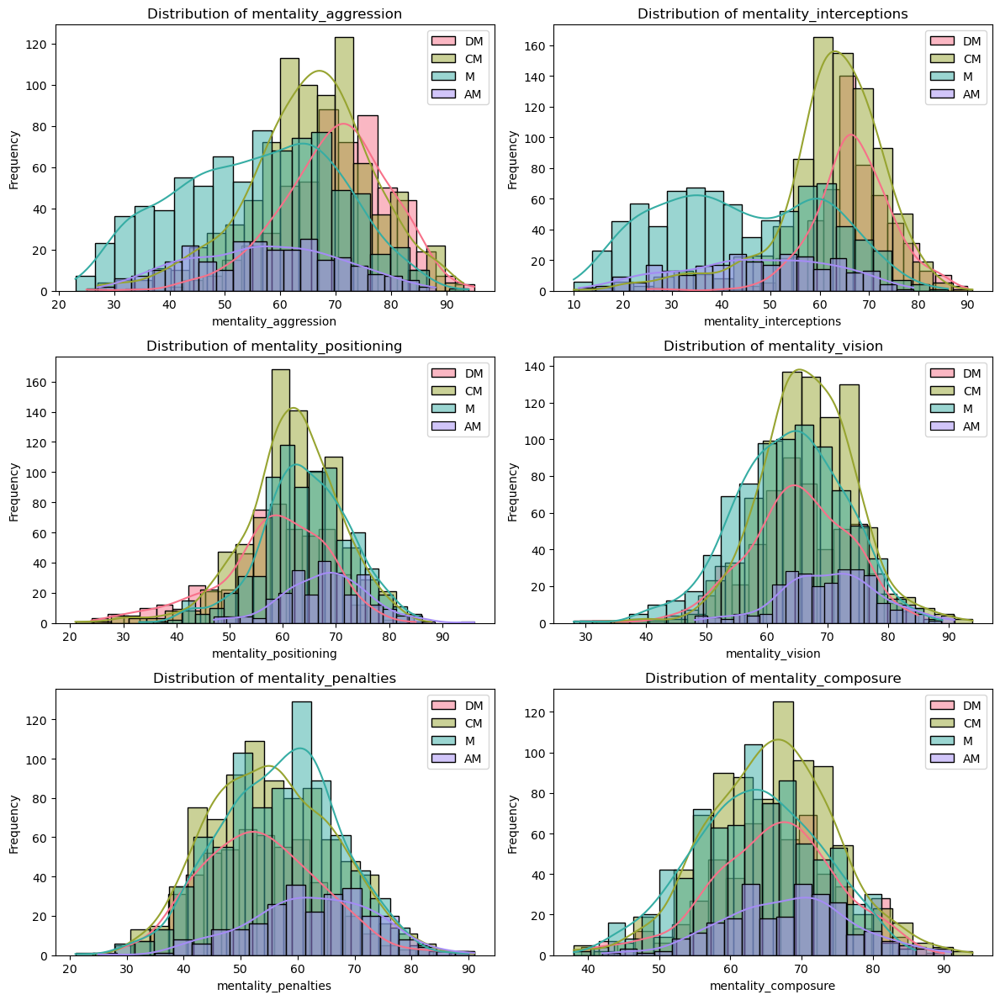

In [82]:
plot_distributions_stacked(all_dfs, ['mentality_aggression', 'mentality_interceptions',
   'mentality_positioning', 'mentality_vision', 'mentality_penalties',
   'mentality_composure'],  labels=labels)

midfielders have more interception and aggression skills

defensive and center midfielders are slightly worse at penalties

center midfielders have the best vision


<b>takeaway columns</b>
'mentality_aggression', 'mentality_interceptions','mentality_positioning', 'mentality_vision', 'mentality_penalties'

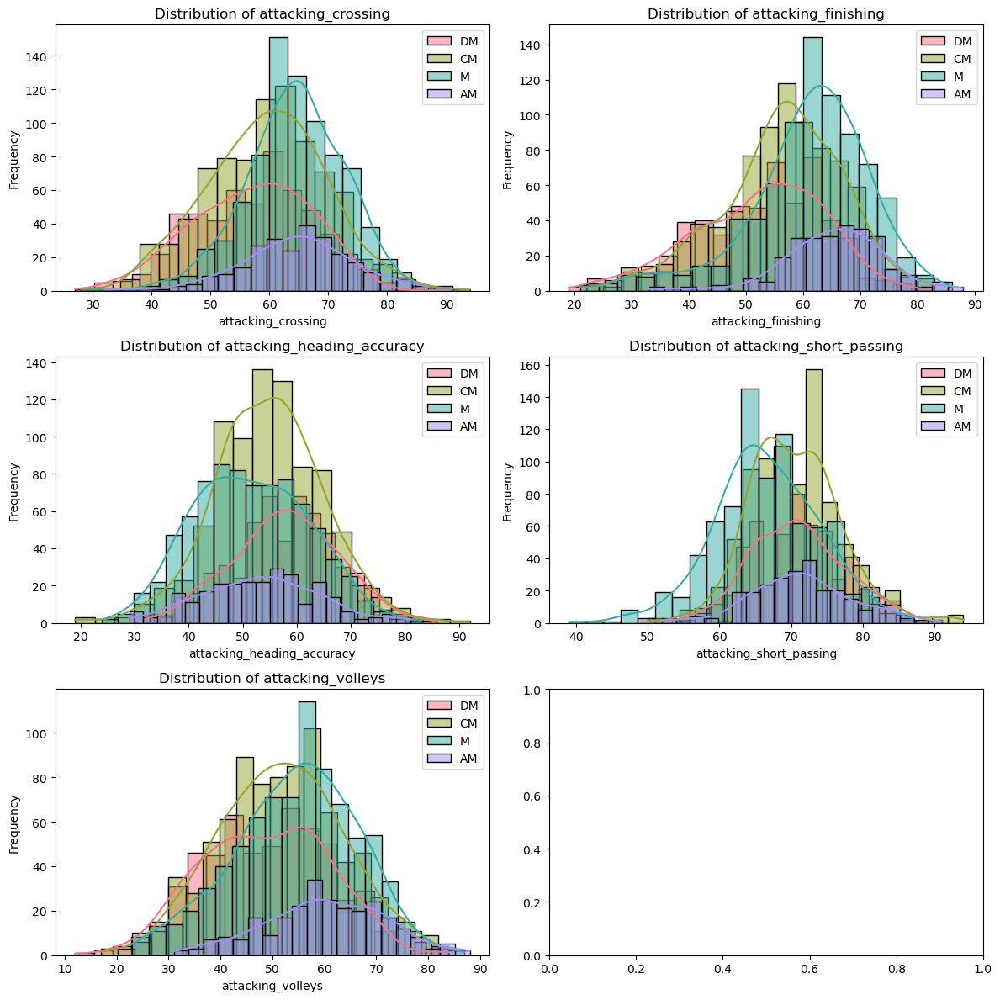

In [83]:
plot_distributions_stacked(all_dfs, ['attacking_crossing', 'attacking_finishing',
   'attacking_heading_accuracy', 'attacking_short_passing',
   'attacking_volleys'],  labels=labels)

midfielders and attack midfielders are better at finishing, volleys, and crossing

center midfielders are better at short passing


<b>takeaway columns</b>

'attacking_crossing', 'attacking_finishing','attacking_heading_accuracy', 'attacking_short_passing','attacking_volleys'

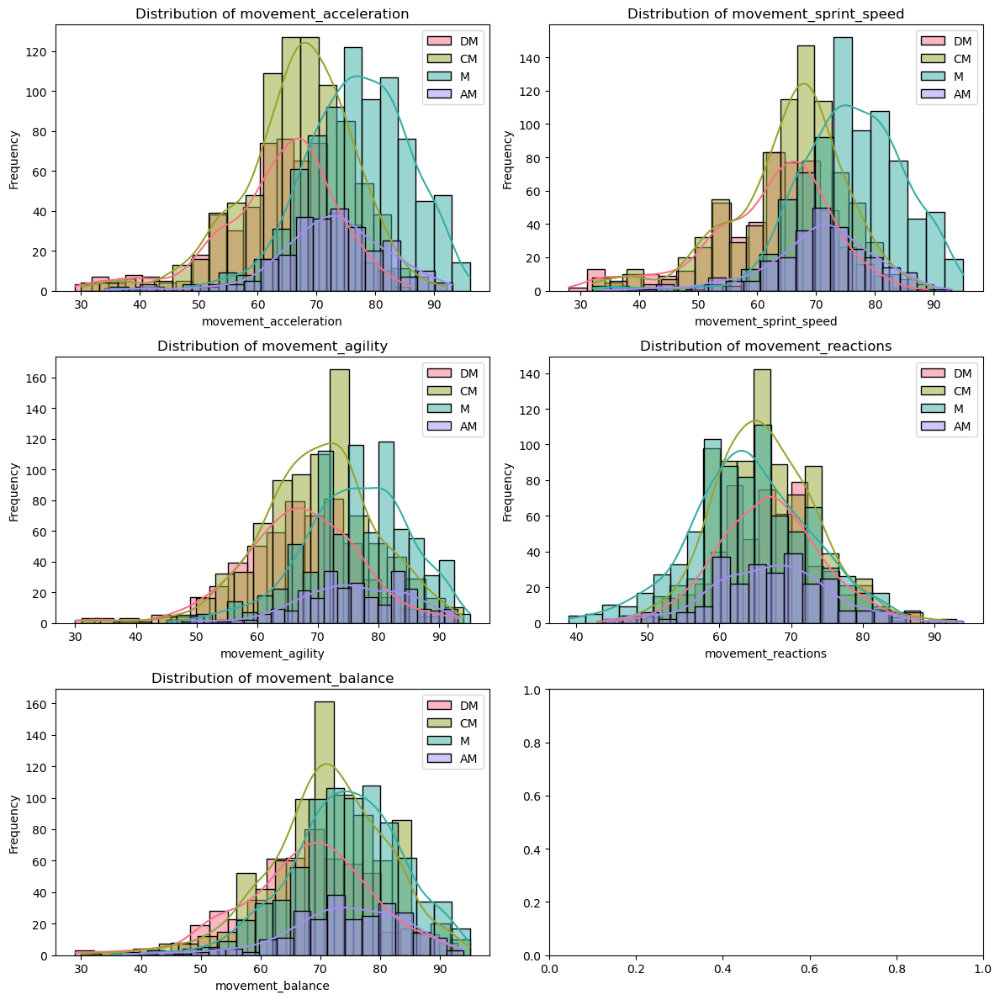

In [84]:
plot_distributions_stacked(all_dfs, ['movement_acceleration', 'movement_sprint_speed', 'movement_agility',
   'movement_reactions', 'movement_balance'],  labels=labels)

midfielders have better speed, acceleration and agility

<b>takeaway columns</b>

'movement_acceleration', 'movement_sprint_speed', 'movement_agility'

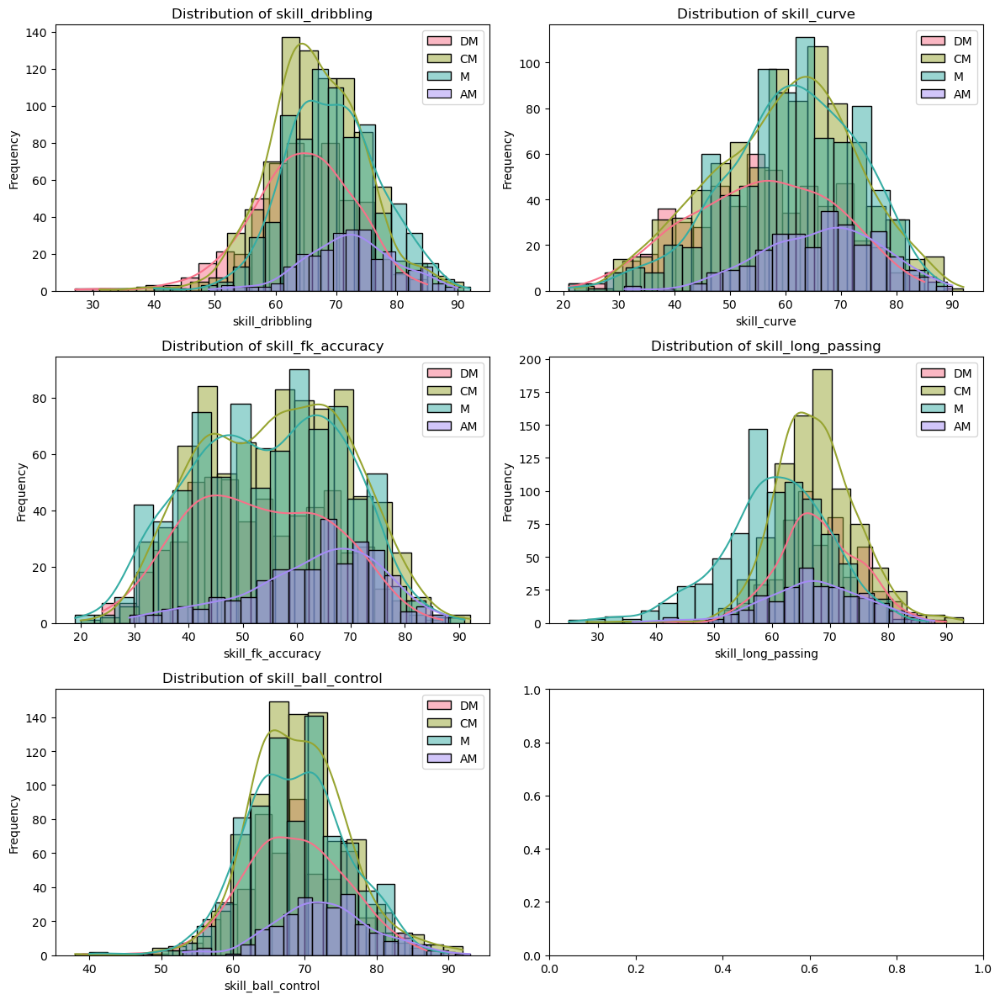

In [85]:
plot_distributions_stacked(all_dfs, ['skill_dribbling', 'skill_curve',
   'skill_fk_accuracy', 'skill_long_passing', 'skill_ball_control'],  labels=labels)

Attack midfielders generally are more skilled 

Center midfielders are highly skilled at long passing

<b>takeaway columns</b>

'skill_dribbling', 'skill_curve', 'skill_fk_accuracy', 'skill_long_passing'

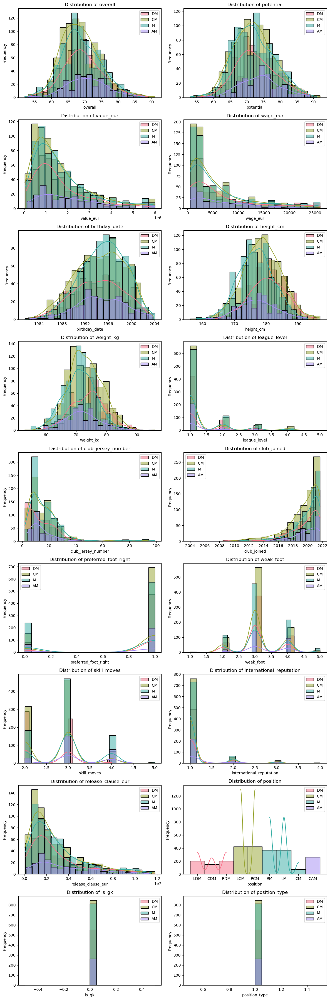

In [86]:
non_skill_cols = ['overall', 'potential', 'value_eur', 'wage_eur', 'birthday_date',
       'height_cm', 'weight_kg', 'league_level', 'club_jersey_number',
       'club_joined', 'preferred_foot_right', 'weak_foot', 'skill_moves',
       'international_reputation',  'release_clause_eur', 'position',
       'is_gk', 'position_type']

plot_distributions_stacked(all_dfs, non_skill_cols,  labels=labels)

Defensive midfielders are generally taller

'height_cm'

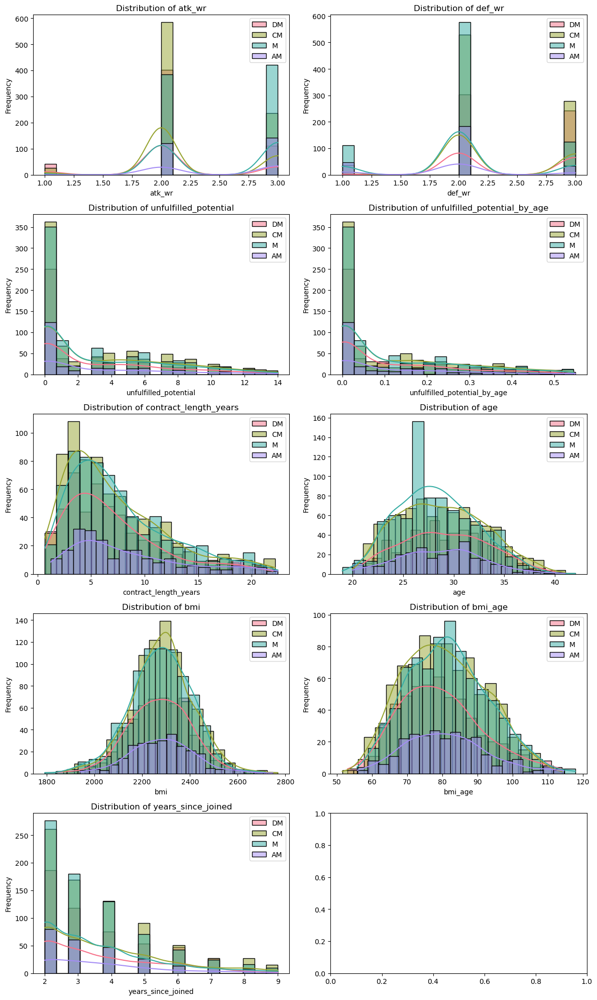

In [87]:
new_feature_cols = ['atk_wr','def_wr','unfulfilled_potential', 'unfulfilled_potential_by_age', 'contract_length_years', 'age', 'bmi', 'bmi_age', 'years_since_joined']

plot_distributions_stacked(all_dfs, new_feature_cols,  labels=labels)

none for the last set


midfielders have better speed, acceleration and agility, have more interception and aggression skills, are better at finishing, volleys, and crossing, but worse defenders

center midfielders have slightly more stamina and strength, and have to be great passers, they are not as good at taking penalties

defensive midfielders are slightly worse at penalties, generally taller, and have slightly more stamina and strength

attack midfielders generally are more skilled, better at shooting, dribbling, finishing, volleys, and crossing, but are somewhat unskilled at defending

<b>takeaway columns</b>: 'power_stamina', 'power_strength', 'pace','shooting', 'passing', 'dribbling', 'defending',
'defending_marking_awareness','defending_standing_tackle', 'defending_sliding_tackle',
'mentality_aggression', 'mentality_interceptions','mentality_positioning', 'mentality_vision', 'mentality_penalties',
'attacking_crossing', 'attacking_finishing','attacking_heading_accuracy', 'attacking_short_passing','attacking_volleys',
'movement_acceleration', 'movement_sprint_speed', 'movement_agility','skill_dribbling', 'skill_curve', 'skill_fk_accuracy', 'skill_long_passing','height_cm'

we store it for midfielders

In [88]:
midfielder_cols = ['power_stamina', 'power_strength', 'pace','shooting', 'passing', 'dribbling', 'defending',
'defending_marking_awareness','defending_standing_tackle', 'defending_sliding_tackle',
'mentality_aggression', 'mentality_interceptions','mentality_positioning', 'mentality_vision', 'mentality_penalties',
'attacking_crossing', 'attacking_finishing','attacking_heading_accuracy', 'attacking_short_passing','attacking_volleys',
'movement_acceleration', 'movement_sprint_speed', 'movement_agility','skill_dribbling', 'skill_curve', 'skill_fk_accuracy', 'skill_long_passing','height_cm']

finally we do the same analysis for defenders

In [89]:
# last we look at the defenders

defenders = _df_train.loc[_df_train.position_type == 2].copy()

all_dfs = []
labels = []

defenders['position_simple'] = defenders.loc[defenders.position.str.len() == 3].position.str[-2:]
defenders['position_simple'] = defenders['position_simple'].fillna('B')

for position in defenders.position_simple.unique():
    all_dfs.append(defenders.loc[defenders.position_simple == position])
    labels.append(position)

labels


['B', 'WB', 'CB']

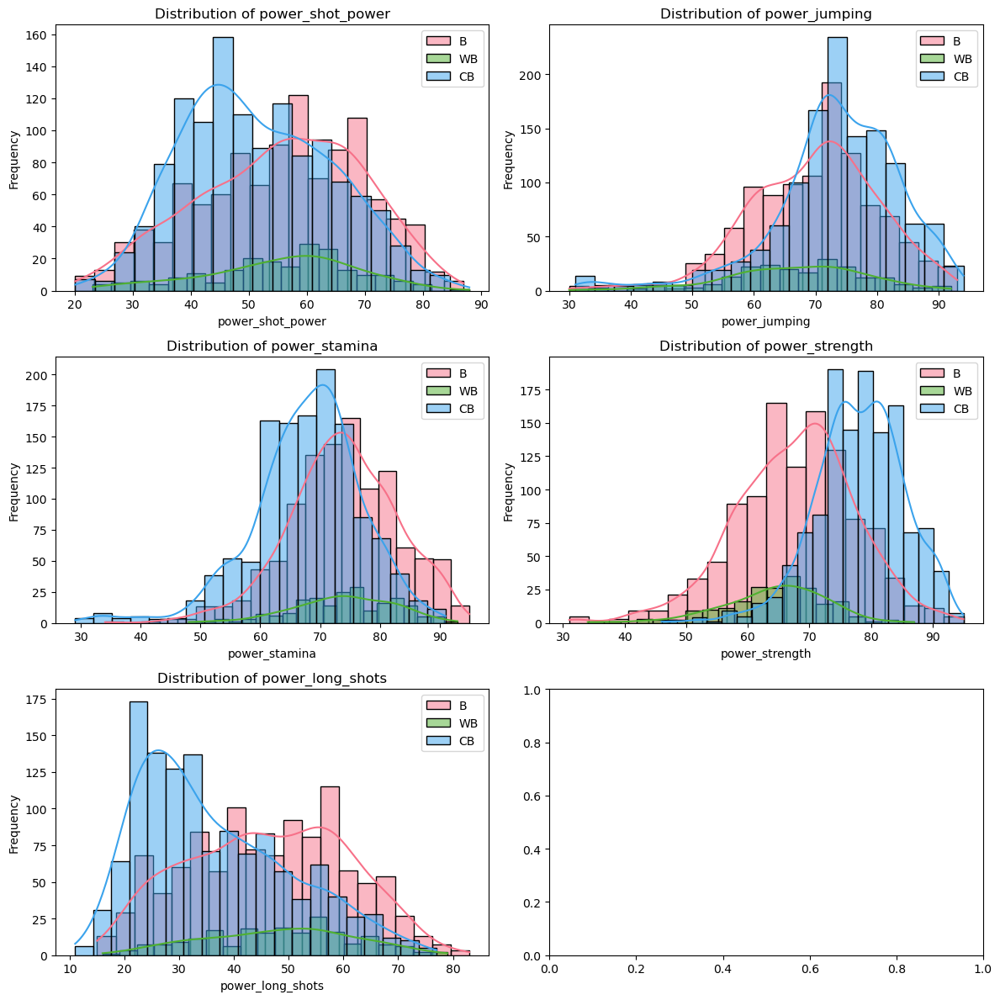

In [90]:
plot_distributions_stacked(all_dfs, ['power_shot_power',
       'power_jumping', 'power_stamina', 'power_strength', 'power_long_shots'],  labels=labels)


center backs are worse at long shots, shot power, and have slightly less stamina, but have more strength and jumping ability





<b>takeaway columns</b>

'power_shot_power','power_stamina', 'power_strength', 'power_long_shots'

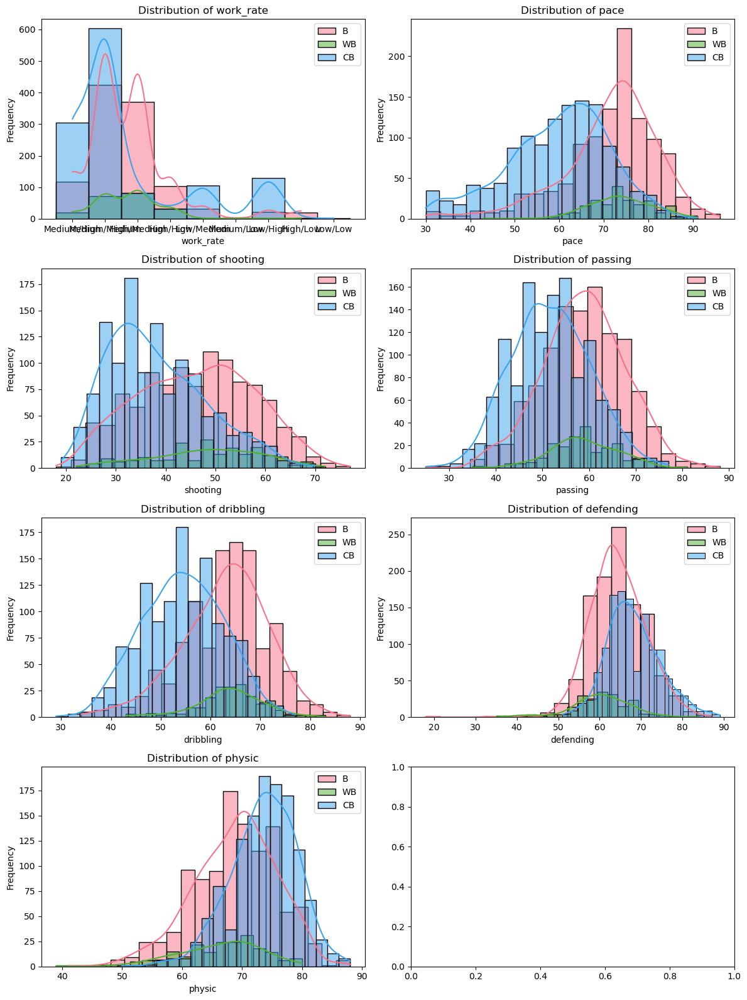

In [91]:
plot_distributions_stacked(all_dfs, ['work_rate',  'pace',
   'shooting', 'passing', 'dribbling', 'defending', 'physic'],  labels=labels)

backs are better at shooting passing and dribbling

center backs are worse at shooting passing and dribbling but generally better at defending, they also have higher physic ratings

<b>takeaway columns</b>

'shooting', 'passing', 'dribbling', 'physic'

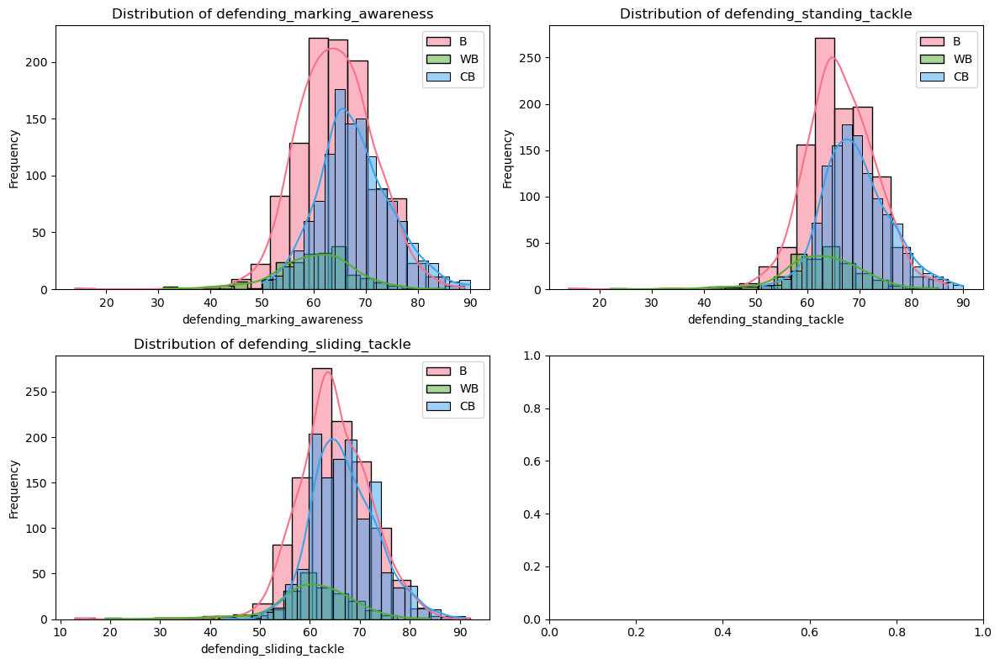

In [92]:

plot_distributions_stacked(all_dfs, ['defending_marking_awareness',
   'defending_standing_tackle', 'defending_sliding_tackle'],  labels=labels)

not useful

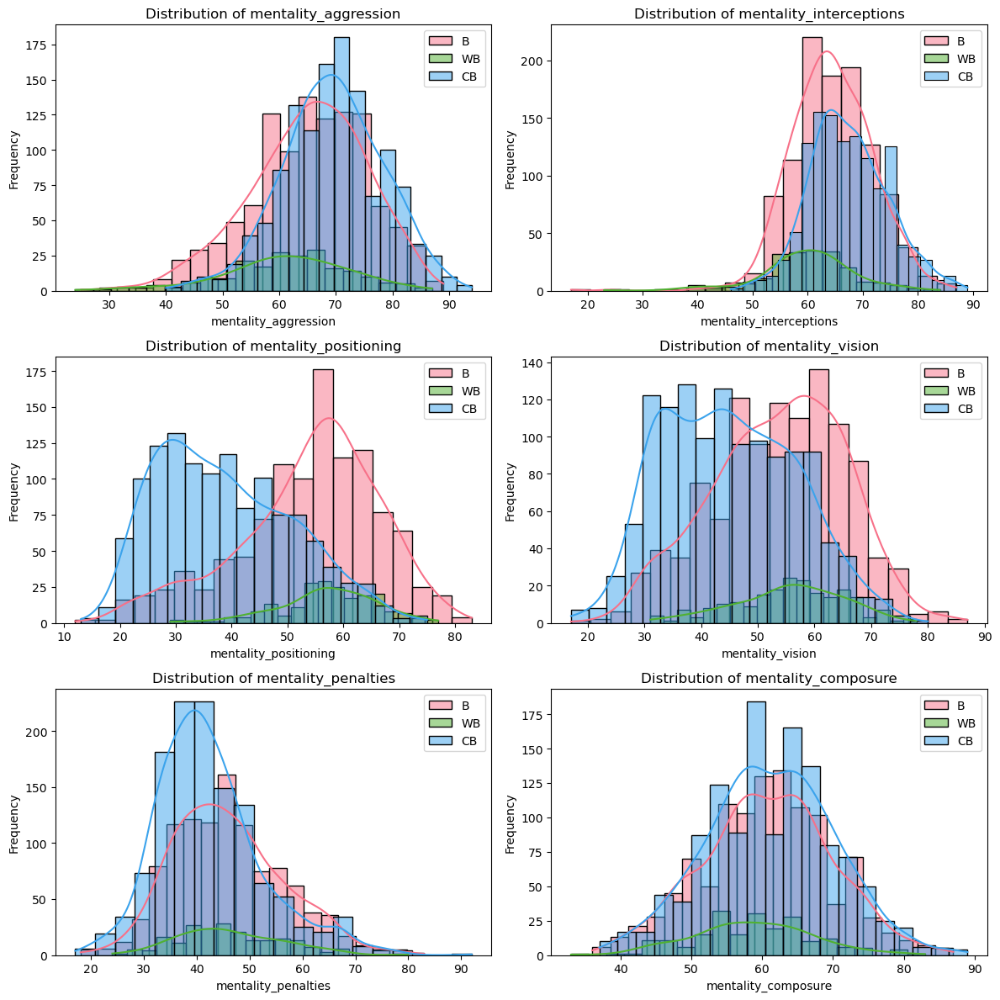

In [93]:
plot_distributions_stacked(all_dfs, ['mentality_aggression', 'mentality_interceptions',
   'mentality_positioning', 'mentality_vision', 'mentality_penalties',
   'mentality_composure'],  labels=labels)

center backs have higher positioning and vision but are worse at penalties

backs and wing backs are better at positioning and vision

wing backs are more neutral


<b>takeaway cols</b>
'mentality_positioning', 'mentality_vision', 'mentality_penalties'

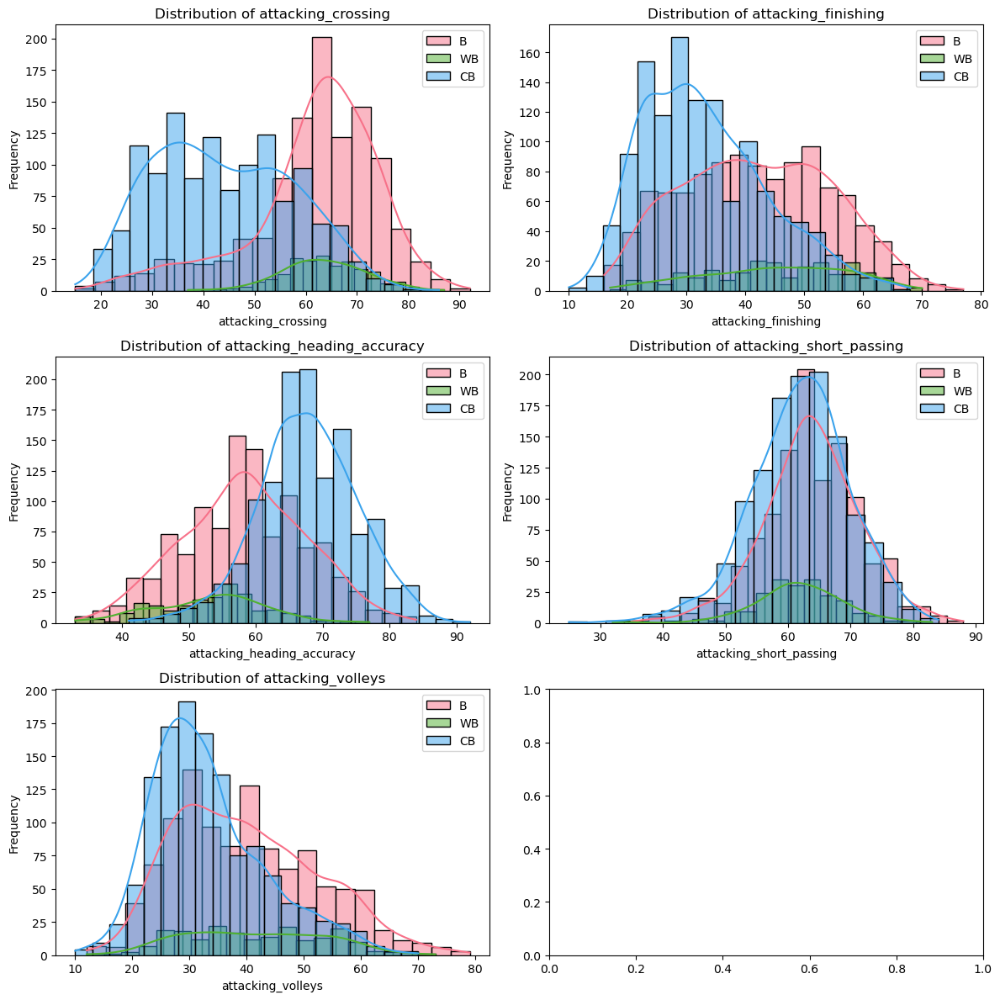

In [94]:
plot_distributions_stacked(all_dfs, ['attacking_crossing', 'attacking_finishing',
   'attacking_heading_accuracy', 'attacking_short_passing',
   'attacking_volleys'],  labels=labels)

center backs are generally worse at volleys crossing and finishing but better at headers

backs are generally better at volleys crossing and finishing


<b>takeaway cols</b>

'attacking_crossing', 'attacking_finishing','attacking_heading_accuracy','attacking_volleys'

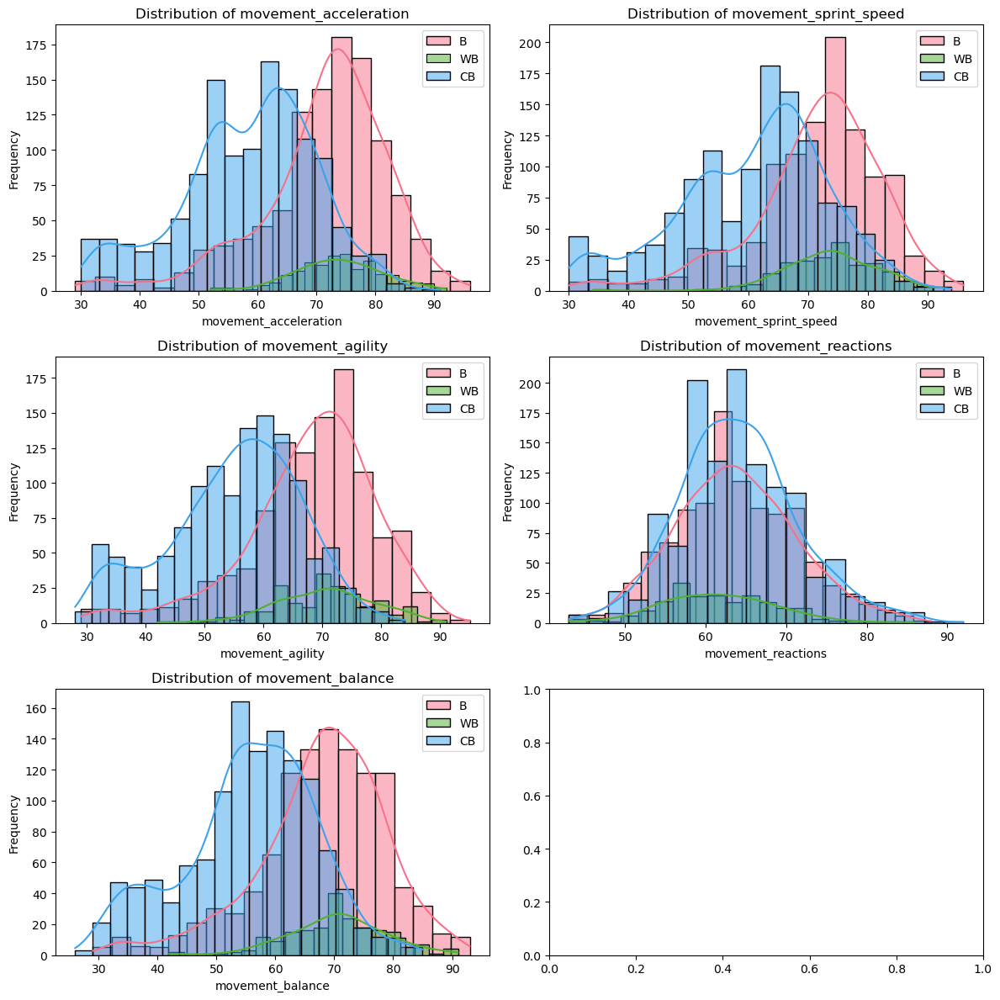

In [95]:
plot_distributions_stacked(all_dfs, ['movement_acceleration', 'movement_sprint_speed', 'movement_agility',
   'movement_reactions', 'movement_balance'],  labels=labels)

backs and wing backs are better at movement

center backs are typically not as mobile


<b>takeaway cols</b>

'movement_acceleration', 'movement_sprint_speed', 'movement_agility', 'movement_balance'

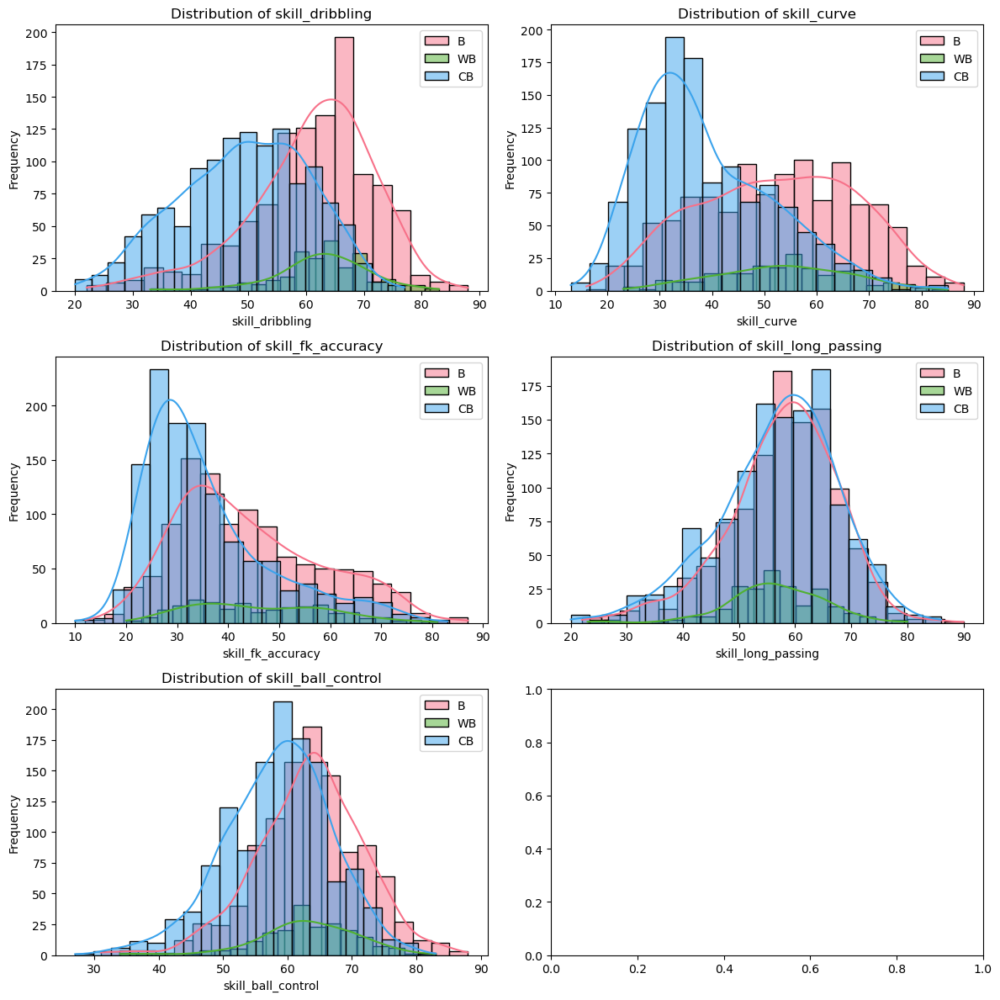

In [96]:
plot_distributions_stacked(all_dfs, ['skill_dribbling', 'skill_curve',
   'skill_fk_accuracy', 'skill_long_passing', 'skill_ball_control'],  labels=labels)

center backs are less skilled overall, with the exception of long passing

backs have a higher skill curve, dribbling, and fk_accuracy


<b>takeaway cols</b>

'skill_dribbling', 'skill_curve', 'skill_fk_accuracy', 'skill_ball_control'

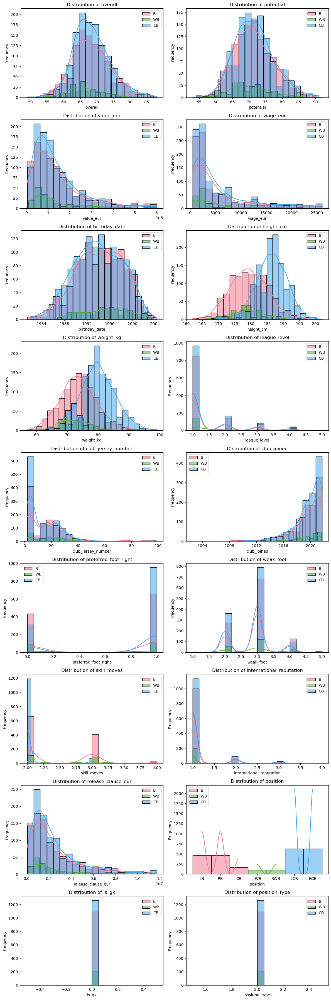

In [97]:
non_skill_cols = ['overall', 'potential', 'value_eur', 'wage_eur', 'birthday_date',
       'height_cm', 'weight_kg', 'league_level', 'club_jersey_number',
       'club_joined', 'preferred_foot_right', 'weak_foot', 'skill_moves',
       'international_reputation',  'release_clause_eur', 'position',
       'is_gk', 'position_type']

plot_distributions_stacked(all_dfs, non_skill_cols,  labels=labels)

center backs are typically taller and weigh more

<b>takeaway cols</b>

'height_cm', 'weight_kg'

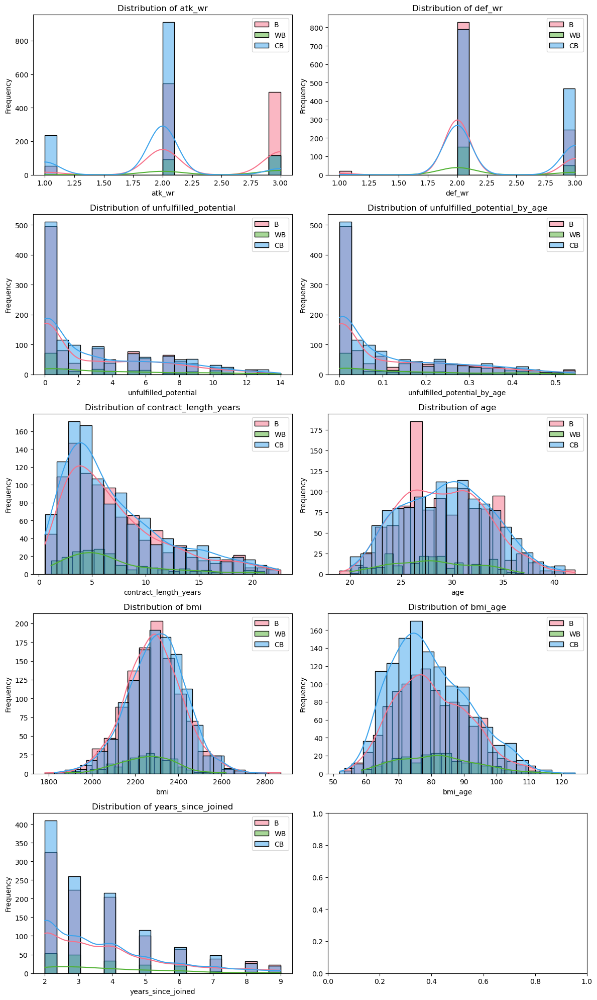

In [98]:
new_feature_cols = ['atk_wr','def_wr','unfulfilled_potential', 'unfulfilled_potential_by_age', 'contract_length_years', 'age', 'bmi', 'bmi_age', 'years_since_joined']

plot_distributions_stacked(all_dfs, new_feature_cols,  labels=labels)

center backs generally larger taller players with less movement and skill, but can make long passes, are strong, can jump and make headers

backs have a higher skill curve, dribbling, and fk_accuracy

backs are faster and more mobile, more sskilled, and are better at longer range plays and finishing

wing backs are more neutral, most often are similar to backs, generally mobile wwith great positioning and vision



<b>takeaway columns</b>
'power_shot_power','power_stamina', 'power_strength', 'power_long_shots',
'shooting', 'passing', 'dribbling', 'physic',
'mentality_positioning', 'mentality_vision', 'mentality_penalties',
'attacking_crossing', 'attacking_finishing','attacking_heading_accuracy','attacking_volleys',
'movement_acceleration', 'movement_sprint_speed', 'movement_agility', 'movement_balance',
'skill_dribbling', 'skill_curve', 'skill_fk_accuracy', 'skill_ball_control',
'height_cm', 'weight_kg'


In [99]:
defender_cols = ['power_shot_power','power_stamina', 'power_strength', 'power_long_shots',
'shooting', 'passing', 'dribbling', 'physic',
'mentality_positioning', 'mentality_vision', 'mentality_penalties',
'attacking_crossing', 'attacking_finishing','attacking_heading_accuracy','attacking_volleys',
'movement_acceleration', 'movement_sprint_speed', 'movement_agility', 'movement_balance',
'skill_dribbling', 'skill_curve', 'skill_fk_accuracy', 'skill_ball_control',
'height_cm', 'weight_kg']

In [100]:
# we need to make sure that the weak foot, preferred foot columns are still present in the cols
attacker_cols = list(set(attacker_cols + ['weak_foot', 'preferred_foot_right']))
defender_cols = list(set(defender_cols + ['weak_foot', 'preferred_foot_right']))
midfielder_cols = list(set(midfielder_cols + ['weak_foot', 'preferred_foot_right']))

# Second Model Value Imputer

now we impute for the second model

In [101]:
all_cols = list(set(attacker_cols + defender_cols + midfielder_cols))

_df_test = _df_test[all_cols]

all_cols_train = all_cols
all_cols_train.append('position')
all_cols_train.append('position_type')
_df_train = _df_train[all_cols_train]


In [102]:
_df_train.columns

Index(['mentality_aggression', 'preferred_foot_right', 'bmi_age', 'shooting',
       'attacking_short_passing', 'attacking_crossing', 'movement_agility',
       'power_stamina', 'mentality_interceptions', 'movement_sprint_speed',
       'power_jumping', 'physic', 'skill_dribbling', 'skill_long_passing',
       'attacking_finishing', 'attacking_heading_accuracy', 'passing',
       'mentality_penalties', 'skill_ball_control', 'mentality_positioning',
       'defending_sliding_tackle', 'dribbling', 'skill_fk_accuracy',
       'skill_curve', 'height_cm', 'weak_foot', 'defending_standing_tackle',
       'power_shot_power', 'defending_marking_awareness', 'power_long_shots',
       'attacking_volleys', 'pace', 'weight_kg', 'power_strength',
       'mentality_vision', 'movement_acceleration', 'defending',
       'movement_balance', 'position', 'position_type'],
      dtype='object')

In [103]:
train_na = _df_train.isna().sum()
test_na = _df_test.loc[:,_df_test.columns.difference(['position', 'position_type'])].isna().sum()
nas_testrain = pd.concat([train_na, test_na], axis=1, keys=['Train', 'Test'])

display(nas_testrain[nas_testrain.sum(axis=1) > 0])

,Train,Test
shooting,631,70.0
physic,631,70.0
passing,631,70.0
dribbling,631,70.0
pace,631,70.0
defending,631,70.0


In [104]:

NaN_cols = nas_testrain[nas_testrain.sum(axis=1) > 0].index

# Perform KNN imputation
imputer = KNNImputer(n_neighbors = 5)

imputed_temp_train = imputer.fit_transform(_df_train[NaN_cols])
imputed_temp_test = imputer.fit_transform(_df_test[NaN_cols])

# Convert the imputed data back to DataFrame
filled_df_train = pd.DataFrame(imputed_temp_train, columns=NaN_cols)
filled_df_test = pd.DataFrame(imputed_temp_test, columns=NaN_cols)

filled_df_train.index = _df_train.index
filled_df_test.index = _df_test.index

_df_train[NaN_cols] = filled_df_train  
_df_test[NaN_cols] = filled_df_test

In [105]:
train_na = _df_train.isna().sum()
test_na = _df_test.isna().sum()
nas_testrain = pd.concat([train_na, test_na], axis=1, keys=['Train', 'Test'])

display(nas_testrain[nas_testrain.sum(axis=1) > 0])

,Train,Test


# Scale columns

In [106]:
cols_to_scale = ['skill_curve', 'attacking_volleys', 'mentality_positioning',
       'skill_long_passing', 'weak_foot','mentality_aggression', 'dribbling', 'defending_standing_tackle',
       'passing', 'bmi_age', 'skill_dribbling', 'defending_sliding_tackle',
       'power_stamina', 'movement_balance', 'skill_fk_accuracy', 'height_cm',
       'attacking_heading_accuracy', 'power_long_shots',
       'movement_acceleration', 'power_strength', 'mentality_interceptions',
       'weight_kg', 'movement_agility', 'physic', 'power_jumping',
       'mentality_vision', 'attacking_short_passing', 'attacking_finishing',
       'skill_ball_control', 'pace', 'mentality_penalties',
       'attacking_crossing', 'shooting', 'defending',
       'defending_marking_awareness', 'power_shot_power',
       'movement_sprint_speed']

In [107]:

_df_train = scale_column(_df_train, cols_to_scale)
_df_test = scale_column(_df_test, cols_to_scale)
display(_df_train.head())

,mentality_aggression,preferred_foot_right,bmi_age,shooting,attacking_short_passing,attacking_crossing,movement_agility,power_stamina,mentality_interceptions,movement_sprint_speed,...,attacking_volleys,pace,weight_kg,power_strength,mentality_vision,movement_acceleration,defending,movement_balance,position,position_type
id,,,,,,,,,,,,,,,,,,,,,
216302,-0.231511,1,-0.728931,-0.167757,0.200968,0.623435,1.496684,1.199396,1.371699,0.278542,...,-0.210520,0.130510,-0.359048,-0.858775,-0.655685,0.350615,0.769319,1.486062,LB,2
237867,0.383978,1,0.056927,-1.188830,0.125799,-0.162197,-0.574326,0.205800,0.723671,-0.066980,...,-0.769556,-0.314953,-0.359048,-0.182688,0.374462,-0.129699,0.500562,0.151219,LDM,1
253472,0.568624,0,1.596155,-1.407632,-0.174879,0.342852,0.392145,-0.059159,0.524278,0.762272,...,-0.434135,0.932342,-0.927181,-0.605242,0.227298,1.105394,0.231805,0.713258,LWB,2
223994,-0.477707,1,-0.516975,1.436786,-0.250049,-1.172295,-0.091090,0.470759,-1.669046,0.002125,...,1.410685,-0.404045,0.777217,1.592040,0.227298,-0.335548,-2.119819,-0.832350,LS,0
251635,-0.416158,0,-0.849335,-0.094823,0.050629,0.623435,0.323112,0.669478,0.574126,0.693168,...,0.068998,0.486880,-0.217015,0.155355,-0.361357,0.350615,0.366184,0.432238,LB,2


In [108]:
_df_train['position_simple'] = None

_df_train.loc[_df_train.position_type == 0, 'position_simple'] = _df_train.loc[_df_train.position_type == 0, 'position'].str[-1]

_df_train.loc[(_df_train.position_type == 1) & (_df_train.position.str.len() == 3), 'position_simple'] = _df_train.loc[(_df_train.position_type == 1) & (_df_train.position.str.len() == 3), 'position'].str[-2:]
_df_train.loc[(_df_train.position_type == 1) & (_df_train.position.str.len() < 3), 'position_simple'] = _df_train.loc[(_df_train.position_type == 1) & (_df_train.position.str.len() < 3), 'position_simple'].fillna('M')


_df_train.loc[(_df_train.position_type == 2) & (_df_train.position.str.len() == 3), 'position_simple'] = _df_train.loc[(_df_train.position_type == 2) & (_df_train.position.str.len() == 3), 'position'].str[-2:]
_df_train.loc[(_df_train.position_type == 2) & (_df_train.position.str.len() < 3), 'position_simple'] = _df_train.loc[(_df_train.position_type == 2) & (_df_train.position.str.len() < 3), 'position_simple'].fillna('B')



In [109]:
_df_train = _df_train.loc[_df_train.position != 'GK']

# Second Model Development

we are now predicting the position of the player regardless of which side of the field they will play on. 

Again we will try a tpot random forest classifier and a xgboost model for the same reasons

In [110]:
# define useful functions

def get_position_type(df_column_to_encode):    
    position_encoder = {}
    count = 0
    
    for key in df_column_to_encode.unique():
        position_encoder[key] = count
        count += 1

    df_column_to_encode = df_column_to_encode.map(position_encoder)

    return df_column_to_encode, get_reverse_encoder(position_encoder)

def get_reverse_encoder(encoder):
    return {value: key for key, value in encoder.items()}

In [111]:

# X training data with attacker position
attackers_X = attackers.loc[_df_train.position_type == 0, attacker_cols]
attackers_y = attackers.loc[attackers.position_type == 0, 'position_simple']
attackers_y, attackers_decoder = get_position_type(attackers_y)
print(attackers_y.unique())

[0 1 2 3]


In [112]:


midfielders_X = _df_train.loc[_df_train.position_type == 1, midfielder_cols]
midfielders_y = _df_train.loc[_df_train.position_type == 1, 'position_simple']
print(midfielders_y.unique())
midfielders_y, midfielders_decoder = get_position_type(midfielders_y)
print(midfielders_y.unique())

['DM' 'CM' 'M' 'AM']
[0 1 2 3]


In [113]:
defenders_X = _df_train.loc[_df_train.position_type == 2, defender_cols]
defenders_y = _df_train.loc[_df_train.position_type == 2, 'position_simple']

print(defenders_y.unique())
defenders_y, defenders_decoder = get_position_type(defenders_y)
print(defenders_y.unique())

['B' 'WB' 'CB']
[0 1 2]


In [114]:
# create the datasets: 

# Initialize SMOTE (Synthetic Minority Over-sampling Technique)
smote = SMOTE(sampling_strategy='auto', random_state = 168)

# Fit and transform the data using SMOTE to perform over-sampling
attackers_X, attackers_y = smote.fit_resample(attackers_X, attackers_y)
midfielders_X, midfielders_y = smote.fit_resample(midfielders_X, midfielders_y)
defenders_X, defenders_y = smote.fit_resample(defenders_X, defenders_y)

X_train_atk, X_test_atk, y_train_atk, y_test_atk = train_test_split(attackers_X, attackers_y, test_size=0.2, random_state=42)
X_train_mid, X_test_mid, y_train_mid, y_test_mid = train_test_split(midfielders_X, midfielders_y, test_size=0.2, random_state=42)
X_train_def, X_test_def, y_train_def, y_test_def = train_test_split(defenders_X, defenders_y, test_size=0.2, random_state=42)

Now we train the each model for each position type

Attackers

In [115]:
# train model on predicting attackers

xgb_model = xgb.XGBClassifier()

# Define the parameter grid for random search
param_dist = {
    'n_estimators': [10,20,40,50,60,70,80,90,100, 200, 300, 400,500,600,700,800,900],
    'learning_rate': [0.01, 0.05, 0.1, 0.2],
    'max_depth': [3, 5, 6, 10],
    'min_child_weight': [1, 3, 5, 7],
    'subsample': [0.2,0.3,0.5, 0.75, 1.0],
    'colsample_bytree': [0.3, 0.5, 0.7, 1.0]
}

# Define the RandomizedSearchCV object
random_search_attackers = RandomizedSearchCV(
    xgb_model, param_distributions=param_dist, n_iter=10, scoring=f1_scorer, cv=5, random_state = 168
)

# Fit the RandomizedSearchCV object to the data
random_search_attackers.fit(X_train_atk, y_train_atk)


tpot.fit(X_train_atk, y_train_atk)

# Define the RandomizedSearchCV object
random_search_attackers_tpot = tpot.fitted_pipeline_


# Print the best parameters and corresponding accuracy
print("Best Parameters: ", random_search_attackers.best_params_)
print("Best Accuracy: ", random_search_attackers.best_score_)

# Evaluate the best model on the test set
best_model = random_search_attackers.best_estimator_
test_accuracy = best_model.score(X_test_atk, y_test_atk)
print("Test Accuracy: ", test_accuracy)

Optimization Progress:   0%|          | 0/210 [00:00<?, ?pipeline/s]


Generation 1 - Current best internal CV score: 0.654183655692723

Generation 2 - Current best internal CV score: 0.654183655692723

Generation 3 - Current best internal CV score: 0.654183655692723

Generation 4 - Current best internal CV score: 0.654183655692723

Generation 5 - Current best internal CV score: 0.654183655692723

Generation 6 - Current best internal CV score: 0.6569798613883061

Generation 7 - Current best internal CV score: 0.6569798613883061

Generation 8 - Current best internal CV score: 0.6569798613883061

Generation 9 - Current best internal CV score: 0.6569798613883061

Generation 10 - Current best internal CV score: 0.6569798613883061

Generation 11 - Current best internal CV score: 0.6569798613883061

Generation 12 - Current best internal CV score: 0.6569798613883061

Generation 13 - Current best internal CV score: 0.6569798613883061

Generation 14 - Current best internal CV score: 0.6569798613883061

Generation 15 - Current best internal CV score: 0.65697986138

Confusion matrix:
 [[29  8 45  2]
 [ 9 74  7  2]
 [22  3 58  2]
 [ 0  3  0 79]]


/var/folders/d4/rcb0hfcs0bzgr7z0mw72lc_w0000gn/T/ipykernel_26057/798438039.py:10: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels([''] + labels)
/var/folders/d4/rcb0hfcs0bzgr7z0mw72lc_w0000gn/T/ipykernel_26057/798438039.py:11: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels([''] + labels)


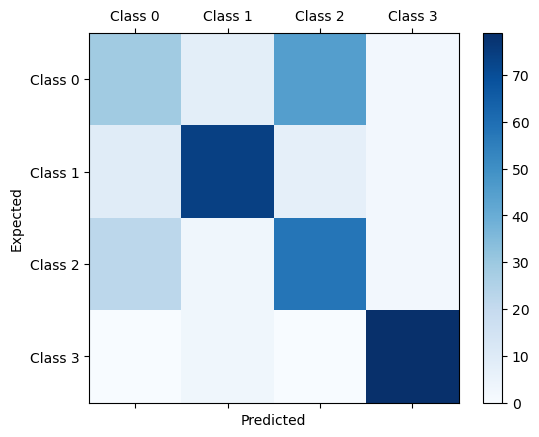

In [116]:
y_pred = random_search_attackers.predict(X_test_atk)
conf_mat = confusion_matrix(y_true=y_test_atk, y_pred=y_pred)
print('Confusion matrix:\n', conf_mat)

labels = ['Class 0', 'Class 1', 'Class 2', 'Class 3']
fig = plt.figure()
ax = fig.add_subplot(111)
cax = ax.matshow(conf_mat, cmap=plt.cm.Blues)
fig.colorbar(cax)
ax.set_xticklabels([''] + labels)
ax.set_yticklabels([''] + labels)
plt.xlabel('Predicted')
plt.ylabel('Expected')
plt.show()

Midfielders

In [117]:
# train model on predicting midfielders 

xgb_model = xgb.XGBClassifier()

# Define the parameter grid for random search
param_dist = {
    'n_estimators': [10,20,40,50,60,70,80,90,100, 200, 300, 400,500,600,700,800,900],
    'learning_rate': [0.01, 0.05, 0.1, 0.2],
    'max_depth': [3, 5, 6, 10],
    'min_child_weight': [1, 3, 5, 7],
    'subsample': [0.5, 0.75, 1.0],
    'colsample_bytree': [0.3, 0.5, 0.7, 1.0]
}

# Define the RandomizedSearchCV object
random_search_midfielders = RandomizedSearchCV(
    xgb_model, param_distributions=param_dist, n_iter=10, scoring=f1_scorer, cv=5, random_state = 168
)

# Fit the RandomizedSearchCV object to the data
random_search_midfielders.fit(X_train_mid, y_train_mid)


tpot.fit(X_train_mid, y_train_mid)

# Define the RandomizedSearchCV object
random_search_midfielders_tpot = tpot.fitted_pipeline_

# Print the best parameters and corresponding accuracy
print("Best Parameters: ", random_search_midfielders.best_params_)
print("Best Accuracy: ", random_search_midfielders.best_score_)

# Evaluate the best model on the test set
best_model = random_search_midfielders.best_estimator_
test_accuracy = best_model.score(X_test_mid, y_test_mid)
print("Test Accuracy: ", test_accuracy)

Optimization Progress:   0%|          | 0/210 [00:00<?, ?pipeline/s]


Generation 1 - Current best internal CV score: 0.6800537976871909

Generation 2 - Current best internal CV score: 0.6800537976871909

Generation 3 - Current best internal CV score: 0.6886002749577743

Generation 4 - Current best internal CV score: 0.6886002749577743

Generation 5 - Current best internal CV score: 0.6886002749577743

Generation 6 - Current best internal CV score: 0.6886002749577743

Generation 7 - Current best internal CV score: 0.6886002749577743

Generation 8 - Current best internal CV score: 0.6901184906435366

Generation 9 - Current best internal CV score: 0.6940019076093336

Generation 10 - Current best internal CV score: 0.6940019076093336

Generation 11 - Current best internal CV score: 0.6947962669257792

Generation 12 - Current best internal CV score: 0.6947962669257792

Generation 13 - Current best internal CV score: 0.6947962669257792

Generation 14 - Current best internal CV score: 0.6947962669257792

Generation 15 - Current best internal CV score: 0.694796

Confusion matrix:
 [[120  36   4   1]
 [ 58  81   6  17]
 [ 13  20 138  20]
 [  4  10  22 127]]


/var/folders/d4/rcb0hfcs0bzgr7z0mw72lc_w0000gn/T/ipykernel_26057/621932607.py:10: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels([''] + labels)
/var/folders/d4/rcb0hfcs0bzgr7z0mw72lc_w0000gn/T/ipykernel_26057/621932607.py:11: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels([''] + labels)


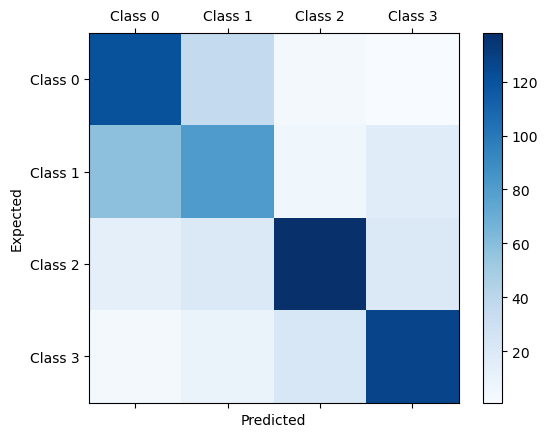

In [118]:
y_pred = random_search_midfielders.predict(X_test_mid)
conf_mat = confusion_matrix(y_true=y_test_mid, y_pred=y_pred)
print('Confusion matrix:\n', conf_mat)

labels = ['Class 0', 'Class 1', 'Class 2', 'Class 3']
fig = plt.figure()
ax = fig.add_subplot(111)
cax = ax.matshow(conf_mat, cmap=plt.cm.Blues)
fig.colorbar(cax)
ax.set_xticklabels([''] + labels)
ax.set_yticklabels([''] + labels)
plt.xlabel('Predicted')
plt.ylabel('Expected')
plt.show()

Defense

In [119]:
# train model on predicting defenders

xgb_model = xgb.XGBClassifier()

# Define the parameter grid for random search
param_dist = {
    'n_estimators': [10,20,40,50,60,70,80,90,100, 200, 300, 400,500,600,700,800,900],
    'learning_rate': [0.01, 0.05, 0.1, 0.2],
    'max_depth': [3, 5, 6, 10],
    'min_child_weight': [1, 3, 5, 7],
    'subsample': [0.5, 0.75, 1.0],
    'colsample_bytree': [0.3, 0.5, 0.7, 1.0]
}

# Define the RandomizedSearchCV object
random_search_defenders = RandomizedSearchCV(
    xgb_model, param_distributions=param_dist, n_iter=10, scoring=f1_scorer, cv=5, random_state = 168
)

# Fit the RandomizedSearchCV object to the data
random_search_defenders.fit(X_train_def, y_train_def)


tpot.fit(X_train_def, y_train_def)

# Define the RandomizedSearchCV object
random_search_defenders_tpot = tpot.fitted_pipeline_

# Print the best parameters and corresponding accuracy
print("Best Parameters: ", random_search_defenders.best_params_)
print("Best Accuracy: ", random_search_defenders.best_score_)

# Evaluate the best model on the test set
best_model = random_search_defenders.best_estimator_
test_accuracy = best_model.score(X_test_def, y_test_def)
print("Test Accuracy: ", test_accuracy)

Optimization Progress:   0%|          | 0/210 [00:00<?, ?pipeline/s]


Generation 1 - Current best internal CV score: 0.817344595307004

Generation 2 - Current best internal CV score: 0.8266311734733289

Generation 3 - Current best internal CV score: 0.8284617293594136

Generation 4 - Current best internal CV score: 0.8284617293594136

Generation 5 - Current best internal CV score: 0.8424854447433887

Generation 6 - Current best internal CV score: 0.84284293772055

Generation 7 - Current best internal CV score: 0.84284293772055

Generation 8 - Current best internal CV score: 0.8438528142520492

Generation 9 - Current best internal CV score: 0.8442959947406783

Generation 10 - Current best internal CV score: 0.8442959947406783

Generation 11 - Current best internal CV score: 0.8445935590445934

Generation 12 - Current best internal CV score: 0.8445935590445934

Generation 13 - Current best internal CV score: 0.8448414480681656

Generation 14 - Current best internal CV score: 0.8452676072189188

Generation 15 - Current best internal CV score: 0.84526760721

/var/folders/d4/rcb0hfcs0bzgr7z0mw72lc_w0000gn/T/ipykernel_26057/391544981.py:10: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels([''] + labels)
/var/folders/d4/rcb0hfcs0bzgr7z0mw72lc_w0000gn/T/ipykernel_26057/391544981.py:11: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels([''] + labels)


Confusion matrix:
 [[195  30  51]
 [ 11 220   0]
 [ 18   3 230]]


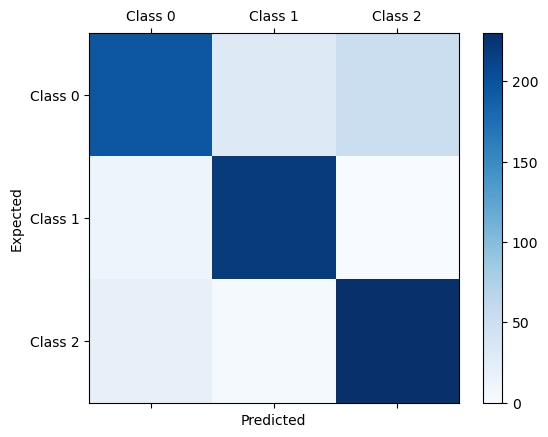

In [120]:
y_pred = random_search_defenders.predict(X_test_def)
conf_mat = confusion_matrix(y_true=y_test_def, y_pred=y_pred)
print('Confusion matrix:\n', conf_mat)

labels = ['Class 0', 'Class 1', 'Class 2', 'Class 3']
fig = plt.figure()
ax = fig.add_subplot(111)
cax = ax.matshow(conf_mat, cmap=plt.cm.Blues)
fig.colorbar(cax)
ax.set_xticklabels([''] + labels)
ax.set_yticklabels([''] + labels)
plt.xlabel('Predicted')
plt.ylabel('Expected')
plt.show()

# Final Model
finally we need to determine on what side of the field a player will play

first we create the field for each position 

In [121]:
side_of_the_field_encoder = {'R':0,'L':1,'C':2,'S':2,'G':3}
_df_train_final['side_of_the_field'] = _df_train_final['position'].str[0]
_df_train_final['side_of_the_field'] = _df_train_final['side_of_the_field'].map(side_of_the_field_encoder)
display(_df_train_final.head())

,overall,potential,value_eur,wage_eur,birthday_date,height_cm,weight_kg,league_level,club_jersey_number,club_joined,...,contract_length_years,age,unfulfilled_potential_by_age,bmi,bmi_age,years_since_joined,atk_wr,def_wr,preferred_foot_right,side_of_the_field
id,,,,,,,,,,,,,,,,,,,,,
216302,71,71,1400000.0,10000.0,1989-12-28,176,73,1,29,2021-07-12,...,2.692308,33,0.000000,2356.663223,71.414037,2.0,2,3,1,1
237867,65,71,1000000.0,2000.0,1996-10-23,183,73,1,4,2021-07-23,...,9.615385,27,0.222222,2179.820239,80.734083,2.0,2,2,1,1
253472,65,77,1600000.0,2000.0,2001-09-27,178,69,1,19,2021-07-24,...,15.384615,22,0.545455,2177.755334,98.988879,2.0,3,2,0,1
223994,72,72,2300000.0,5000.0,1992-02-26,188,81,1,9,2018-02-08,...,8.846154,31,0.000000,2291.760978,73.927773,5.0,3,2,1,1
251635,65,65,525000.0,3000.0,1990-06-12,179,74,1,30,2019-07-01,...,3.365385,33,0.000000,2309.540901,69.986088,4.0,2,3,0,1


# Final Model Analysis

lets look at all columns even though the suspicion is that preferred foot and weak foot will be strongly correlated

In [122]:
# now visualizing
all_dfs = [_df_train_final.loc[_df_train_final.side_of_the_field == 0], _df_train_final.loc[_df_train_final.side_of_the_field == 1], _df_train_final.loc[_df_train_final.side_of_the_field == 2]]
labels = ['right','left', 'center']


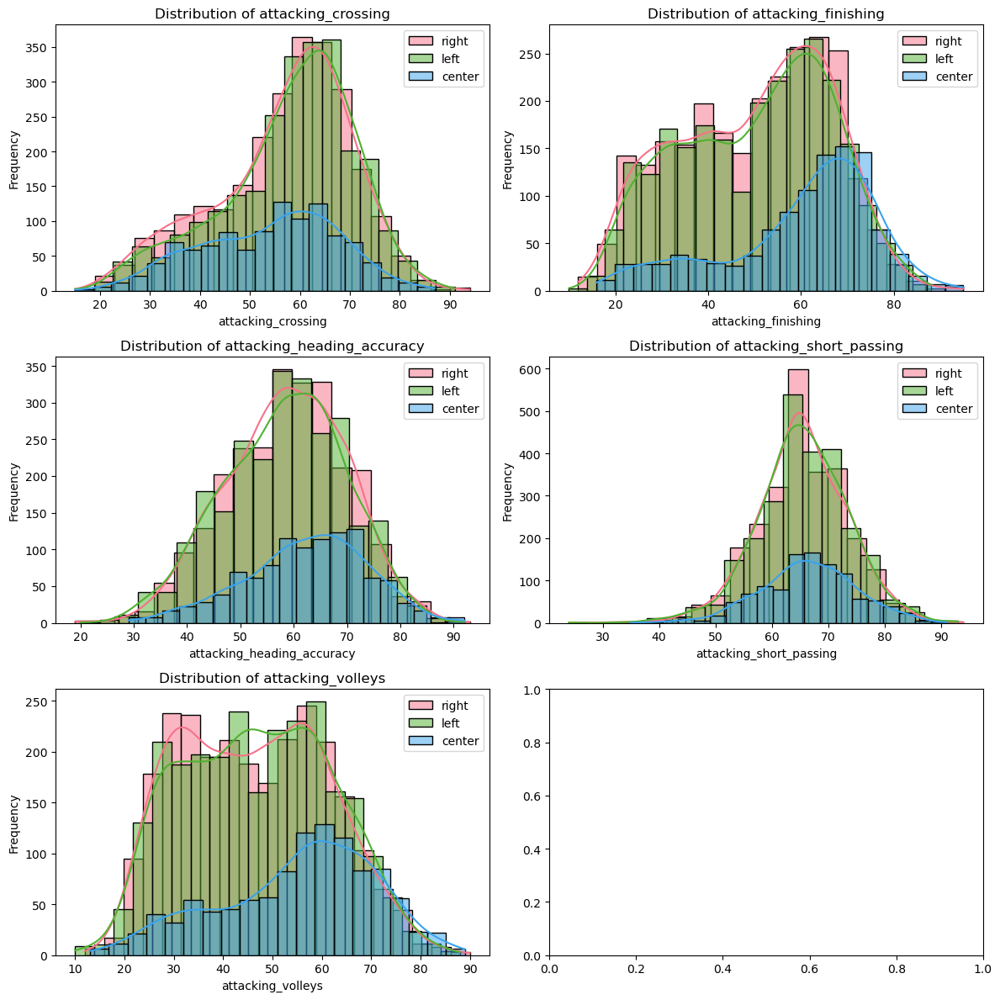

In [123]:

plot_distributions_stacked(all_dfs, ['attacking_crossing', 'attacking_finishing',
   'attacking_heading_accuracy', 'attacking_short_passing',
   'attacking_volleys'],  labels=labels)

'attacking_finishing','attacking_heading_accuracy','attacking_volleys'

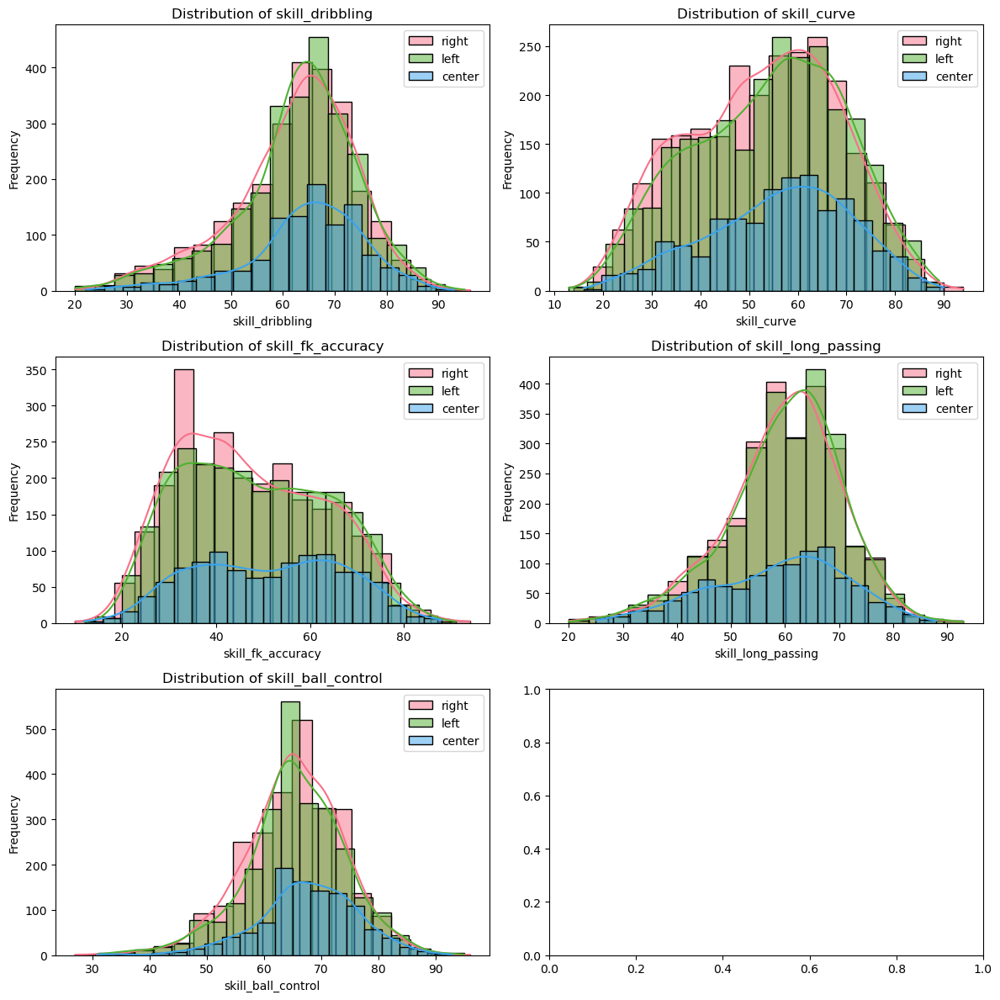

In [124]:

plot_distributions_stacked(all_dfs, ['skill_dribbling', 'skill_curve',
   'skill_fk_accuracy', 'skill_long_passing', 'skill_ball_control'],  labels=labels)

 'skill_curve','skill_fk_accuracy'

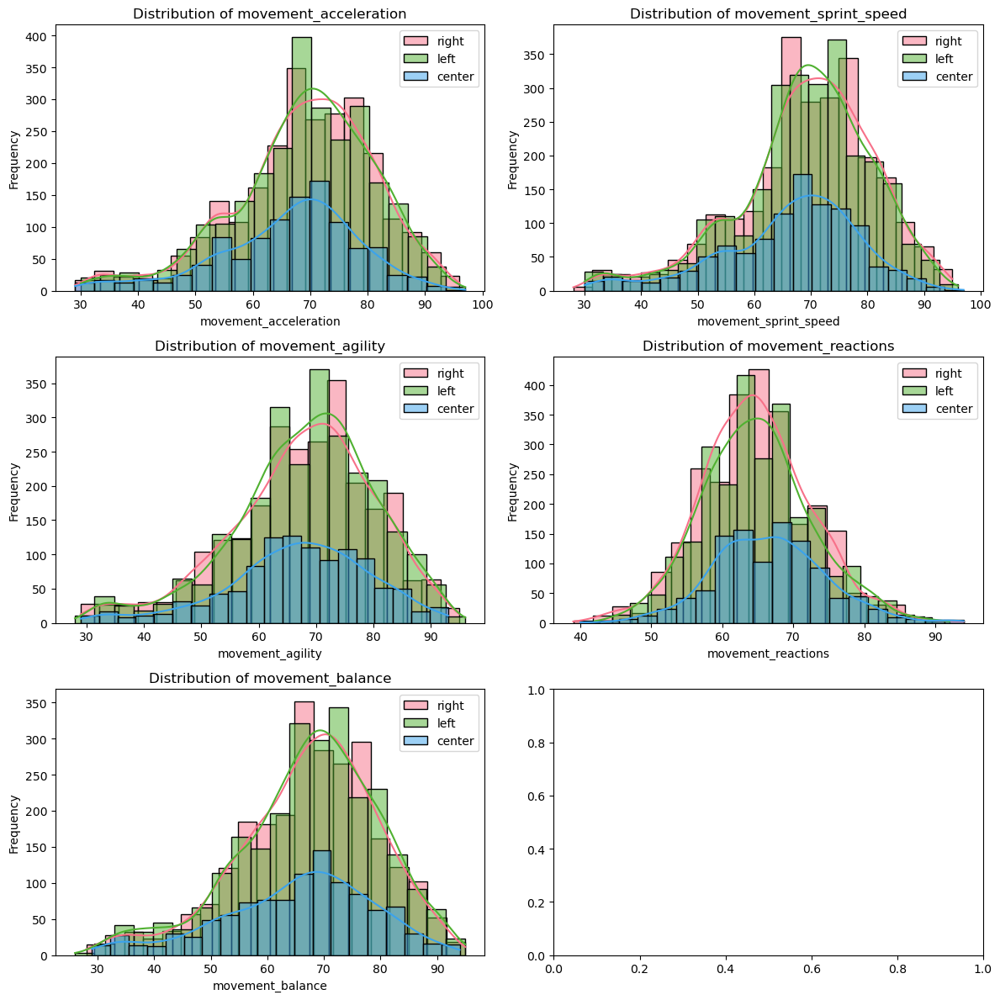

In [125]:

plot_distributions_stacked(all_dfs, ['movement_acceleration', 'movement_sprint_speed', 'movement_agility',
   'movement_reactions', 'movement_balance'],  labels=labels)

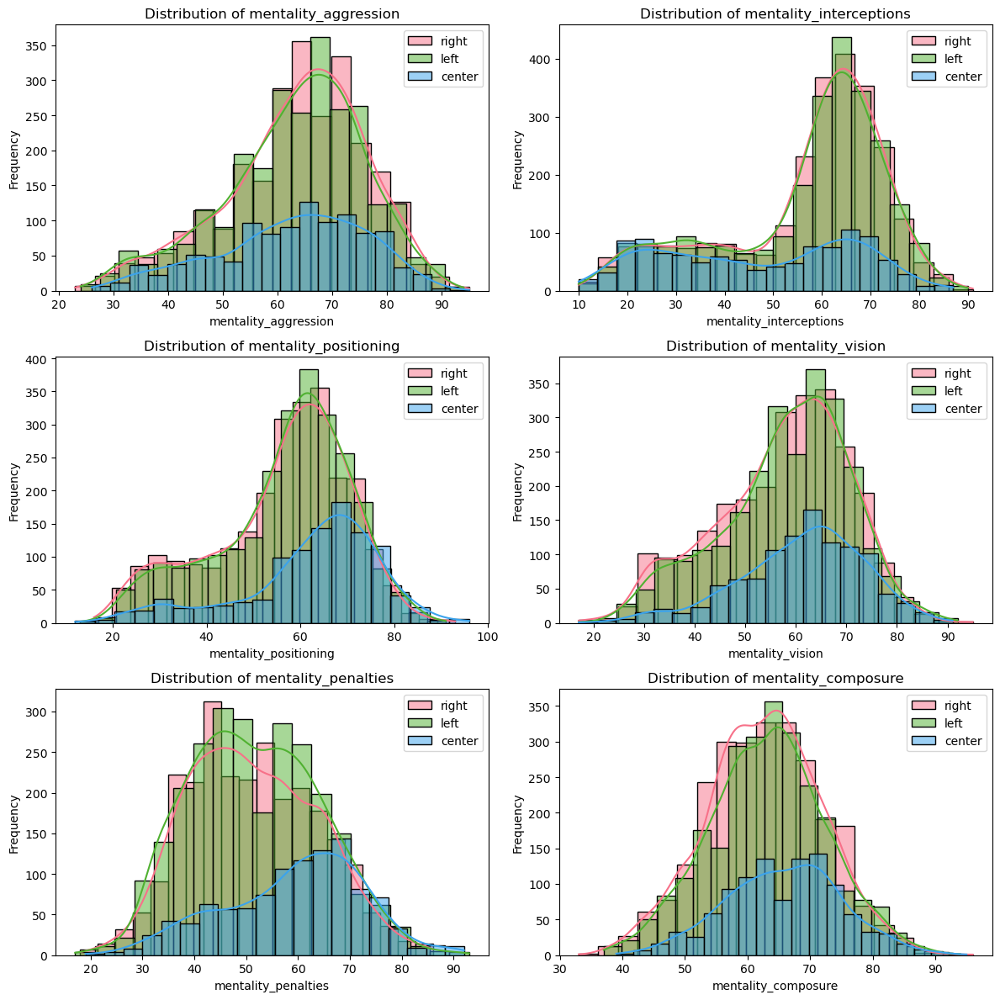

In [126]:

plot_distributions_stacked(all_dfs, ['mentality_aggression', 'mentality_interceptions',
   'mentality_positioning', 'mentality_vision', 'mentality_penalties',
   'mentality_composure'],  labels=labels)

'mentality_interceptions', 'mentality_penalties',

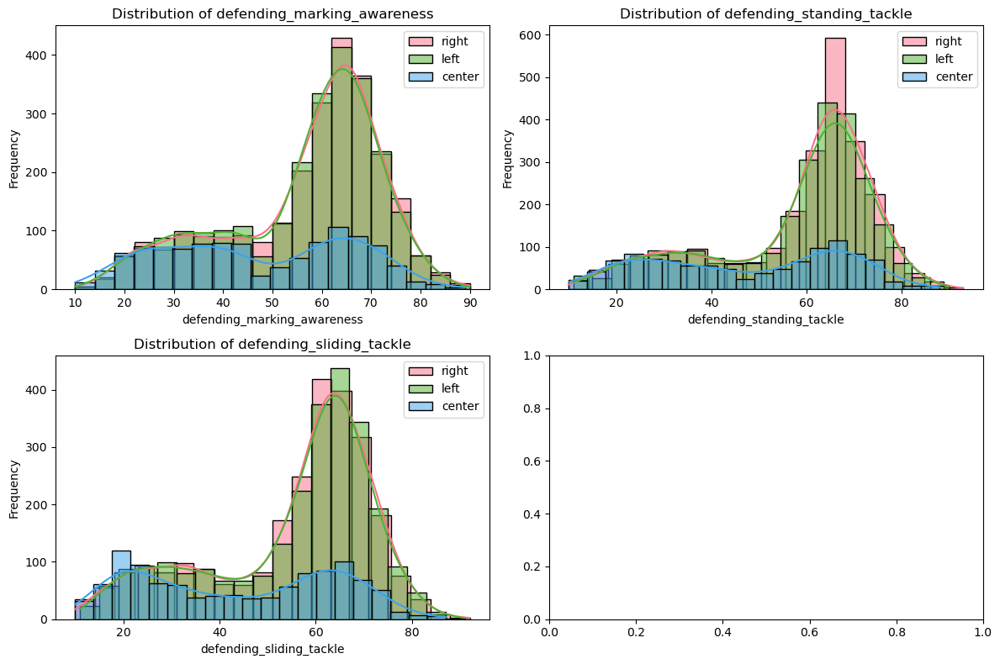

In [127]:

plot_distributions_stacked(all_dfs, ['defending_marking_awareness',
   'defending_standing_tackle', 'defending_sliding_tackle'],  labels=labels)

'defending_marking_awareness','defending_standing_tackle', 'defending_sliding_tackle'

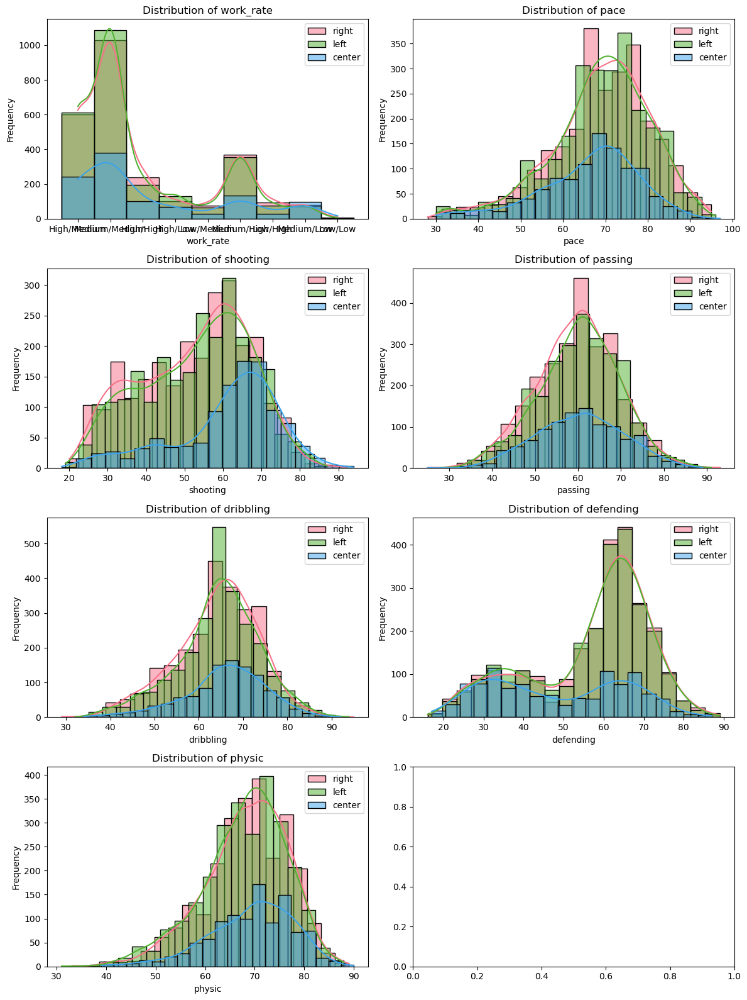

In [128]:

plot_distributions_stacked(all_dfs, ['work_rate',  'pace',
   'shooting', 'passing', 'dribbling', 'defending', 'physic', 
   ],  labels=labels)

'shooting',  'defending'

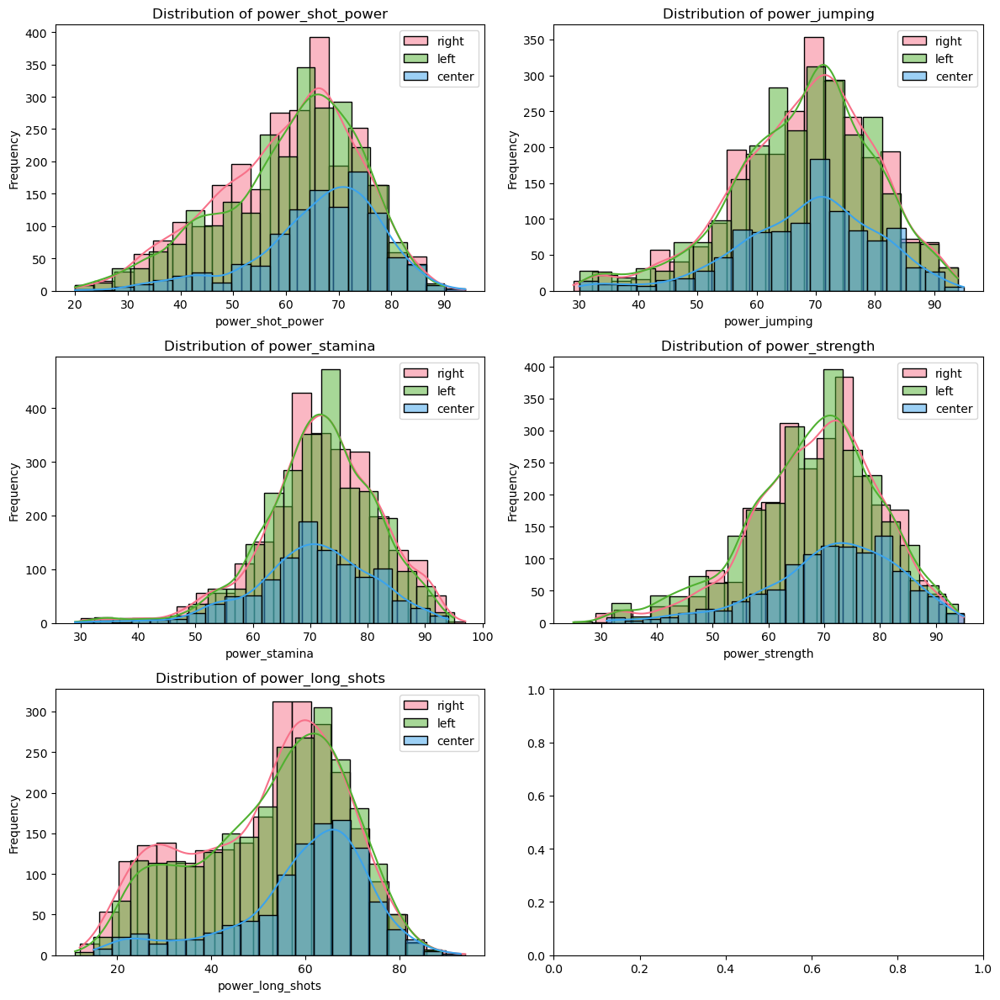

In [129]:

plot_distributions_stacked(all_dfs, ['power_shot_power',
       'power_jumping', 'power_stamina', 'power_strength', 'power_long_shots'],  labels=labels)

'power_long_shots'

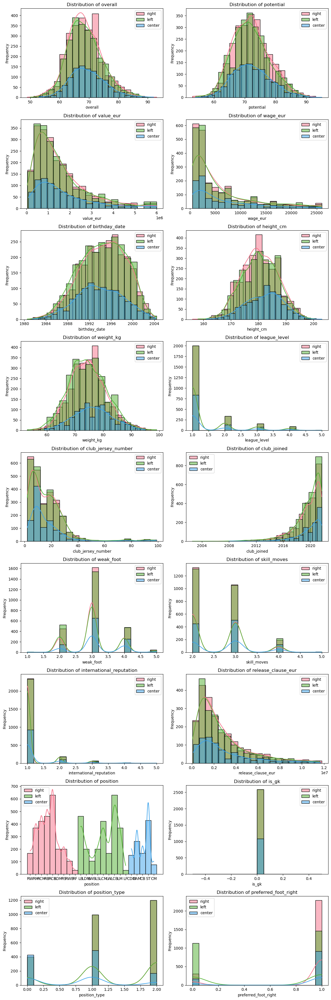

In [130]:
non_skill_cols = ['overall', 'potential', 'value_eur', 'wage_eur', 'birthday_date',
       'height_cm', 'weight_kg', 'league_level', 'club_jersey_number',
       'club_joined', 'weak_foot', 'skill_moves',
       'international_reputation',  'release_clause_eur', 'position',
       'is_gk', 'position_type', 'preferred_foot_right']

plot_distributions_stacked(all_dfs, non_skill_cols,  labels=labels)

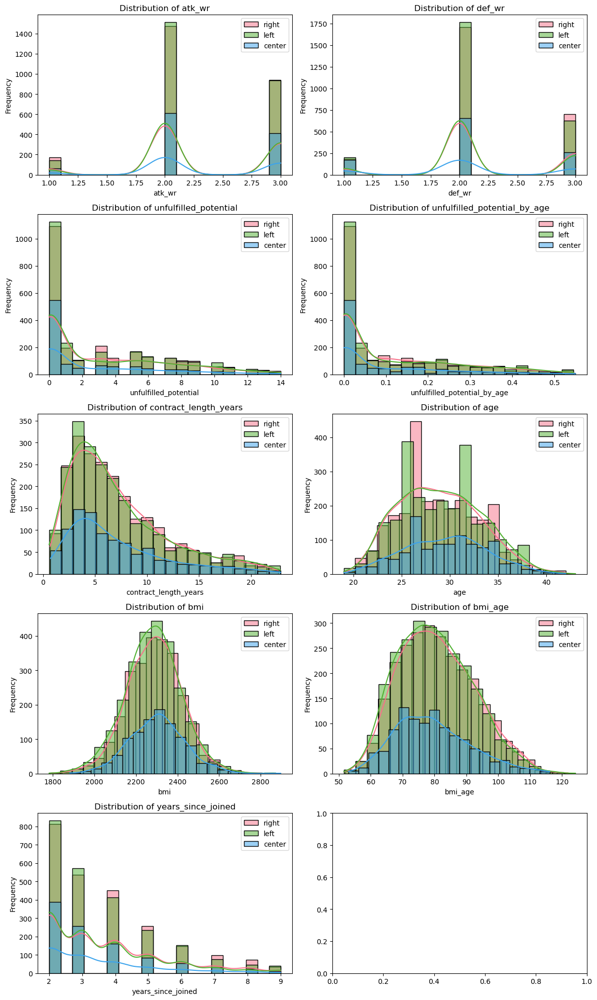

In [131]:
new_feature_cols = ['atk_wr','def_wr','unfulfilled_potential', 'unfulfilled_potential_by_age', 'contract_length_years', 'age', 'bmi', 'bmi_age', 'years_since_joined']

plot_distributions_stacked(all_dfs, new_feature_cols,  labels=labels)

final cols: 

In [132]:
side_of_field_columns = list(set(['attacking_finishing','attacking_heading_accuracy','attacking_volleys',
'skill_curve','skill_fk_accuracy','mentality_interceptions', 'mentality_penalties',
'power_long_shots', 'skill_moves','preferred_foot_right','weak_foot','height_cm',
'defending_marking_awareness','defending_standing_tackle', 'defending_sliding_tackle','defending','shooting']))

In [133]:
all_cols_train = side_of_field_columns

all_cols_train.append('position')
all_cols_train.append('position_type')
all_cols_train.append('side_of_the_field')

_df_train_final = _df_train_final[all_cols_train]

# Imputer

In [134]:

NaN_cols =  _df_train_final.columns[_df_train_final.isna().any()].tolist()


# Perform KNN imputation
imputer = KNNImputer(n_neighbors = 5)

imputed_temp_train = imputer.fit_transform(_df_train_final[NaN_cols])

# Convert the imputed data back to DataFrame
filled_df_train = pd.DataFrame(imputed_temp_train, columns=NaN_cols)

filled_df_train.index = _df_train_final.index

_df_train_final[NaN_cols] = filled_df_train  



display(_df_train_final.columns[_df_train_final.isna().any()].tolist())

[]

# Scale Features

In [135]:
_df_train_final.columns

Index(['defending_sliding_tackle', 'preferred_foot_right',
       'defending_marking_awareness', 'mentality_interceptions',
       'skill_fk_accuracy', 'power_long_shots', 'skill_curve', 'skill_moves',
       'height_cm', 'attacking_volleys', 'attacking_finishing', 'shooting',
       'attacking_heading_accuracy', 'weak_foot', 'mentality_penalties',
       'defending', 'defending_standing_tackle', 'position', 'position_type',
       'side_of_the_field'],
      dtype='object')

In [136]:
cols_to_scale = ['skill_curve', 'attacking_volleys', 'skill_moves', 'height_cm',
       'attacking_finishing', 'attacking_heading_accuracy', 'power_long_shots',
       'defending_standing_tackle',
       'mentality_penalties', 'weak_foot', 'defending_sliding_tackle',
       'shooting', 'mentality_interceptions', 'defending',
       'defending_marking_awareness', 'skill_fk_accuracy']

_df_train_final = scale_column(_df_train_final, cols_to_scale)
display(_df_train_final.head())

,defending_sliding_tackle,preferred_foot_right,defending_marking_awareness,mentality_interceptions,skill_fk_accuracy,power_long_shots,skill_curve,skill_moves,height_cm,attacking_volleys,attacking_finishing,shooting,attacking_heading_accuracy,weak_foot,mentality_penalties,defending,defending_standing_tackle,position,position_type,side_of_the_field
id,,,,,,,,,,,,,,,,,,,,
216302,0.740508,1,0.698032,1.371699,0.713922,0.837127,0.740170,0.701682,-0.798419,-0.210520,-0.420111,-0.167757,0.056447,2.901008,0.518231,0.769319,0.658030,LB,2,1
237867,0.400897,1,0.698032,0.723671,-0.239234,-0.406501,-0.785564,-0.581633,0.221664,-0.769556,-0.879550,-1.188830,0.233840,-0.002737,-0.247934,0.500562,0.418763,LDM,1,1
253472,0.449413,0,0.443617,0.524278,-0.575643,-1.131951,0.304246,0.701682,-0.506966,-0.434135,-0.930599,-1.407632,-0.120946,-0.002737,-1.205640,0.231805,0.275203,LWB,2,1
223994,-1.491218,1,-1.795240,-1.669046,0.433582,0.992581,-0.131678,0.701682,0.950295,1.410685,1.519744,1.436786,1.179935,-0.002737,1.603630,-2.119819,-1.447516,LS,0,1
251635,0.400897,0,0.647149,0.574126,0.713922,0.888945,0.140774,-0.581633,-0.361240,0.068998,-0.522208,-0.094823,-0.357470,-1.454610,0.135148,0.366184,0.418763,LB,2,1


In [137]:
_df_train_final['position_simple'] = None

_df_train_final.loc[_df_train_final.position_type == 0, 'position_simple'] = _df_train_final.loc[_df_train_final.position_type == 0, 'position'].str[-1]

_df_train_final.loc[(_df_train_final.position_type == 1) & (_df_train_final.position.str.len() == 3), 'position_simple'] = _df_train_final.loc[(_df_train_final.position_type == 1) & (_df_train_final.position.str.len() == 3), 'position'].str[-2:]
_df_train_final.loc[(_df_train_final.position_type == 1) & (_df_train_final.position.str.len() < 3), 'position_simple'] = _df_train_final.loc[(_df_train_final.position_type == 1) & (_df_train_final.position.str.len() < 3), 'position_simple'].fillna('M')


_df_train_final.loc[(_df_train_final.position_type == 2) & (_df_train_final.position.str.len() == 3), 'position_simple'] = _df_train_final.loc[(_df_train_final.position_type == 2) & (_df_train_final.position.str.len() == 3), 'position'].str[-2:]
_df_train_final.loc[(_df_train_final.position_type == 2) & (_df_train_final.position.str.len() < 3), 'position_simple'] = _df_train_final.loc[(_df_train_final.position_type == 2) & (_df_train_final.position.str.len() < 3), 'position_simple'].fillna('B')

In [138]:
_df_train_final = _df_train_final.loc[_df_train_final.position != 'GK']

Data is clean, encoded and scaled so we can move to the data create and model development
# Final Model Development

We use the tpot and xgboost again to determine if a wing is a left wing or a right wing etc.

In [139]:
# create the datasets: 
side_of_field_columns = ['skill_curve',
 'attacking_volleys',
 'skill_moves',
 'height_cm',
 'attacking_finishing',
 'attacking_heading_accuracy',
 'power_long_shots',
 'preferred_foot_right',
 'defending_standing_tackle',
 'mentality_penalties',
 'weak_foot',
 'defending_sliding_tackle',
 'shooting',
 'mentality_interceptions',
 'defending',
 'defending_marking_awareness',
 'skill_fk_accuracy']

In [140]:
model_dict = {}
model_dict_tpot = {}

smote = SMOTE(sampling_strategy='auto', random_state = 168)

# train model on predicting attackers

xgb_model = xgb.XGBClassifier()

# Define the parameter grid for random search
param_dist = {
    'n_estimators': [10,20,40,50,60,70,80,90,100, 200, 300, 400,500, 600, 700],
    'learning_rate': [0.01, 0.01, 0.05, 0.1, 0.2],
    'max_depth': [3, 5, 6, 10],
    'min_child_weight': [1, 3, 5, 7],
    'subsample': [0.5, 0.75, 1.0],
    'colsample_bytree': [0.3, 0.5, 0.7, 1.0]
}

for position_simple in _df_train_final.position_simple.unique():
    try:
        print(position_simple)
        side_of_field_X = _df_train_final.loc[_df_train_final.position_simple == position_simple, side_of_field_columns]
        side_of_field_y = _df_train_final.loc[_df_train_final.position_simple == position_simple,'side_of_the_field']

        # Fit and transform the data using SMOTE to perform over-sampling
        side_of_field_X, side_of_field_y = smote.fit_resample(side_of_field_X, side_of_field_y)

        X_train, X_test, y_train, y_test = train_test_split(side_of_field_X, side_of_field_y, test_size=0.2, random_state=42)

        # Define the RandomizedSearchCV object
        random_search_side_of_field = RandomizedSearchCV(
            xgb_model, param_distributions=param_dist, n_iter=10, scoring=f1_scorer, cv=5, random_state = 168
        )

        # Fit the RandomizedSearchCV object to the data
        random_search_side_of_field.fit(X_train, y_train)


        tpot.fit(X_train_def, y_train_def)

        # Define the RandomizedSearchCV object
        random_search_side_of_field_tpot = tpot.fitted_pipeline_

        # Print the best parameters and corresponding accuracy
        print("Best Parameters: ", random_search_side_of_field.best_params_)
        print("Best Accuracy: ", random_search_side_of_field.best_score_)

        # Evaluate the best model on the test set
        best_model = random_search_side_of_field.best_estimator_
        test_accuracy = best_model.score(X_test, y_test)
        print("Test Accuracy: ", test_accuracy)

        model_dict[position_simple] = random_search_side_of_field
        model_dict_tpot[position_simple] = random_search_side_of_field_tpot
    except:
        print('has only one side available')


B


Optimization Progress:   0%|          | 0/210 [00:00<?, ?pipeline/s]


Generation 1 - Current best internal CV score: 0.817344595307004

Generation 2 - Current best internal CV score: 0.8266311734733289

Generation 3 - Current best internal CV score: 0.8284617293594136

Generation 4 - Current best internal CV score: 0.8284617293594136

Generation 5 - Current best internal CV score: 0.8424854447433887

Generation 6 - Current best internal CV score: 0.84284293772055

Generation 7 - Current best internal CV score: 0.84284293772055

Generation 8 - Current best internal CV score: 0.8438528142520492

Generation 9 - Current best internal CV score: 0.8442959947406783

Generation 10 - Current best internal CV score: 0.8442959947406783

Generation 11 - Current best internal CV score: 0.8445935590445934

Generation 12 - Current best internal CV score: 0.8445935590445934

Generation 13 - Current best internal CV score: 0.8448414480681656

Generation 14 - Current best internal CV score: 0.8452676072189188

Generation 15 - Current best internal CV score: 0.84526760721

Optimization Progress:   0%|          | 0/210 [00:00<?, ?pipeline/s]


Generation 1 - Current best internal CV score: 0.817344595307004

Generation 2 - Current best internal CV score: 0.8266311734733289

Generation 3 - Current best internal CV score: 0.8284617293594136

Generation 4 - Current best internal CV score: 0.8284617293594136

Generation 5 - Current best internal CV score: 0.8424854447433887

Generation 6 - Current best internal CV score: 0.84284293772055

Generation 7 - Current best internal CV score: 0.84284293772055

Generation 8 - Current best internal CV score: 0.8438528142520492

Generation 9 - Current best internal CV score: 0.8442959947406783

Generation 10 - Current best internal CV score: 0.8442959947406783

Generation 11 - Current best internal CV score: 0.8445935590445934

Generation 12 - Current best internal CV score: 0.8445935590445934

Generation 13 - Current best internal CV score: 0.8448414480681656

Generation 14 - Current best internal CV score: 0.8452676072189188

Generation 15 - Current best internal CV score: 0.84526760721

Optimization Progress:   0%|          | 0/210 [00:00<?, ?pipeline/s]


Generation 1 - Current best internal CV score: 0.817344595307004

Generation 2 - Current best internal CV score: 0.8266311734733289

Generation 3 - Current best internal CV score: 0.8284617293594136

Generation 4 - Current best internal CV score: 0.8284617293594136

Generation 5 - Current best internal CV score: 0.8424854447433887

Generation 6 - Current best internal CV score: 0.84284293772055

Generation 7 - Current best internal CV score: 0.84284293772055

Generation 8 - Current best internal CV score: 0.8438528142520492

Generation 9 - Current best internal CV score: 0.8442959947406783

Generation 10 - Current best internal CV score: 0.8442959947406783

Generation 11 - Current best internal CV score: 0.8445935590445934

Generation 12 - Current best internal CV score: 0.8445935590445934

Generation 13 - Current best internal CV score: 0.8448414480681656

Generation 14 - Current best internal CV score: 0.8452676072189188

Generation 15 - Current best internal CV score: 0.84526760721

Optimization Progress:   0%|          | 0/210 [00:00<?, ?pipeline/s]


Generation 1 - Current best internal CV score: 0.817344595307004

Generation 2 - Current best internal CV score: 0.8266311734733289

Generation 3 - Current best internal CV score: 0.8284617293594136

Generation 4 - Current best internal CV score: 0.8284617293594136

Generation 5 - Current best internal CV score: 0.8424854447433887

Generation 6 - Current best internal CV score: 0.84284293772055

Generation 7 - Current best internal CV score: 0.84284293772055

Generation 8 - Current best internal CV score: 0.8438528142520492

Generation 9 - Current best internal CV score: 0.8442959947406783

Generation 10 - Current best internal CV score: 0.8442959947406783

Generation 11 - Current best internal CV score: 0.8445935590445934

Generation 12 - Current best internal CV score: 0.8445935590445934

Generation 13 - Current best internal CV score: 0.8448414480681656

Generation 14 - Current best internal CV score: 0.8452676072189188

Generation 15 - Current best internal CV score: 0.84526760721

Optimization Progress:   0%|          | 0/210 [00:00<?, ?pipeline/s]


Generation 1 - Current best internal CV score: 0.817344595307004

Generation 2 - Current best internal CV score: 0.8266311734733289

Generation 3 - Current best internal CV score: 0.8284617293594136

Generation 4 - Current best internal CV score: 0.8284617293594136

Generation 5 - Current best internal CV score: 0.8424854447433887

Generation 6 - Current best internal CV score: 0.84284293772055

Generation 7 - Current best internal CV score: 0.84284293772055

Generation 8 - Current best internal CV score: 0.8438528142520492

Generation 9 - Current best internal CV score: 0.8442959947406783

Generation 10 - Current best internal CV score: 0.8442959947406783

Generation 11 - Current best internal CV score: 0.8445935590445934

Generation 12 - Current best internal CV score: 0.8445935590445934

Generation 13 - Current best internal CV score: 0.8448414480681656

Generation 14 - Current best internal CV score: 0.8452676072189188

Generation 15 - Current best internal CV score: 0.84526760721

Optimization Progress:   0%|          | 0/210 [00:00<?, ?pipeline/s]


Generation 1 - Current best internal CV score: 0.817344595307004

Generation 2 - Current best internal CV score: 0.8266311734733289

Generation 3 - Current best internal CV score: 0.8284617293594136

Generation 4 - Current best internal CV score: 0.8284617293594136

Generation 5 - Current best internal CV score: 0.8424854447433887

Generation 6 - Current best internal CV score: 0.84284293772055

Generation 7 - Current best internal CV score: 0.84284293772055

Generation 8 - Current best internal CV score: 0.8438528142520492

Generation 9 - Current best internal CV score: 0.8442959947406783

Generation 10 - Current best internal CV score: 0.8442959947406783

Generation 11 - Current best internal CV score: 0.8445935590445934

Generation 12 - Current best internal CV score: 0.8445935590445934

Generation 13 - Current best internal CV score: 0.8448414480681656

Generation 14 - Current best internal CV score: 0.8452676072189188

Generation 15 - Current best internal CV score: 0.84526760721

Optimization Progress:   0%|          | 0/210 [00:00<?, ?pipeline/s]


Generation 1 - Current best internal CV score: 0.817344595307004

Generation 2 - Current best internal CV score: 0.8266311734733289

Generation 3 - Current best internal CV score: 0.8284617293594136

Generation 4 - Current best internal CV score: 0.8284617293594136

Generation 5 - Current best internal CV score: 0.8424854447433887

Generation 6 - Current best internal CV score: 0.84284293772055

Generation 7 - Current best internal CV score: 0.84284293772055

Generation 8 - Current best internal CV score: 0.8438528142520492

Generation 9 - Current best internal CV score: 0.8442959947406783

Generation 10 - Current best internal CV score: 0.8442959947406783

Generation 11 - Current best internal CV score: 0.8445935590445934

Generation 12 - Current best internal CV score: 0.8445935590445934

Generation 13 - Current best internal CV score: 0.8448414480681656

Generation 14 - Current best internal CV score: 0.8452676072189188

Generation 15 - Current best internal CV score: 0.84526760721

Optimization Progress:   0%|          | 0/210 [00:00<?, ?pipeline/s]


Generation 1 - Current best internal CV score: 0.817344595307004

Generation 2 - Current best internal CV score: 0.8266311734733289

Generation 3 - Current best internal CV score: 0.8284617293594136

Generation 4 - Current best internal CV score: 0.8284617293594136

Generation 5 - Current best internal CV score: 0.8424854447433887

Generation 6 - Current best internal CV score: 0.84284293772055

Generation 7 - Current best internal CV score: 0.84284293772055

Generation 8 - Current best internal CV score: 0.8438528142520492

Generation 9 - Current best internal CV score: 0.8442959947406783

Generation 10 - Current best internal CV score: 0.8442959947406783

Generation 11 - Current best internal CV score: 0.8445935590445934

Generation 12 - Current best internal CV score: 0.8445935590445934

Generation 13 - Current best internal CV score: 0.8448414480681656

Generation 14 - Current best internal CV score: 0.8452676072189188

Generation 15 - Current best internal CV score: 0.84526760721

Optimization Progress:   0%|          | 0/210 [00:00<?, ?pipeline/s]


Generation 1 - Current best internal CV score: 0.817344595307004

Generation 2 - Current best internal CV score: 0.8266311734733289

Generation 3 - Current best internal CV score: 0.8284617293594136

Generation 4 - Current best internal CV score: 0.8284617293594136

Generation 5 - Current best internal CV score: 0.8424854447433887

Generation 6 - Current best internal CV score: 0.84284293772055

Generation 7 - Current best internal CV score: 0.84284293772055

Generation 8 - Current best internal CV score: 0.8438528142520492

Generation 9 - Current best internal CV score: 0.8442959947406783

Generation 10 - Current best internal CV score: 0.8442959947406783

Generation 11 - Current best internal CV score: 0.8445935590445934

Generation 12 - Current best internal CV score: 0.8445935590445934

Generation 13 - Current best internal CV score: 0.8448414480681656

Generation 14 - Current best internal CV score: 0.8452676072189188

Generation 15 - Current best internal CV score: 0.84526760721

# Putting it all together

now we process the test data and run the three models one at a time on the test data set

in the future we could probably just use the same columns for all of the models..

In [141]:
# gather all of the columns from the models

all_cols = list(set(collected_cols + attacker_cols + midfielder_cols + defender_cols + side_of_field_columns))
print(list(all_cols))

['mentality_aggression', 'preferred_foot_right', 'league_level', 'club_jersey_number', 'release_clause_eur', 'bmi_age', 'international_reputation', 'shooting', 'attacking_short_passing', 'age', 'attacking_crossing', 'unfulfilled_potential', 'wage_eur', 'movement_agility', 'power_stamina', 'mentality_interceptions', 'movement_sprint_speed', 'power_jumping', 'physic', 'skill_dribbling', 'skill_long_passing', 'attacking_finishing', 'attacking_heading_accuracy', 'passing', 'mentality_penalties', 'is_gk', 'skill_ball_control', 'mentality_positioning', 'defending_sliding_tackle', 'dribbling', 'skill_moves', 'skill_fk_accuracy', 'skill_curve', 'height_cm', 'def_wr', 'atk_wr', 'weak_foot', 'defending_standing_tackle', 'power_shot_power', 'defending_marking_awareness', 'power_long_shots', 'attacking_volleys', 'pace', 'weight_kg', 'power_strength', 'mentality_vision', 'movement_acceleration', 'defending', 'movement_balance']


In [142]:

all_cols = list(set(collected_cols + attacker_cols + midfielder_cols + defender_cols + side_of_field_columns))

try:
    all_cols.remove('position')
    all_cols.remove('position_type')
except Exception as e:
    print('erg')

len(all_cols)

erg


49

We need to remove the goalkeepers from the test data set

In [143]:
test_gk = _df_test_final_final.loc[_df_test_final_final.is_gk == 1]
_df_test_final_final = _df_test_final_final.loc[_df_test_final_final.is_gk == 0]
display(_df_test_final_final)

,overall,potential,value_eur,wage_eur,birthday_date,height_cm,weight_kg,league_level,club_jersey_number,club_joined,...,unfulfilled_potential,contract_length_years,age,unfulfilled_potential_by_age,bmi,bmi_age,years_since_joined,atk_wr,def_wr,preferred_foot_right
id,,,,,,,,,,,,,,,,,,,,,
215562,63,63,475000.0,3000,1995-07-07,171,67,4,24,2019-06-24,...,0,NaN,28,0.000000,2291.303307,81.832261,4.0,3,2,1
248311,64,64,500000.0,950,1991-07-14,186,84,1,44,2020-09-12,...,0,NaN,32,0.000000,2428.026361,75.875824,3.0,2,2,0
223933,64,70,925000.0,2000,1997-05-23,197,87,3,29,2021-01-05,...,6,NaN,26,0.230769,2241.748048,86.221079,2.0,2,2,1
232546,72,72,2300000.0,13000,1991-09-19,172,64,1,8,2019-07-03,...,0,NaN,32,0.000000,2163.331531,67.604110,4.0,3,2,1
189217,63,63,450000.0,2000,1991-02-03,178,68,1,8,2019-01-31,...,0,NaN,32,0.000000,2146.193662,67.068552,4.0,3,2,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
205601,72,72,2300000.0,17000,1992-01-10,165,65,1,3,2021-07-17,...,0,NaN,31,0.000000,2387.511478,77.016499,2.0,2,1,0
223752,68,74,1700000.0,2000,1996-04-17,180,70,1,2,2019-01-01,...,6,NaN,27,0.222222,2160.493827,80.018290,4.0,1,3,1
192450,65,65,700000.0,6000,1990-10-18,185,80,4,9,2021-07-01,...,0,NaN,33,0.000000,2337.472608,70.832503,2.0,1,1,1


# Impute test data set

In [144]:
 # impute
_df_test_final_final = _df_test_final_final[all_cols]

NaN_cols =  _df_test_final_final.columns[_df_test_final_final.isna().any()].tolist()

print(NaN_cols)
# Perform KNN imputation
imputer = KNNImputer(n_neighbors = 5)

imputed_temp_test = imputer.fit_transform(_df_test_final_final[NaN_cols])

# Convert the imputed data back to DataFrame
filled_df_test = pd.DataFrame(imputed_temp_test, columns=NaN_cols)

filled_df_test.index = _df_test_final_final.index

_df_test_final_final[NaN_cols] = filled_df_test  


display(_df_test_final_final.columns[_df_test_final_final.isna().any()].tolist())

['release_clause_eur']


[]

# Scale test data set

In [145]:
all_cols.remove('preferred_foot_right')
all_cols.remove('atk_wr')
all_cols.remove('club_jersey_number')

_df_test_final_final = scale_column(_df_test_final_final, all_cols)
display(_df_test_final_final.head())

,mentality_aggression,preferred_foot_right,league_level,club_jersey_number,release_clause_eur,bmi_age,international_reputation,shooting,attacking_short_passing,age,...,defending_marking_awareness,power_long_shots,attacking_volleys,pace,weight_kg,power_strength,mentality_vision,movement_acceleration,defending,movement_balance
id,,,,,,,,,,,,,,,,,,,,,
215562,-0.961757,1,3.425817,24,-0.419941,0.065024,-0.323077,-1.515072,-1.118697,-0.197271,...,-0.101402,-1.602175,-1.643802,0.644031,-1.189286,-1.288845,-1.184546,0.477151,-0.009144,1.642590
248311,0.181136,0,-0.465211,44,-0.428480,-0.458027,-0.323077,-1.159610,-1.245195,0.776164,...,0.444134,-0.974807,0.453284,-0.349487,1.311042,1.210469,-0.859496,-0.387801,0.373240,-1.726794
223933,-0.352214,1,2.128808,29,-0.383325,0.450419,-0.323077,0.546605,-1.245195,-0.683988,...,-1.980471,0.154457,0.846488,0.734350,1.752276,0.853424,-0.453182,0.390656,-1.857331,-1.491721
232546,-2.942770,1,-0.465211,8,-0.273858,-1.184389,-0.323077,1.328620,0.652271,0.776164,...,-0.768169,1.409194,1.174158,0.282751,-1.630520,0.496380,1.415859,0.563646,-0.965103,0.545581
189217,-0.504600,1,-0.465211,8,-0.422295,-1.231418,-0.323077,0.404420,-0.233213,0.776164,...,0.019828,0.279931,0.322216,1.185949,-1.042208,-0.306972,0.278182,1.255608,-0.072874,0.545581


In [146]:
collected_cols_train.remove('position')
collected_cols_train.remove('position_type')

now we start with the position type prediction for the regular and tpot models

In [147]:

player_type_X = _df_test_final_final[collected_cols_train]
player_type_pred = random_search_player_type.predict(player_type_X)
_df_test_final_final['position_type'] = player_type_pred
_df_test_final_final.position_type.unique()

array([2, 0, 1])

In [148]:
player_type_X = _df_test_final_final[collected_cols_train]
player_type_pred = random_search_player_type_tpot.predict(player_type_X)
_df_test_final_final['position_type_tpot'] = player_type_pred
_df_test_final_final.position_type_tpot.unique()

/Users/andrewbennett/anaconda3/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(
/Users/andrewbennett/anaconda3/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


array([2, 0, 1])

next we predict position_simple for each position_type

In [149]:
_df_test_final_final['position_simple'] = None

try:
    attackers_X = _df_test_final_final.loc[_df_test_final_final.position_type == 0, attacker_cols]
    attackers_pred = random_search_attackers.predict(attackers_X)
    _df_test_final_final.loc[_df_test_final_final.position_type == 0, 'position_simple'] = attackers_pred
except Exception as e:
    print('erg')

try:
    midfielders_X = _df_test_final_final.loc[_df_test_final_final.position_type == 1, midfielder_cols]
    midfielder_pred = random_search_midfielders.predict(midfielders_X)
    _df_test_final_final.loc[_df_test_final_final.position_type == 1, 'position_simple'] = midfielder_pred
except Exception as e:
    print('erg')

try:
    defenders_X = _df_test_final_final.loc[_df_test_final_final.position_type == 2, defender_cols]
    defenders_pred = random_search_defenders.predict(defenders_X)
    _df_test_final_final.loc[_df_test_final_final.position_type == 2, 'position_simple'] = defenders_pred
except Exception as e:
    print('erg')

display(_df_test_final_final.position_simple.unique())

array([0, 2, 1, 3], dtype=object)

In [150]:
_df_test_final_final['position_simple_tpot'] = None

try:
    attackers_X = _df_test_final_final.loc[_df_test_final_final.position_type == 0, attacker_cols]
    attackers_pred = random_search_attackers_tpot.predict(attackers_X)
    _df_test_final_final.loc[_df_test_final_final.position_type == 0, 'position_simple_tpot'] = attackers_pred
except Exception as e:
    print('erg')

try:
    midfielders_X = _df_test_final_final.loc[_df_test_final_final.position_type == 1, midfielder_cols]
    midfielder_pred = random_search_midfielders_tpot.predict(midfielders_X)
    _df_test_final_final.loc[_df_test_final_final.position_type == 1, 'position_simple_tpot'] = midfielder_pred
except Exception as e:
    print('erg')

try:
    defenders_X = _df_test_final_final.loc[_df_test_final_final.position_type == 2, defender_cols]
    defenders_pred = random_search_defenders_tpot.predict(defenders_X)
    _df_test_final_final.loc[_df_test_final_final.position_type == 2, 'position_simple_tpot'] = defenders_pred
except Exception as e:
    print('erg')

display(_df_test_final_final.position_simple.unique())

/Users/andrewbennett/anaconda3/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(
/Users/andrewbennett/anaconda3/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


array([0, 2, 1, 3], dtype=object)

now we decode the predicted simple_position 

In [151]:
_df_test_final_final['simple_position_decoded'] = None
_df_test_final_final.loc[(_df_test_final_final.position_type == 0),'simple_position_decoded'] = _df_test_final_final.loc[(_df_test_final_final.position_type == 0),'position_simple'].map(attackers_decoder)
_df_test_final_final.loc[(_df_test_final_final.position_type == 1),'simple_position_decoded'] = _df_test_final_final.loc[(_df_test_final_final.position_type == 1),'position_simple'].map(midfielders_decoder)
_df_test_final_final.loc[(_df_test_final_final.position_type == 2),'simple_position_decoded'] = _df_test_final_final.loc[(_df_test_final_final.position_type == 2),'position_simple'].map(defenders_decoder)

display(_df_test_final_final.simple_position_decoded.unique())

array(['B', 'CB', 'S', 'M', 'DM', 'CM', 'WB', 'AM'], dtype=object)

In [152]:
_df_test_final_final['simple_position_decoded_tpot'] = None
_df_test_final_final.loc[(_df_test_final_final.position_type == 0),'simple_position_decoded_tpot'] = _df_test_final_final.loc[(_df_test_final_final.position_type == 0),'position_simple_tpot'].map(attackers_decoder)
_df_test_final_final.loc[(_df_test_final_final.position_type == 1),'simple_position_decoded_tpot'] = _df_test_final_final.loc[(_df_test_final_final.position_type == 1),'position_simple_tpot'].map(midfielders_decoder)
_df_test_final_final.loc[(_df_test_final_final.position_type == 2),'simple_position_decoded_tpot'] = _df_test_final_final.loc[(_df_test_final_final.position_type == 2),'position_simple_tpot'].map(defenders_decoder)

display(_df_test_final_final.simple_position_decoded.unique())

array(['B', 'CB', 'S', 'M', 'DM', 'CM', 'WB', 'AM'], dtype=object)

now we predict the side of the field for each simple_position

In [153]:
_df_test_final_final['side_of_field'] = None

for position_simple in _df_test_final_final['simple_position_decoded']:
    if position_simple in model_dict.keys():
        _df_test_final_final.loc[_df_test_final_final.simple_position_decoded == position_simple, 'side_of_field'] = model_dict[position_simple].predict(_df_test_final_final.loc[_df_test_final_final.simple_position_decoded == position_simple,side_of_field_columns])
    else:
        if position_simple == 'AM':
            _df_test_final_final.loc[_df_test_final_final.simple_position_decoded == position_simple, 'side_of_field'] = 2
        elif position_simple == 'T':
            _df_test_final_final.loc[_df_test_final_final.simple_position_decoded == position_simple, 'side_of_field'] = 2
display(_df_test_final_final.side_of_field.unique())

array([0, 1, 2], dtype=object)

In [154]:
_df_test_final_final['side_of_field_tpot'] = None

for position_simple in _df_test_final_final['simple_position_decoded_tpot']:
    if position_simple in model_dict.keys():
        _df_test_final_final.loc[_df_test_final_final.simple_position_decoded_tpot == position_simple, 'side_of_field_tpot'] = model_dict[position_simple].predict(_df_test_final_final.loc[_df_test_final_final.simple_position_decoded_tpot == position_simple,side_of_field_columns])
    else:
        if position_simple == 'AM':
            _df_test_final_final.loc[_df_test_final_final.simple_position_decoded_tpot == position_simple, 'side_of_field_tpot'] = 2
        elif position_simple == 'T':
            _df_test_final_final.loc[_df_test_final_final.simple_position_decoded_tpot == position_simple, 'side_of_field_tpot'] = 2
display(_df_test_final_final.side_of_field_tpot.unique())

array([0, 1, 2], dtype=object)

now we decode the side of the fieldnd concatenate it with the simple_position to create the position

In [155]:

side_of_the_field_encoder = {'R':0,'L':1,'C':2,'S':2,'G':3}
side_of_the_field_decoder = {0:'R',1:'L',2:''}

_df_test_final_final['side_of_field_decoded'] = None
for index, row in _df_test_final_final.iterrows():
    if  _df_test_final_final.loc[index,'simple_position_decoded'][0] not in ['R','L','A']:
        if _df_test_final_final.loc[index,'simple_position_decoded'][0] == 'T':
            _df_test_final_final.loc[index,'side_of_field_decoded'] = 'S'
        elif _df_test_final_final.loc[index,'side_of_field'] in [0,1]:
            _df_test_final_final.loc[index,'side_of_field_decoded'] = side_of_the_field_decoder[_df_test_final_final.loc[index,'side_of_field']]
        elif _df_test_final_final.loc[index,'simple_position_decoded'][0] != 'C':
            _df_test_final_final.loc[index,'side_of_field_decoded'] = 'C'
        else:
            _df_test_final_final.loc[index,'side_of_field_decoded'] = ''
    elif _df_test_final_final.loc[index,'simple_position_decoded'][0] == 'A':
        _df_test_final_final.loc[index,'side_of_field_decoded'] = 'C'
    

_df_test_final_final['side_of_field_decoded'] = _df_test_final_final['side_of_field_decoded'].fillna('')


_df_test_final_final['position'] = _df_test_final_final['side_of_field_decoded'].str.cat(_df_test_final_final['simple_position_decoded'], sep='')

_df_test_final_final['position'].unique()

array(['RB', 'LCB', 'RS', 'RM', 'CDM', 'LCM', 'RCB', 'LB', 'RCM', 'CM',
       'LM', 'LS', 'LDM', 'LWB', 'RDM', 'RWB', 'CAM', 'CB'], dtype=object)

In [156]:

side_of_the_field_encoder = {'R':0,'L':1,'C':2,'S':2,'G':3}
side_of_the_field_decoder = {0:'R',1:'L',2:''}

_df_test_final_final['side_of_field_decoded_tpot'] = None
for index, row in _df_test_final_final.iterrows():
    if  _df_test_final_final.loc[index,'simple_position_decoded_tpot'][0] not in ['R','L','A']:
        if _df_test_final_final.loc[index,'simple_position_decoded_tpot'][0] == 'T':
            _df_test_final_final.loc[index,'side_of_field_decoded_tpot'] = 'S'
        elif _df_test_final_final.loc[index,'side_of_field_tpot'] in [0,1]:
            _df_test_final_final.loc[index,'side_of_field_decoded_tpot'] = side_of_the_field_decoder[_df_test_final_final.loc[index,'side_of_field_tpot']]
        elif _df_test_final_final.loc[index,'simple_position_decoded_tpot'][0] != 'C':
            _df_test_final_final.loc[index,'side_of_field_decoded_tpot'] = 'C'
        else:
            _df_test_final_final.loc[index,'side_of_field_decoded_tpot'] = ''
    elif _df_test_final_final.loc[index,'simple_position_decoded_tpot'][0] == 'A':
        _df_test_final_final.loc[index,'side_of_field_decoded_tpot'] = 'C'
    

_df_test_final_final['side_of_field_decoded_tpot'] = _df_test_final_final['side_of_field_decoded_tpot'].fillna('')


_df_test_final_final['position_tpot'] = _df_test_final_final['side_of_field_decoded_tpot'].str.cat(_df_test_final_final['simple_position_decoded_tpot'], sep='')

_df_test_final_final['position_tpot'].unique()

array(['RB', 'LCB', 'RS', 'RM', 'RCM', 'CDM', 'LCM', 'RCB', 'LB', 'CM',
       'LM', 'LS', 'ST', 'RDM', 'CAM', 'CB', 'LWB', 'LDM'], dtype=object)

last thing is to re-concat the goal keepers and csv the results

In [178]:
test_gk = pd.read_csv('test.csv')
test_gk = test_gk.loc[test_gk['goalkeeping_speed'] > 0]
test_gk['position'] = 'GK'
test_gk['position_tpot'] = 'GK'
test_gk.shape

(70, 71)

In [179]:
_df_test_final_final['id'] = _df_test_final_final.index
results = _df_test_final_final[['id','position']]

results = pd.concat([results,test_gk[['id','position']]], axis=0)

results

,id,position
215562,215562,RB
248311,248311,LCB
223933,223933,RS
232546,232546,RS
189217,189217,RM
...,...,...
729,233154,GK
730,210257,GK
737,208719,GK
741,223175,GK


In [180]:
name_file = datetime.now().strftime("%Y%m%d") + '_submission_' + datetime.now().strftime("%H%M") + '.csv'

print(name_file)
results.to_csv(name_file, index=False)

20231204_submission_1232.csv


In [181]:
_df_test_final_final['id'] = _df_test_final_final.index
results = _df_test_final_final[['id','position_tpot']]

results = pd.concat([results,test_gk[['id','position_tpot']]], axis=0)

results.columns = ['id','position']

In [182]:
name_file = datetime.now().strftime("%Y%m%d") + '_submission_tpot_' + datetime.now().strftime("%H%M") + '.csv'

print(name_file)
results.to_csv(name_file, index=False)

20231204_submission_tpot_1232.csv


In [167]:
results.isna().sum()

id               70
position_tpot     0
dtype: int64

,atk_wr,attacking_volleys,skill_curve,mentality_positioning,wage_eur,club_jersey_number,preferred_foot_right,skill_long_passing,weak_foot,mentality_aggression,...,skill_ball_control,pace,age,mentality_penalties,attacking_crossing,shooting,defending,defending_marking_awareness,power_shot_power,movement_sprint_speed
id,,,,,,,,,,,,,,,,,,,,,
